In [1]:
import cobra
from cobra.io import save_json_model, load_matlab_model, save_matlab_model, read_sbml_model, write_sbml_model
from cobra import Metabolite, Reaction

import json
import sys
import warnings
import copy
from cobra.flux_analysis import production_envelope

from pathlib import Path
import logging


def RebuildBiomass(model, GR):
    try:
        BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
        BMReaction.lower_bound = GR
        BMReaction.upper_bound = GR
        model.optimize()
    except:
        errmessage = 'Growthrate is infeasible'
        print(errmessage)
        return
    
    BMReaction.lower_bound = 0
    BMReaction.upper_bound = 1000
    
    NewModel = model
    model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = GR
    OldModel = model.copy()
    
    #Defining each category of the BM Reaction:
    RNANames = ['atp_c', 'ctp_c', 'gtp_c', 'utp_c']
    DNANames = ['datp_c', 'dctp_c', 'dgtp_c', 'dttp_c']
    ProteinNames = ['ala__L_c', 'arg__L_c', 'asn__L_c', 'asp__L_c', 'cys__L_c', 'gln__L_c', 'glu__L_c', 'gly_c', 'his__L_c', 'ile__L_c', 'leu__L_c', 'lys__L_c', 'met__L_c', 'phe__L_c', 'pro__L_c', 'ser__L_c', 'thr__L_c', 'trp__L_c', 'tyr__L_c', 'val__L_c']
    LipidNames = ['pe160_p', 'pe161_p']
    CellWallNames = ['murein5px4p_p', 'kdo2lipid4_e', 'udcpdp_c']
    CofactorNames = ['10fthf_c', '2fe2s_c', '2ohph_c', '4fe4s_c', 'amet_c', 'btn_c', 'coa_c', 'fad_c', 'mlthf_c', 'nad_c', 'nadp_c', 'pheme_c', 'pydx5p_c', 'ribflv_c', 'sheme_c', 'succoa_c', 'thf_c', 'thmpp_c']
    InorganicNames = ['ca2_c', 'cl_c', 'cobalt2_c', 'cu2_c', 'fe2_c', 'fe3_c', 'k_c', 'mg2_c', 'mn2_c', 'mobd_c', 'nh4_c', 'ni2_c', 'so4_c', 'zn2_c']


    AllNameList = {'RNANames': RNANames, 
                   'DNANames': DNANames, 
                   'ProteinNames': ProteinNames, 
                   'LipidNames': LipidNames, 
                   'CellWallNames': CellWallNames, 
                   'CofactorNames': CofactorNames, 
                   'InorganicNames': InorganicNames}
    
    
    #Creating the metabolites needed for rebuilding the Biomass Reaction
    BM_RNA = Metabolite(
        'BM_RNA',
        compartment = 'c')

    BM_DNA = Metabolite(
        'BM_DNA',
        compartment = 'c')

    BM_Protein = Metabolite(
        'BM_Protein',
        compartment = 'c')

    BM_Lipid = Metabolite(
        'BM_Lipid',
        compartment = 'c')

    BM_CellWall = Metabolite(
        'BM_CellWall',
        compartment = 'c')

    BM_Cofactor = Metabolite(
        'BM_Cofactor',
        compartment = 'c')

    BM_Inorganic = Metabolite(
        'BM_Inorganic',
        compartment = 'c')

    reaction = Reaction('FixingMetaboliteIssue')
    reaction.name = 'ForFixingMetaboliteIssue'
    reaction.lower_bound = 0
    reaction.upper_bound = 0

    reaction.add_metabolites({
        BM_RNA: 1,
        BM_DNA: 1,
        BM_Protein: 1,
        BM_Lipid: 1,
        BM_CellWall: 1,
        BM_Cofactor: 1,
        BM_Inorganic: 1
    })
    
    NewModel.add_reactions([reaction])
    
    #Build the reaction dictionary and the sums
    BMReactionDict = {}
    Sums = {}
    for x in AllNameList:
        idvar = x.replace('Names', 'List')
        VarSum = 0
        BMReactionDict[idvar] = {}
        for y in AllNameList[x]:
            mb = NewModel.metabolites.get_by_id(y)
            if y == 'atp_c':
                adp = NewModel.metabolites.get_by_id('adp_c')
                GAMValue = BMReaction.metabolites[adp]
                BMReactionDict[idvar][mb] = (BMReaction.metabolites[mb]+GAMValue)
                VarSum += (BMReaction.metabolites[mb]+GAMValue)
            else:
                BMReactionDict[idvar][mb] = BMReaction.metabolites[mb]
                VarSum += BMReaction.metabolites[mb]
        
        idvar2 = x.replace('Names', '')
        idvar2 = 'BM_'+idvar2
        Sums[idvar] = {}
        Sums[idvar][NewModel.metabolites.get_by_id(idvar2)] = (VarSum*-1)
    

    
    #Calculating the new fluxes
    RNAVal = 1139.5-((966.5/GR)*2**(-0.665/GR))
    RNAVal = RNAVal/1000
    
    DNAVal = ((100*GR)/0.023)*(2**((0.017+0.663)/GR)-2**(0.663/GR))
    DNAVal = DNAVal/1000
    
    ProteinVal = 4.228*2**(0.288/GR)
    ProteinVal = ProteinVal
    
    CellRadiusVal = 0.293*2**(0.41*GR)
    CellLengthVal = 2*2**(0.333*GR)
    
    CellSurfaceVal = 2*3.14159*CellRadiusVal*(CellLengthVal-2*CellRadiusVal)+4*3.14159*(CellRadiusVal**2)
    LipidVal = CellSurfaceVal*24.85
    LipidVal = LipidVal/1000
    
    CalcFluxes = {
        'RNAValue': RNAVal,
        'DNAValue': DNAVal,
        'ProteinValue': ProteinVal,
        'LipidValue': LipidVal
    }
    
    #Adjusting the fluxes to match the calculated ones
    FactorCalc = {}
    for x in CalcFluxes:
        idvar = x.replace('Value', 'List')
        idvar2 = 'BM_'+x.replace('Value', '')
        FactorCalc[x] = (CalcFluxes[x]/Sums[idvar][NewModel.metabolites.get_by_id(idvar2)])
    
    for x in FactorCalc:
        idvar = x.replace('Value', 'List')
        for y in BMReactionDict[idvar]:
            BMReactionDict[idvar][y] = BMReactionDict[idvar][y]*FactorCalc[x]
    
    #Normalizing to 1 g/mmol
    
    CorrFactSum = {}
    for x in BMReactionDict:
        ppi_c = NewModel.metabolites.get_by_id('ppi_c')
        if x == 'RNAList' or x == 'DNAList':
            idvar = x.replace('List', 'Value')
            BMReactionDict[x][ppi_c] = CalcFluxes[idvar]
        
        CorrectingFactor = 0
        for y in BMReactionDict[x]:
            CorrectingFactor += y.formula_weight*BMReactionDict[x][y]*-1
            
        CorrFactSum[x] = CorrectingFactor
        CorrectingFactor = 1000/CorrectingFactor
        
        for y in BMReactionDict[x]:
            BMReactionDict[x][y] = BMReactionDict[x][y]*CorrectingFactor
        
    
    for x in BMReactionDict:
        idvar = x.replace('List', '')
        reaction = Reaction(idvar+'IntoBiomassReaction')
        reaction.name = 'Sum of ' + idvar +' components of biomass going into the biomass reaction'
        reaction.lower_bound = 0
        reaction.upper_bound = 1000
        
        reaction.add_metabolites(
            BMReactionDict[x]
        )
        
        idvar = 'BM_' + idvar
        reaction.add_metabolites({
            NewModel.metabolites.get_by_id(idvar): 1
        })
        
        NewModel.add_reactions([reaction])
    
    
    #Creating the reaction
    
    BMInput = {}
    for x in CorrFactSum:
        idvar = 'BM_' + x.replace('List', '')
        print(CorrFactSum[x])
        BMInput[NewModel.metabolites.get_by_id(idvar)] = (CorrFactSum[x]/1000)*-1
    
    reaction = Reaction('NewBiomassReaction')
    reaction.name = 'New Biomass Reaction Rebuilt'
    reaction.lower_bound = GR
    reaction.upper_bound = GR
    
    reaction.add_metabolites(
        BMInput
    )
    
    reaction.add_metabolites({
        model.metabolites.get_by_id('adp_c'): 75.37723,
        model.metabolites.get_by_id('h_c'): 75.37723,
        model.metabolites.get_by_id('atp_c'): -75.37723,
        model.metabolites.get_by_id('pi_c'): 75.37323,
        model.metabolites.get_by_id('h2o_c'): -70.028756
    })
    print(reaction)
    NewModel.add_reactions([reaction])
    
    BMReaction.lower_bound = 0
    BMReaction.upper_bound = 0
    
    NewModel.objective = 'NewBiomassReaction'
    NewModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').remove_from_model
    NewModel.reactions.get_by_id('FixingMetaboliteIssue').remove_from_model
    
    
    return NewModel, OldModel
    

In [2]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'

Set parameter WLSAccessID
Set parameter WLSSecret
Set parameter LicenseID to value 934576
Academic license - for non-commercial use only - registered to helgesmo@stud.ntnu.no


In [177]:
NewModel, OldModel = RebuildBiomass(model, GR = 0.877)

C:\Users\Helge\anaconda3\lib\site-packages\cobra\util\solver.py:554: UserWarning: Solver status is 'infeasible'.
  warn(f"Solver status is '{status}'.", UserWarning)


Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpxndq7uff.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
157.89202381557902
26.82329788711526
670.7237164201488
99.14419024339097
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.02682329788711526 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.09914419024339097 BM_Lipid + 0.6707237164201488 BM_Protein + 0.157892023815579 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [178]:
NewModel.summary()

Metabolite,Reaction,Flux,C-Number,C-Flux
ca2_e,EX_ca2_e,0.002961,0,0.00%
cl_e,EX_cl_e,0.002961,0,0.00%
cobalt2_e,EX_cobalt2_e,1.422E-05,0,0.00%
cu2_e,EX_cu2_e,0.0004033,0,0.00%
fe2_e,EX_fe2_e,0.008261,0,0.00%
glc__D_e,EX_glc__D_e,9.685,6,100.00%
k_e,EX_k_e,0.111,0,0.00%
mg2_e,EX_mg2_e,0.004935,0,0.00%
mn2_e,EX_mn2_e,0.0003931,0,0.00%
mobd_e,EX_mobd_e,3.982E-06,0,0.00%


In [179]:
NewModel.reactions.get_by_id('FixingMetaboliteIssue')

Reaction identifier,FixingMetaboliteIssue
Name,ForFixingMetaboliteIssue
Memory address,0x0140b31c4c10
Stoichiometry,--> BM_CellWall + BM_Cofactor + BM_DNA + BM_Inorganic + BM_Lipid + BM_Protein + BM_RNA --> + + + + + +
GPR,
Lower bound,0
Upper bound,10000


In [180]:
OldModel.summary()

Metabolite,Reaction,Flux,C-Number,C-Flux
ca2_e,EX_ca2_e,0.004565,0,0.00%
cl_e,EX_cl_e,0.004565,0,0.00%
cobalt2_e,EX_cobalt2_e,2.192E-05,0,0.00%
cu2_e,EX_cu2_e,0.0006218,0,0.00%
fe2_e,EX_fe2_e,0.01409,0,0.00%
glc__D_e,EX_glc__D_e,10,6,100.00%
k_e,EX_k_e,0.1712,0,0.00%
mg2_e,EX_mg2_e,0.007608,0,0.00%
mn2_e,EX_mn2_e,0.000606,0,0.00%
mobd_e,EX_mobd_e,6.139E-06,0,0.00%


In [ ]:
BMReact = NewModel.reactions.get_by_id('NewBiomassReaction')
sumval = 0
for x in BMReact.metabolites:
    if BMReact.metabolites[x]*x.formula_weight > 0 or x.id == 'h2o_c' or x.id =='atp_c':
        sumval += BMReact.metabolites[x]*x.formula_weight

print(sumval)

In [ ]:
NewModel.reactions.get_by_id('PPC').summary()

In [ ]:
OldModel.reactions.get_by_id('PPC').summary()

In [ ]:
NewModel.medium

In [ ]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000



BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000


In [ ]:
save_json_model(NewModel, 'NewModel.json')

In [ ]:
from reframed import MOMA

In [4]:
import reframed

In [7]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.28
BMReaction.upper_bound = 0.30

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -20

In [8]:
NewModel.summary()

Metabolite,Reaction,Flux,C-Number,C-Flux
ac_e,EX_ac_e,13.38,2,100.00%
ca2_e,EX_ca2_e,0.001562,0,0.00%
cl_e,EX_cl_e,0.001562,0,0.00%
cobalt2_e,EX_cobalt2_e,7.5E-06,0,0.00%
cu2_e,EX_cu2_e,0.0002127,0,0.00%
fe2_e,EX_fe2_e,0.003843,0,0.00%
fe3_e,EX_fe3_e,0.0009756,0,0.00%
h_e,EX_h_e,10.82,0,0.00%
k_e,EX_k_e,0.05856,0,0.00%
mg2_e,EX_mg2_e,0.002603,0,0.00%


In [11]:
NewModel.solver

In [213]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.29)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmphs6hicau.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
148.68208796449494
78.53924943587114
1063.2653795812162
73.2783609482737
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.07853924943587114 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.0732783609482737 BM_Lipid + 1.0632653795812161 BM_Protein + 0.14868208796449495 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [119]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.28
BMReaction.upper_bound = 0.30

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -20

In [120]:
rf_model = reframed.from_cobrapy(NewModel)

model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0.28
BMReaction.upper_bound = 0.30

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -20

rf_model2 = reframed.from_cobrapy(model)

In [121]:
solu = reframed.MOMA(rf_model, reference={'EX_ac_e': -13.58})

In [122]:
solu2 = reframed.MOMA(rf_model2, reference={'EX_ac_e': -13.58})

In [123]:
RelevantReactions = ['PGI', 'PFK', 'FBA', 'TPI', 'GAPD', 'PGK', 'PGM', 'ENO', 'PYK', 'PDH', 'EDD', 'EDA', 'ZWF', 'PGL', 
                     'GND', 'RPI', 'RPE', 'TKT1', 'TALA', 'TKT2', 'PPC', 'PPCK', 'CS', 'ACONT', 'ACONT2', 'ICDHyr', 'AKGDH', 
                     'SUCOAS', 'SUCDH3', 'FUM', 'MDH', 'MQO', 'ME1', 'ME2', 'ICL', 'MALS',
                     'NewBiomassReaction', 'BIOMASS_Ec_iML1515_core_75p37M']

In [124]:
print('New Model with Rebuilt Biomass')
print('-----------------------------------')
for x in RelevantReactions:
    solu.show_values(x)

print('Old Model')
print('-----------------------------------')
for x in RelevantReactions:
    solu2.show_values(x)

New Model with Rebuilt Biomass
-----------------------------------
PGI          -4.68355e-08

FBA          -0.0611129
TPI          -0.198451
GAPD         -0.749302
PGK           0.749302
PGM           1.36509
PGMT         -5.28087e-09
ENO          -1.36509

IGPDH         0.0417389
MECDPDH5      0.00066892
PDH           0.0756595





RPI          -0.231487
RPE          -0.242632
TKT1         -0.0375125
TALA         -0.0375125
TKT2         -0.205119
PPCDC         0.00018744
PPCK          0.958285
PPCSCT        385.242
PPCK          0.958285
ACSERtex     -2.69745e-08
ACSERtpp      2.69745e-08
ADCS          0.000187865
CS            10.4643
PPCSCT        385.242
PRASCSi       0.112131
ACONTa        10.4643
ACONTb        10.4643

ICDHyr        8.2685
AKGDH         7.79994
SUCOAS       -392.815

FUM           10.4051
FUMt1pp       0.00121248
SUCFUMtpp    -0.00121248
MDH           12.6009



ICL           2.19581
MALS          2.19581
NewBiomassReaction  0.28

Old Model
---------------------

In [125]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.49)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpnao7_4zq.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
119.57600386907967
40.79069958654323
802.8227343808553
81.22856931769306
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.04079069958654322 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08122856931769305 BM_Lipid + 0.8028227343808553 BM_Protein + 0.11957600386907967 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [126]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_fru_e')
OtherUptakeReaction.lower_bound = -20

In [127]:
rf_model = reframed.from_cobrapy(NewModel)

model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_fru_e')
OtherUptakeReaction.lower_bound = -20

rf_model2 = reframed.from_cobrapy(model)

In [128]:
solu = reframed.MOMA(rf_model, reference={'EX_ac_e': 3.33, 'EX_fru_e': -8.33})

In [129]:
solu2 = reframed.MOMA(rf_model2, reference={'EX_ac_e': 3.33, 'EX_fru_e': -8.33})

In [130]:
print('New Model with Rebuilt Biomass')
print('-----------------------------------')
for x in RelevantReactions:
    solu.show_values(x)

print('Old Model')
print('-----------------------------------')
for x in RelevantReactions:
    solu2.show_values(x)

New Model with Rebuilt Biomass
-----------------------------------
PGI          -3.90081
PFK           2.2544
PFK_3         2.24948
FBA           3.8766
FBA3          2.24948
TPI           6.22219
GAPD          13.7892
PGK          -13.7892
PGM          -12.5026
PGMT         -0.15499
ENO           12.5956
PYK           0.388461
PYK2          0.387268
PYK3          0.387128
PYK4          0.387545
PYK6          0.386686
G6PDH2r       3.84585
IGPDH         0.0558769
MECDPDH5      0.00114719
PDH           9.23747
EDD           0.123163
EDA           0.123163

PGL           3.84585
GND           3.71524
RPI          -1.87798
RPE           1.81422
TKT1          1.02018
TALA         -1.22945
TKT2          0.794038
PPC           1.48382
PPCDC         0.000323611
PPCK          0.0541733
PPCSCT        326.081
PPCK          0.0541733
ACS           0.0553913
ACSERtex     -0.00300344
ACSERtpp      0.00300344
ADCS          0.00125489
CS            5.00824
CSND          0.0636781
ENTCS         0.0093

In [140]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.49)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpz_g6srk9.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
119.57600386907967
40.79069958654323
802.8227343808553
81.22856931769306
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.04079069958654322 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08122856931769305 BM_Lipid + 0.8028227343808553 BM_Protein + 0.11957600386907967 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [141]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_glyc_e')
OtherUptakeReaction.lower_bound = -20

In [147]:
NewModel.summary()

Metabolite,Reaction,Flux,C-Number,C-Flux
ca2_e,EX_ca2_e,0.002603,0,0.00%
cl_e,EX_cl_e,0.002603,0,0.00%
cobalt2_e,EX_cobalt2_e,1.25E-05,0,0.00%
cu2_e,EX_cu2_e,0.0003545,0,0.00%
fe2_e,EX_fe2_e,0.008031,0,0.00%
glyc_e,EX_glyc_e,10.47,3,100.00%
k_e,EX_k_e,0.0976,0,0.00%
mg2_e,EX_mg2_e,0.004338,0,0.00%
mn2_e,EX_mn2_e,0.0003455,0,0.00%
mobd_e,EX_mobd_e,3.5E-06,0,0.00%


In [148]:
rf_model = reframed.from_cobrapy(NewModel)

model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_glyc_e')
OtherUptakeReaction.lower_bound = -20

rf_model2 = reframed.from_cobrapy(model)

In [152]:
solu = reframed.MOMA(rf_model, reference={'EX_ac_e': 0.6, 'EX_glyc_e': -10.4})

In [154]:
solu2 = reframed.MOMA(rf_model2, reference={'EX_ac_e': 0.6, 'EX_glyc_e': -10.4})

In [155]:
print('New Model with Rebuilt Biomass')
print('-----------------------------------')
for x in RelevantReactions:
    solu.show_values(x)

print('Old Model')
print('-----------------------------------')
for x in RelevantReactions:
    solu2.show_values(x)

New Model with Rebuilt Biomass
-----------------------------------
PGI          -0.0352944
PFK           0.57856
PFK_3         0.578783
FBA           0.574554
FBA3          0.578783
TPI           9.9637
GAPD          9.37131
PGK          -9.37131
PGM          -8.53174
PGMT         -0.0111915
ENO           8.53811
PYK           1.33677
PYK2          1.33626
PYK3          1.33605
PYK4          1.33646
PYK6          1.33614
G6PDH2r       0.0286001
IGPDH         0.054199
MECDPDH5      0.00114676
PDH           5.93328
EDD           0.00798021
EDA           0.00798021

PGL           0.0286001
GND           0.0201014
RPI          -0.305091
RPE          -0.304362
TKT1         -0.0431453
TALA         -0.621946
TKT2         -0.261216
PPC           1.02131
PPCDC         0.000323526
PPCK          0.00443663
PPCSCT        332.779
PPCK          0.00443663
ACS           0.00373062
ACSERtex     -0.000212304
ACSERtpp      0.000212304
ADCS          0.00039066
CS            2.85136
CSND          0.004593

In [2]:
from cobra.sampling import sample

In [325]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.29)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpq4n0jac7.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
148.68208796449494
78.53924943587114
1063.2653795812162
73.2783609482737
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.07853924943587114 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.0732783609482737 BM_Lipid + 1.0632653795812161 BM_Protein + 0.14868208796449495 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [197]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
LipidIntoBiomassReaction,0.020250,0.0
CellWallIntoBiomassReaction,0.017022,0.0
CofactorIntoBiomassReaction,0.000000,0.0
InorganicIntoBiomassReaction,0.001848,0.0


In [326]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0.24
BMReaction.upper_bound = 0.25

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.24
BMReaction.upper_bound = 0.25

UptakeReaction = OldModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = OldModel.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -13.91
OtherUptakeReaction.upper_bound = -13.25

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -13.91
OtherUptakeReaction.upper_bound = -13.25

In [327]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000e+00
12DGR140tipp,0.000000,0.000000e+00
12DGR141tipp,0.000000,0.000000e+00
12DGR160tipp,0.000000,0.000000e+00
12DGR161tipp,0.000000,0.000000e+00
...,...,...
LipidIntoBiomassReaction,0.018254,0.000000e+00
CellWallIntoBiomassReaction,0.015482,-1.110223e-16
CofactorIntoBiomassReaction,0.000860,1.110223e-16
InorganicIntoBiomassReaction,0.002447,1.734723e-18


In [217]:
model = cobra.io.load_json_model('2017iML1515.json')
s = sample(model, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp8nocw_q2.lp
Reading time = 0.07 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.200593,0.070763,0.086220,0.165266,0.167275,0.060442,0.168500,-0.027601,-0.027601,-0.014224,...,0.0,0.0,0.0,0.0,0.0,0.078166,0.464280,0.479917,0.062533,0.000004
1,0.209463,0.076304,0.107480,0.164822,0.166826,0.058501,0.168634,-0.027524,-0.027524,-0.014186,...,0.0,0.0,0.0,0.0,0.0,0.077956,0.463033,0.478626,0.062365,0.000002
2,0.209542,0.237018,0.105813,0.164893,0.166254,0.058709,0.167131,-0.027536,-0.027536,-0.014192,...,0.0,0.0,0.0,0.0,0.0,0.077990,0.463232,0.478833,0.062392,0.000003
3,0.206333,0.234424,0.097943,0.162245,0.163578,0.061029,0.164926,-0.011117,-0.011117,-0.013964,...,0.0,0.0,0.0,0.0,0.0,0.076737,0.455793,0.471143,0.061390,0.000003
4,0.206536,0.436907,0.098146,0.142136,0.166763,0.061263,0.191752,-0.011142,-0.011142,-0.013979,...,0.0,0.0,0.0,0.0,0.0,0.076816,0.383087,0.398453,0.061453,0.000002


In [218]:
NewModel.optimize()

C:\Users\Helge\anaconda3\lib\site-packages\cobra\util\solver.py:554: UserWarning: Solver status is 'infeasible'.
  warn(f"Solver status is '{status}'.", UserWarning)


<Solution infeasible at 0x140aab57640>

In [225]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpq68lvwbu.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000043,0.000003,0.000003,0.000003,0.000003,0.000004,0.000003,-3.457156e-07,-3.457156e-07,-1.728578e-07,...,0.000082,0.0,0.035684,0.018849,0.255184,0.017587,0.014916,0.000829,0.002358,0.240000
1,0.000020,0.000134,0.000134,0.000116,0.000142,0.000197,0.000134,-7.698251e-05,-7.698251e-05,-8.734096e-06,...,0.000082,0.0,0.035693,0.018854,0.255251,0.017591,0.014920,0.000829,0.002359,0.240064
2,0.000021,0.000142,0.000135,0.000118,0.000309,0.000236,0.000136,-7.748981e-05,-7.748981e-05,-8.820956e-06,...,0.000082,0.0,0.035690,0.018853,0.255229,0.017590,0.014918,0.000829,0.002358,0.240043
3,0.000019,0.008552,0.000133,0.000116,0.004555,0.000233,0.000134,-9.832031e-05,-9.832031e-05,-1.165804e-05,...,0.000082,0.0,0.035690,0.018853,0.255228,0.017590,0.014918,0.000829,0.002358,0.240042
4,0.000019,0.008523,0.000133,0.001515,0.004536,0.000232,0.000133,-9.777369e-05,-9.777369e-05,-2.411416e-03,...,0.000082,0.0,0.035687,0.018851,0.255208,0.017588,0.014917,0.000829,0.002358,0.240023


In [194]:
print(NewModel.objective)

Maximize
1.0*NewBiomassReaction - 1.0*NewBiomassReaction_reverse_cf236


In [228]:
s.to_excel('NewBiomassAcetateStuff.xlsx')

In [328]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpvog6_m00.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000005,0.035309,0.000005,0.000005,0.000005,0.000006,0.012326,-9.174800e-07,-9.174800e-07,-5.210385e-07,...,0.0,0.0,0.0,0.0,0.0,0.000003,0.000017,0.000098,0.000005,0.000082
1,0.000004,0.035096,0.000004,0.000004,0.000019,0.000005,0.012258,-7.579269e-07,-7.579269e-07,-4.304280e-07,...,0.0,0.0,0.0,0.0,0.0,0.000003,0.000014,0.000095,0.000004,0.000082
2,0.000005,0.034836,0.000004,0.000004,0.000018,0.000078,0.012171,-1.784061e-06,-1.784061e-06,-3.603412e-07,...,0.0,0.0,0.0,0.0,0.0,0.000002,0.000012,0.000093,0.000003,0.000082
3,0.000006,0.034866,0.000004,0.000004,0.000018,0.000078,0.012181,-2.869345e-06,-2.869345e-06,-3.650868e-07,...,0.0,0.0,0.0,0.0,0.0,0.000002,0.000003,0.000084,0.000003,0.000082
4,0.000005,0.034833,0.000113,0.000004,0.000018,0.000078,0.012171,-2.860345e-06,-2.860345e-06,-3.603699e-07,...,0.0,0.0,0.0,0.0,0.0,0.000002,0.012750,0.012831,0.000003,0.000082


In [329]:
s1.to_excel('OldBiomassAcetateStuff.xlsx')

In [229]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.49)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpws6no5ts.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
119.57600386907967
40.79069958654323
802.8227343808553
81.22856931769306
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.04079069958654322 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08122856931769305 BM_Lipid + 0.8028227343808553 BM_Protein + 0.11957600386907967 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [231]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0

NewModel.reactions.get_by_id('EX_fru_e').lower_bound = -8.62
NewModel.reactions.get_by_id('EX_fru_e').upper_bound = -8.04

OldModel.reactions.get_by_id('EX_fru_e').lower_bound = -8.62
OldModel.reactions.get_by_id('EX_fru_e').upper_bound = -8.04

NewModel.reactions.get_by_id('EX_ac_e').lower_bound = 3.00
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 3.66

OldModel.reactions.get_by_id('EX_ac_e').lower_bound = 3.00
OldModel.reactions.get_by_id('EX_ac_e').upper_bound = 3.66

In [233]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
LipidIntoBiomassReaction,0.040614,0.0
CellWallIntoBiomassReaction,0.031075,0.0
CofactorIntoBiomassReaction,0.001726,0.0
InorganicIntoBiomassReaction,0.004913,0.0


In [234]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpbi98plsk.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000003,0.000003,0.067519,0.000022,0.000003,0.000003,0.000015,-6.744205e-07,-6.744205e-07,-4.340668e-07,...,0.000164,0.0,0.057405,0.019583,0.385415,0.038996,0.029836,0.001657,0.004717,0.480075
1,0.000003,0.000002,0.067507,0.000022,0.000009,0.000003,0.000015,-6.639653e-07,-6.639653e-07,-4.273377e-07,...,0.000164,0.0,0.057405,0.019583,0.385415,0.038996,0.029836,0.001657,0.004717,0.480075
2,0.000131,0.000002,0.067502,0.000022,0.000077,0.000002,0.000015,-6.596631e-07,-6.596631e-07,-4.245687e-07,...,0.000164,0.0,0.057406,0.019583,0.385416,0.038996,0.029836,0.001657,0.004717,0.480076
3,0.000131,0.000002,0.067486,0.000022,0.000079,0.000002,0.000015,-6.508590e-07,-6.508590e-07,-4.189023e-07,...,0.000164,0.0,0.057405,0.019583,0.385415,0.038996,0.029836,0.001657,0.004717,0.480074
4,0.000131,0.000002,0.067479,0.000143,0.000079,0.000002,0.000015,-1.541954e-06,-1.541954e-06,-2.580273e-05,...,0.000164,0.0,0.057405,0.019583,0.385414,0.038996,0.029836,0.001657,0.004717,0.480073


In [235]:
s.to_excel('NewBiomassFructoseStuff.xlsx')

In [237]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.00000,0.0
12DGR140tipp,0.00000,0.0
12DGR141tipp,0.00000,0.0
12DGR160tipp,0.00000,0.0
12DGR161tipp,0.00000,0.0
...,...,...
ZN2abcpp,0.00000,0.0
ZN2t3pp,0.00000,0.0
ZN2tpp,0.00017,0.0
ZNabcpp,0.00000,0.0


In [239]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmprm3tq6kc.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000020,0.000003,0.000002,0.000002,0.000002,0.000005,0.000002,-4.601247e-07,-4.601247e-07,-2.967879e-07,...,0.0,0.0,0.0,0.0,0.0,0.000001,0.000007,0.00017,0.000002,0.000164
1,0.000005,0.000003,0.000002,0.000002,0.000002,0.000005,0.000002,-4.606081e-07,-4.606081e-07,-1.471610e-04,...,0.0,0.0,0.0,0.0,0.0,0.000001,0.000007,0.00017,0.000002,0.000164
2,0.000005,0.000003,0.000002,0.000004,0.000003,0.000011,0.000001,-4.503922e-07,-4.503922e-07,-1.471328e-04,...,0.0,0.0,0.0,0.0,0.0,0.000001,0.000007,0.00017,0.000002,0.000164
3,0.000002,0.000003,0.000015,0.000004,0.000021,0.000012,0.000001,-3.233093e-04,-3.233093e-04,-1.471821e-04,...,0.0,0.0,0.0,0.0,0.0,0.000001,0.000007,0.00017,0.000002,0.000164
4,0.000722,0.000003,0.000029,0.000004,0.000021,0.000011,0.000001,-3.232915e-04,-3.232915e-04,-8.401178e-05,...,0.0,0.0,0.0,0.0,0.0,0.000001,0.000007,0.00017,0.000002,0.000164


In [240]:
s1.to_excel('OldBiomassFructoseStuff.xlsx')

In [241]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.18)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmphxgs2lk7.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
234.5102673379291
209.46110712178884
1619.3314088278348
69.24247217305046
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.20946110712178884 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.06924247217305046 BM_Lipid + 1.6193314088278348 BM_Protein + 0.2345102673379291 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [249]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0.05
BMReaction.upper_bound = 0.19

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0.05
BMReaction.upper_bound = 0.19

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0

NewModel.reactions.get_by_id('EX_gal_e').lower_bound = -2.07
NewModel.reactions.get_by_id('EX_gal_e').upper_bound = -1.87

OldModel.reactions.get_by_id('EX_gal_e').lower_bound = -2.07
OldModel.reactions.get_by_id('EX_gal_e').upper_bound = -1.87

In [250]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000e+00
12DGR140tipp,0.000000,0.000000e+00
12DGR141tipp,0.000000,0.000000e+00
12DGR160tipp,0.000000,0.000000e+00
12DGR161tipp,0.000000,-5.572460e-03
...,...,...
LipidIntoBiomassReaction,0.006529,0.000000e+00
CellWallIntoBiomassReaction,0.005860,0.000000e+00
CofactorIntoBiomassReaction,0.000326,-1.665335e-16
InorganicIntoBiomassReaction,0.000926,1.734723e-18


In [251]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000
12DGR140tipp,0.000000,-0.001881
12DGR141tipp,0.000000,0.000000
12DGR160tipp,0.000000,0.000000
12DGR161tipp,0.000000,0.000000
...,...,...
ZN2abcpp,0.000000,-0.007523
ZN2t3pp,0.000000,-0.001881
ZN2tpp,0.000054,0.000000
ZNabcpp,0.000000,-0.007523


In [252]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpgr5h2xdk.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.003520,0.003520,0.003520,0.003795,0.003818,0.003449,0.003840,-0.000547,-0.000547,-0.000326,...,0.000017,0.0,0.011752,0.010496,0.081146,0.003470,0.003114,0.000173,0.000492,0.050111
1,0.007854,0.003302,0.003302,0.003529,0.003582,0.003916,0.005800,-0.000507,-0.000507,-0.000306,...,0.000017,0.0,0.011900,0.010629,0.082170,0.003514,0.003154,0.000175,0.000499,0.050743
2,0.007850,0.003300,0.003300,0.003819,0.003582,0.003912,0.005791,-0.000506,-0.000506,-0.000306,...,0.000017,0.0,0.011765,0.010508,0.081238,0.003474,0.003118,0.000173,0.000493,0.050167
3,0.007850,0.003299,0.003299,0.005045,0.003456,0.003912,0.005790,-0.000506,-0.000506,-0.000306,...,0.000017,0.0,0.011742,0.010488,0.081080,0.003467,0.003112,0.000173,0.000492,0.050070
4,0.007849,0.003299,0.003299,0.005045,0.003455,0.003912,0.008578,-0.000506,-0.000506,-0.000306,...,0.000017,0.0,0.011729,0.010476,0.080993,0.003463,0.003108,0.000173,0.000491,0.050016


In [260]:
s.to_excel('NewBiomassGalactosestuff.xlsx')

In [254]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmph5ete_4g.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000001,4.412197e-07,5.030979e-07,4.561602e-07,4.598031e-07,4.412197e-07,5.054972e-07,-1.044323e-07,-1.044323e-07,-4.208388e-08,...,0.0,0.0,0.0,0.0,0.0,2.293469e-07,0.000001,0.000018,1.834776e-07,0.000017
1,0.000001,4.412208e-07,5.030991e-07,4.561612e-07,4.574988e-07,4.412208e-07,3.941539e-07,-7.444035e-07,-7.444035e-07,-4.208398e-08,...,0.0,0.0,0.0,0.0,0.0,2.293475e-07,0.000003,0.000020,1.834780e-07,0.000017
2,0.000003,3.991008e-07,4.134416e-07,4.126150e-07,8.770922e-04,3.991008e-07,3.518031e-07,-7.343867e-07,-7.343867e-07,-3.806654e-08,...,0.0,0.0,0.0,0.0,0.0,3.681482e-08,0.000003,0.000020,1.659628e-07,0.000017
3,0.000003,2.847229e-05,4.134112e-07,4.125874e-07,8.770938e-04,3.990741e-07,5.857311e-07,-7.343802e-07,-7.343802e-07,-3.806399e-08,...,0.0,0.0,0.0,0.0,0.0,3.680095e-08,0.000003,0.000020,1.659517e-07,0.000017
4,0.028148,2.724516e-02,5.038650e-02,2.816775e-02,2.839071e-02,2.724518e-02,2.739463e-02,-6.448660e-03,-6.448660e-03,-2.598667e-03,...,0.0,0.0,0.0,0.0,0.0,1.416210e-02,0.081865,0.084715,1.132968e-02,0.000018


In [261]:
s1.to_excel('OldBiomassGalactoseStuff.xlsx')

In [258]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.65)

In [273]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.upper_bound = 0.66
BMReaction.lower_bound = 0.64
BMReaction.upper_bound = 0.66

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.upper_bound = 0.66
BMReaction.lower_bound = 0.52
BMReaction.upper_bound = 0.66

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = -9.69
NewModel.reactions.get_by_id('EX_glc__D_e').upper_bound = -9.61

OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = -9.69
OldModel.reactions.get_by_id('EX_glc__D_e').upper_bound = -9.61

NewModel.reactions.get_by_id('EX_ac_e').lower_bound = 5.80
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 7.86

OldModel.reactions.get_by_id('EX_ac_e').lower_bound = 5.80
OldModel.reactions.get_by_id('EX_ac_e').upper_bound = 7.86

In [274]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000e+00
12DGR140tipp,0.000000,0.000000e+00
12DGR141tipp,0.000000,0.000000e+00
12DGR160tipp,0.000000,-5.007238e-03
12DGR161tipp,0.000000,0.000000e+00
...,...,...
LipidIntoBiomassReaction,0.036577,0.000000e+00
CellWallIntoBiomassReaction,0.032830,0.000000e+00
CofactorIntoBiomassReaction,0.001824,-5.551115e-17
InorganicIntoBiomassReaction,0.005190,0.000000e+00


In [275]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
ZN2abcpp,0.000000,0.0
ZN2t3pp,0.000000,0.0
ZN2tpp,0.000225,0.0
ZNabcpp,0.000000,0.0


In [276]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpu64yl4oq.lp
Reading time = 0.03 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000003,0.000003,0.000002,0.000002,0.000002,0.000003,0.000002,-3.511423e-07,-3.511423e-07,-2.319472e-07,...,0.000177,0.0,0.121946,0.108920,0.842054,0.036006,0.032318,0.001795,0.005109,0.520001
1,0.000003,0.020162,0.009550,0.000002,0.000002,0.000003,0.000002,-3.408900e-07,-3.408900e-07,-2.251750e-07,...,0.000177,0.0,0.121945,0.108920,0.842052,0.036006,0.032318,0.001795,0.005109,0.520000
2,0.000003,0.020180,0.006742,0.000002,0.000002,0.000003,0.000002,-3.412077e-07,-3.412077e-07,-2.253849e-07,...,0.000177,0.0,0.121945,0.108920,0.842052,0.036006,0.032318,0.001795,0.005109,0.520000
3,0.000003,0.020177,0.006741,0.000002,0.000003,0.000003,0.000002,-5.802098e-05,-5.802098e-05,-1.061864e-05,...,0.000177,0.0,0.121945,0.108920,0.842052,0.036006,0.032318,0.001795,0.005109,0.520000
4,0.000003,0.020173,0.006739,0.000002,0.000007,0.000003,0.000003,-8.472967e-05,-8.472967e-05,-1.061599e-05,...,0.000177,0.0,0.121951,0.108925,0.842092,0.036008,0.032319,0.001795,0.005109,0.520025


In [277]:
s.to_excel('NewBiomassGlucoseStuff.xlsx')

In [278]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpgfakqick.lp
Reading time = 0.04 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000024,0.000021,0.000021,0.000021,0.000030,0.000021,0.000024,-0.000005,-0.000005,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000014,0.000088,0.000299,0.000022,0.000218
1,0.000024,0.000021,0.000017,0.000016,0.000026,0.000021,0.000024,-0.000005,-0.000005,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000014,0.000088,0.000299,0.000022,0.000218
2,0.000015,0.000021,0.000017,0.000016,0.000024,0.000024,0.000024,-0.000005,-0.000005,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000014,0.000088,0.000299,0.000022,0.000218
3,0.000015,0.000021,0.000017,0.000016,0.000024,0.000027,0.000042,-0.000005,-0.000005,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000014,0.000088,0.000299,0.000022,0.000218
4,0.000015,0.000020,0.000017,0.000015,0.000015,0.000027,0.000042,-0.000006,-0.000006,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000014,0.000087,0.000298,0.000022,0.000218


In [279]:
s1.to_excel('OldBiomassGlucoseStuff.xlsx')

In [284]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.49)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpe3dxj7ok.lp
Reading time = 0.05 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
119.57600386907967
40.79069958654323
802.8227343808553
81.22856931769306
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.04079069958654322 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08122856931769305 BM_Lipid + 0.8028227343808553 BM_Protein + 0.11957600386907967 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [285]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.upper_bound = 0.50
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.upper_bound = 0.50
BMReaction.lower_bound = 0.48
BMReaction.upper_bound = 0.50

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
NewModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0

OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
OldModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0


NewModel.reactions.get_by_id('EX_glyc_e').lower_bound = -10.29
NewModel.reactions.get_by_id('EX_glyc_e').upper_bound = -9.99

OldModel.reactions.get_by_id('EX_glyc_e').lower_bound = -10.29
OldModel.reactions.get_by_id('EX_glyc_e').upper_bound = -9.99


NewModel.reactions.get_by_id('EX_ac_e').lower_bound = 0.40
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 0.80

OldModel.reactions.get_by_id('EX_ac_e').lower_bound = 0.40
OldModel.reactions.get_by_id('EX_ac_e').upper_bound = 0.80

In [286]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000e+00
12DGR140tipp,0.000000,0.000000e+00
12DGR141tipp,0.000000,0.000000e+00
12DGR160tipp,0.000000,0.000000e+00
12DGR161tipp,0.000000,0.000000e+00
...,...,...
LipidIntoBiomassReaction,0.039764,0.000000e+00
CellWallIntoBiomassReaction,0.030424,-1.110223e-16
CofactorIntoBiomassReaction,0.001690,4.440892e-16
InorganicIntoBiomassReaction,0.004810,3.469447e-18


In [287]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.00000,0.0
12DGR140tipp,0.00000,0.0
12DGR141tipp,0.00000,0.0
12DGR160tipp,0.00000,0.0
12DGR161tipp,0.00000,0.0
...,...,...
ZN2abcpp,0.00000,0.0
ZN2t3pp,0.00000,0.0
ZN2tpp,0.00017,0.0
ZNabcpp,0.00000,0.0


In [288]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpsl3he2vw.lp
Reading time = 0.17 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,1.841523e-09,9.207614e-10,9.207614e-10,9.207614e-10,1.537213e-09,4.044864e-08,3.170029e-07,-1.280433e-10,-1.280433e-10,-0.000656,...,0.000164,0.0,0.057398,0.01958,0.385363,0.038991,0.029832,0.001657,0.004716,0.480010
1,1.002415e-09,5.012075e-10,5.012075e-10,7.502863e-07,4.334146e-07,3.983044e-08,3.164947e-07,-6.969913e-11,-6.969913e-11,-0.000656,...,0.000164,0.0,0.057398,0.01958,0.385363,0.038991,0.029832,0.001657,0.004716,0.480010
2,9.801137e-11,7.666106e-09,4.900569e-11,7.497975e-07,4.327366e-07,8.365311e-06,1.140137e-06,-4.605072e-08,-4.605072e-08,-0.000497,...,0.000164,0.0,0.057398,0.01958,0.385363,0.038991,0.029832,0.001657,0.004716,0.480010
3,6.613417e-09,1.092453e-08,3.306708e-09,7.532369e-07,5.306196e-07,8.371542e-06,1.143773e-06,-4.650844e-08,-4.650844e-08,-0.000497,...,0.000164,0.0,0.057398,0.01958,0.385363,0.038991,0.029832,0.001657,0.004716,0.480010
4,3.484089e-10,7.789479e-09,1.742045e-10,7.497472e-07,1.130010e-06,8.363516e-06,1.140000e-06,-4.605711e-08,-4.605711e-08,-0.000497,...,0.000164,0.0,0.057397,0.01958,0.385360,0.038990,0.029832,0.001657,0.004716,0.480006


In [289]:
s.to_excel('NewBiomassGlycerolStuff.xlsx')

In [290]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp2ajk755l.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000008,0.000009,0.000006,0.000008,0.000012,0.000008,0.000008,-0.000001,-0.000001,-0.000010,...,0.0,0.0,0.0,0.0,0.0,0.000006,0.000027,0.000192,0.000005,0.000164
1,0.000011,0.000009,0.000006,0.000008,0.000021,0.000008,0.000083,-0.000003,-0.000003,-0.000004,...,0.0,0.0,0.0,0.0,0.0,0.000006,0.000027,0.000192,0.000005,0.000164
2,0.000012,0.000007,0.000006,0.000007,0.000020,0.000007,0.000083,-0.000004,-0.000004,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000006,0.000027,0.000192,0.000005,0.000164
3,0.000012,0.000007,0.000042,0.000007,0.000021,0.000007,0.000083,-0.000004,-0.000004,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000006,0.000027,0.000192,0.000005,0.000164
4,0.000012,0.000007,0.000041,0.000123,0.000021,0.000007,0.000202,-0.000004,-0.000004,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.000006,0.000027,0.000192,0.000005,0.000164


In [291]:
s1.to_excel('OldBiomassGlycerolStuff.xlsx')

In [295]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.59)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmprqlcu578.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
126.03723871690505
34.72457158502773
749.2576779913157
85.52150456432896
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.03472457158502773 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08552150456432897 BM_Lipid + 0.7492576779913157 BM_Protein + 0.12603723871690506 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [302]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.upper_bound = 0.60
BMReaction.lower_bound = 0.45
BMReaction.upper_bound = 0.60

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.upper_bound = 0.60
BMReaction.lower_bound = 0.45
BMReaction.upper_bound = 0.60

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
NewModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0

OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
OldModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0


NewModel.reactions.get_by_id('EX_glcn_e').lower_bound = -7.31
NewModel.reactions.get_by_id('EX_glcn_e').upper_bound = -7.25

OldModel.reactions.get_by_id('EX_glcn_e').lower_bound = -7.31
OldModel.reactions.get_by_id('EX_glcn_e').upper_bound = -7.25


NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 5.16
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = 4.84

OldModel.reactions.get_by_id('EX_ac_e').upper_bound = 5.16
OldModel.reactions.get_by_id('EX_ac_e').lower_bound = 4.84

In [303]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000e+00
12DGR140tipp,0.000000,0.000000e+00
12DGR141tipp,0.000000,0.000000e+00
12DGR160tipp,0.000000,0.000000e+00
12DGR161tipp,0.000000,0.000000e+00
...,...,...
LipidIntoBiomassReaction,0.039546,0.000000e+00
CellWallIntoBiomassReaction,0.028738,0.000000e+00
CofactorIntoBiomassReaction,0.001596,3.330669e-16
InorganicIntoBiomassReaction,0.004543,0.000000e+00


In [304]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000
12DGR140tipp,0.000000,0.000000
12DGR141tipp,0.000000,0.000000
12DGR160tipp,0.000000,0.000000
12DGR161tipp,0.000000,0.000000
...,...,...
ZN2abcpp,0.000000,-0.007721
ZN2t3pp,0.000000,-0.001930
ZN2tpp,0.000156,0.000000
ZNabcpp,0.000000,-0.007721


In [305]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp9b297mkl.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000010,0.000006,0.000006,0.000007,0.000007,0.000009,0.000007,-8.312112e-07,-8.312112e-07,-4.156056e-07,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.450000
1,0.000012,0.000010,0.000006,0.000013,0.000007,0.000021,0.000007,-8.311726e-07,-8.311726e-07,-4.155863e-07,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.450000
2,0.000012,0.000010,0.000006,0.000031,0.000007,0.000020,0.000329,-8.237427e-07,-8.237427e-07,-4.118714e-07,...,0.000153,0.0,0.056718,0.015626,0.337173,0.038486,0.027968,0.001554,0.004421,0.450010
3,0.000012,0.000010,0.000006,0.000031,0.000167,0.000020,0.000329,-8.243627e-07,-8.243627e-07,-4.121813e-07,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.450001
4,0.000030,0.000010,0.000006,0.000107,0.000167,0.000020,0.000372,-8.233948e-07,-8.233948e-07,-4.116974e-07,...,0.000153,0.0,0.056717,0.015626,0.337167,0.038485,0.027967,0.001554,0.004421,0.450001


In [306]:
s.to_excel('NewBiomassGluconateStuff.xlsx')

In [307]:
s1 = sample(NewModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpck427fkp.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000014,0.000007,0.000007,0.002828,0.000007,0.000005,0.000007,-8.395051e-07,-8.395051e-07,-4.197525e-07,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.45
1,0.000013,0.000007,0.000007,0.002827,0.000007,0.000005,0.000007,-8.262381e-07,-8.262381e-07,-2.998946e-06,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.45
2,0.000013,0.000007,0.000007,0.002827,0.000015,0.000005,0.000007,-8.262268e-07,-8.262268e-07,-2.998928e-06,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.45
3,0.000013,0.000008,0.000017,0.002827,0.000015,0.000054,0.000007,-3.923299e-06,-3.923299e-06,-2.999323e-06,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.45
4,0.000013,0.000008,0.000017,0.002827,0.000015,0.000029,0.000007,-3.922733e-06,-3.922733e-06,-2.998719e-06,...,0.000153,0.0,0.056717,0.015626,0.337166,0.038485,0.027967,0.001554,0.004421,0.45


In [308]:
s1.to_excel('OldBiomassGluconateStuff.xlsx')

In [309]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.39)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp4ponin3_.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
122.78066671648499
52.04094181585457
891.2238913473865
77.15112715815488
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.05204094181585457 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.07715112715815488 BM_Lipid + 0.8912238913473864 BM_Protein + 0.12278066671648499 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [310]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.upper_bound = 0.40
BMReaction.lower_bound = 0.38
BMReaction.upper_bound = 0.40

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.upper_bound = 0.40
BMReaction.lower_bound = 0.38
BMReaction.upper_bound = 0.40

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
NewModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0

OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
OldModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0


NewModel.reactions.get_by_id('EX_pyr_e').lower_bound = -27.5
NewModel.reactions.get_by_id('EX_pyr_e').upper_bound = -25.92

OldModel.reactions.get_by_id('EX_pyr_e').lower_bound = -27.5
OldModel.reactions.get_by_id('EX_pyr_e').upper_bound = -25.92


NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 12.44
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = 11.38

OldModel.reactions.get_by_id('EX_ac_e').upper_bound = 12.44
OldModel.reactions.get_by_id('EX_ac_e').lower_bound = 11.38

NewModel.reactions.get_by_id('EX_lac__D_e').upper_bound = 1.23
NewModel.reactions.get_by_id('EX_lac__D_e').lower_bound = 1.09

OldModel.reactions.get_by_id('EX_lac__D_e').upper_bound = 1.23
OldModel.reactions.get_by_id('EX_lac__D_e').lower_bound = 1.09

In [311]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
LipidIntoBiomassReaction,0.030860,0.0
CellWallIntoBiomassReaction,0.024860,0.0
CofactorIntoBiomassReaction,0.001381,0.0
InorganicIntoBiomassReaction,0.003930,0.0


In [312]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
ZN2abcpp,0.000000,0.0
ZN2t3pp,0.000000,0.0
ZN2tpp,0.000136,0.0
ZNabcpp,0.000000,0.0


In [313]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp4cilakeu.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000007,0.000072,0.000007,0.000007,0.001201,0.000007,0.000004,-0.000002,-0.000002,-0.000001,...,0.00013,0.0,0.046657,0.019776,0.338665,0.029317,0.023617,0.001312,0.003734,0.380000
1,0.000007,0.020133,0.000007,0.000007,0.001201,0.000008,0.000004,-0.000002,-0.000002,-0.000001,...,0.00013,0.0,0.046657,0.019776,0.338665,0.029317,0.023617,0.001312,0.003734,0.380000
2,0.000007,0.020133,0.000007,0.000667,0.001201,0.000032,0.000004,-0.000002,-0.000002,-0.000002,...,0.00013,0.0,0.046657,0.019776,0.338665,0.029317,0.023617,0.001312,0.003734,0.380000
3,0.000007,0.020133,0.000007,0.000684,0.001201,0.000032,0.000014,-0.000002,-0.000002,-0.000002,...,0.00013,0.0,0.046657,0.019776,0.338665,0.029317,0.023617,0.001312,0.003734,0.380000
4,0.000007,0.020132,0.000007,0.000684,0.001193,0.000032,0.000014,-0.000002,-0.000002,-0.000002,...,0.00013,0.0,0.046657,0.019776,0.338667,0.029318,0.023617,0.001312,0.003734,0.380002


In [314]:
s.to_csv('NewBiomassPyruvateStuff.csv')

In [315]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpvml7kbio.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000013,0.000013,0.000015,0.000108,0.000048,0.000018,0.000111,-0.000003,-0.000003,-0.000014,...,0.0,0.0,0.0,0.0,0.0,0.000009,0.000050,0.000175,0.000014,0.00013
1,0.000013,0.000013,0.000012,0.000633,0.000048,0.000018,0.000111,-0.000003,-0.000003,-0.000014,...,0.0,0.0,0.0,0.0,0.0,0.000009,0.000050,0.000175,0.000014,0.00013
2,0.000013,0.000013,0.000012,0.000635,0.000048,0.000018,0.000111,-0.000003,-0.000003,-0.000014,...,0.0,0.0,0.0,0.0,0.0,0.000009,0.000455,0.000175,0.000419,0.00013
3,0.000013,0.000013,0.000023,0.000634,0.000049,0.000018,0.000026,-0.000002,-0.000002,-0.000014,...,0.0,0.0,0.0,0.0,0.0,0.000009,0.000454,0.000174,0.000419,0.00013
4,0.000013,0.000013,0.000043,0.000634,0.000151,0.000071,0.000030,-0.000002,-0.000002,-0.000014,...,0.0,0.0,0.0,0.0,0.0,0.000009,0.000454,0.000174,0.000419,0.00013


In [316]:
s1.to_csv('OldBiomassPyruvateStuff.csv')

In [317]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.51)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmppw2h_boq.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
120.35090035881117
39.29909475783802
790.0983518624626
82.06956089681691
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.03929909475783802 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08206956089681691 BM_Lipid + 0.7900983518624626 BM_Protein + 0.12035090035881117 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [318]:
BMReaction = OldModel.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.upper_bound = 0.52
BMReaction.lower_bound = 0.50
BMReaction.upper_bound = 0.52

BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.upper_bound = 0.52
BMReaction.lower_bound = 0.50
BMReaction.upper_bound = 0.52

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
NewModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0

OldModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
OldModel.reactions.get_by_id('EX_glc__D_e').upper_bound = 0


NewModel.reactions.get_by_id('EX_succ_e').lower_bound = -16.21
NewModel.reactions.get_by_id('EX_succ_e').upper_bound = -15.59

OldModel.reactions.get_by_id('EX_succ_e').lower_bound = -16.21
OldModel.reactions.get_by_id('EX_succ_e').upper_bound = -15.59


NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 3.63
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = 3.01

OldModel.reactions.get_by_id('EX_ac_e').upper_bound = 3.63
OldModel.reactions.get_by_id('EX_ac_e').lower_bound = 3.01

NewModel.reactions.get_by_id('EX_fum_e').upper_bound = 1.21
NewModel.reactions.get_by_id('EX_fum_e').lower_bound = 1.07

OldModel.reactions.get_by_id('EX_fum_e').upper_bound = 1.21
OldModel.reactions.get_by_id('EX_fum_e').lower_bound = 1.07

In [319]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
LipidIntoBiomassReaction,0.042676,0.0
CellWallIntoBiomassReaction,0.032318,0.0
CofactorIntoBiomassReaction,0.001795,0.0
InorganicIntoBiomassReaction,0.005109,0.0


In [320]:
OldModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.0
12DGR140tipp,0.000000,0.0
12DGR141tipp,0.000000,0.0
12DGR160tipp,0.000000,0.0
12DGR161tipp,0.000000,0.0
...,...,...
ZN2abcpp,0.000000,0.0
ZN2t3pp,0.000000,0.0
ZN2tpp,0.000177,0.0
ZNabcpp,0.000000,0.0


In [321]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpke9v2b2t.lp
Reading time = 0.06 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000005,0.000005,0.000005,0.000021,0.000419,0.000005,0.000007,-0.000001,-0.000001,-7.796559e-07,...,0.000171,0.0,0.060179,0.019651,0.395074,0.041037,0.031076,0.001726,0.004913,0.500031
1,0.000005,0.000009,0.000005,0.000021,0.000371,0.000005,0.000007,-0.000001,-0.000001,-1.160157e-05,...,0.000171,0.0,0.060179,0.019651,0.395075,0.041037,0.031077,0.001726,0.004913,0.500032
2,0.000150,0.000375,0.000150,0.000178,0.000903,0.000150,0.000213,-0.000034,-0.000034,-3.806178e-05,...,0.000171,0.0,0.060183,0.019652,0.395099,0.041040,0.031078,0.001726,0.004913,0.500063
3,0.000150,0.004689,0.000150,0.000178,0.000898,0.000150,0.000213,-0.000171,-0.000171,-3.805532e-05,...,0.000171,0.0,0.060183,0.019652,0.395100,0.041040,0.031079,0.001726,0.004913,0.500064
4,0.000150,0.004708,0.000136,0.000122,0.000858,0.000150,0.000213,-0.000171,-0.000171,-3.805479e-05,...,0.000171,0.0,0.060183,0.019652,0.395101,0.041040,0.031079,0.001726,0.004913,0.500065


In [322]:
s.to_excel('NewBiomassSuccinateStuff.xlsx')

In [323]:
s1 = sample(OldModel, 100)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpc_tmg2so.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,4.104609e-05,0.000007,0.002992,0.000007,0.000007,0.000008,0.000103,-0.000001,-0.000001,-8.605604e-07,...,0.0,0.0,0.0,0.0,0.0,0.000004,0.000023,0.000192,0.000006,0.000171
1,1.901814e-07,0.000006,0.003036,0.000006,0.000163,0.000161,0.000050,-0.000013,-0.000013,-7.167090e-07,...,0.0,0.0,0.0,0.0,0.0,0.000004,0.000020,0.000189,0.000005,0.000171
2,9.642283e-05,0.002280,0.003036,0.000006,0.000163,0.000161,0.007274,-0.000013,-0.000013,-7.123474e-07,...,0.0,0.0,0.0,0.0,0.0,0.000004,0.001274,0.001443,0.000005,0.000171
3,8.653633e-04,0.002282,0.003036,0.000263,0.000180,0.000161,0.007501,-0.000013,-0.000013,-4.527787e-05,...,0.0,0.0,0.0,0.0,0.0,0.000004,0.001274,0.001443,0.000005,0.000171
4,9.272741e-04,0.000422,0.003029,0.000321,0.000180,0.000157,0.007493,-0.000025,-0.000025,-4.521444e-05,...,0.0,0.0,0.0,0.0,0.0,0.000003,0.001272,0.001441,0.000005,0.000171


In [324]:
s1.to_excel('OldBiomassSuccinateStuff.xlsx')

In [14]:
CorrectValuesDF = {
    'FluxNames': ['EX_ac_e', 'EX_fru_e', 'EX_gal_e', 'EX_glc__D_e', 'EX_glyc_e', 'EX_glcn_e', 'EX_pyr_e', 'EX_succ_e', 'EX_fum_e', 
                  'EX_lac__D_e', 'PGI', 'PFK', 'FBA', 'TPI', 'GAPD', 'PGK', 'PGM', 'ENO', 'PYK', 'PDH', 'EDD', 'EDA',
                 'G6PDH2r', 'PGL', 'GND', 'RPI', 'RPE', 'TKT1', 'TALA', 'TKT2', 'PPC', 'PPCK', 'CS', 'ACONTa', 'ACONTb', 'ICDHyr',
                 'AKGDH', 'SUCOAS', 'SUCDi', 'FUM', 'ME1+ME2', 'ICL', 'MALS', 'GrowthRate'],
    'Acetate': [-13.584, 0, 0, 0, 0, 0, 0, 0, 0, 0, -3.4233, -1.8862, -1.8862, -1.8862, -2.2639, -2.2639, -2.7366, -2.7366, -1.6532, 
                0.0655, 0.8216, 0.8216, 3.4083, 3.4083, 2.5867, 1.0293, 1.5574, 0.8391, 0.8391, 0.7182, 1.7741, 3.1143,
               8.8340, 8.8340, 8.8340, 4.6964, 4.2672, 4.2672, 8.4048, 8.4048, 1.8710, 4.1376, 4.1376,
               0.29],
    'Fructose': [3.3287, -8.328, 0, 0, 0, 0, 0, 0, 0, 0, -6.1979, -2.461, 5.867, 5.867, 13.4646, 13.4646, 12.5985, 12.5985, 0.6690, 
                9.0688, 0, 0, 6.1713, 6.1713, 6.1713, 2.3985, 3.7727, 1.9838, 1.9838, 1.7889, 3.5457, 0.3589,
               4.5683, 4.5683, 4.5683, 4.5661, 3.8749, 3.8749, 3.8771, 3.8771, 1.6516, 0.0022, 0.0022,
               0.4924],
    'Galactose': [0, 0, -1.969, 0, 0, 0, 0, 0, 0, 0, 1.3685, 1.5475, 1.5475, 1.5475, 3.3085, 3.3085, 3.0415, 3.0415, 3.3573, 
                2.9427, 0.173, 0.173, 0.5917, 0.5917, 0.4187, 0.2279, 0.1908, 0.1322, 0.1322, 0.0586, 0.3774, 0.8489,
               1.5210, 1.5210, 1.5210, 0.4962, 0.2361, 0.2361, 1.2609, 1.2609, 0.0005, 1.0248, 1.0248,
               0.1800],
    'Glucose': [6.8270, 0, 0, -9.6540, 0, 0, 0, 0, 0, 0, 5.7000, 7.0585, 7.0585, 7.0585, 15.7104, 15.7104, 14.5577, 14.5577, 2.4873, 
                11.2985, 1.087, 1.087, 3.9193, 3.9193, 2.8323, 1.4274, 1.4048, 0.8202, 0.8202, 0.5846, 2.4533, 0.5409,
               2.978, 2.978, 2.978, 2.978, 2.1381, 2.1381, 2.1381, 2.1381, 0, 0, 0,
               0.65],
    'Glycerol': [0.597, 0, 0, 0, -4.9448, 0, 0, 0, 0, 0, -3.4494, -1.5, -1.4957, 8.6403, 8.0129, 8.0129, 7.2588, 7.2588, 5.5073, 
                4.0977, 0.0146, 0.0146, 3.4261, 3.4261, 3.4115, 1.4264, 1.9851, 1.0807, 1.0807, 0.9044, 1.3765, 0,
               2.4648, 2.4648, 2.4648, 2.4648, 1.8405, 1.8405, 1.8405, 1.8405, 0, 0, 0,
               0.49],
    'Gluconate': [5.0040, 0, 0, 0, 0, -7.2839, 0, 0, 0, 0, -0.0313, 0.4869, 0.4869, 0.4869, 6.8946, 6.8946, 5.8734, 5.8734, 3.4646, 
                7.5055, 5.819, 5.819, 0, 0, 1.465, 0.9052, 0.5598, 0.3888, 0.3888, 0.1710, 1.9434, 0,
               1.154, 1.154, 1.154, 1.154, 0.1824, 0.1824, 0.1824, 0.1824, 0, 0, 0,
               0.59],
    'Pyruvate': [11.9139, 0, 0, 0, 0, 0, -26.714, 0, 0, -1.1570, -0.8982, -0.587, -0.587, -0.587, -1.1293, -1.1293, -1.7891, -1.7891, -3.4504, 
                21.0174, 0, 0, 0.8768, 0.8768, 0.8768, 0.5389, 0.3379, 0.2477, 0.2477, 0.0901, 2.4894, 1.1648,
               8.0819, 8.0819, 8.0819, 7.9793, 7.4157, 7.4157, 7.5183, 7.5183, 0.1931, 0.1026, 0.1026,
               0.39],
    'Succinate': [3.3210, 0, 0, 0, 0, 0, 0, -15.9020, -1.14, 0, -5.5903, -2.6916, -2.6916, -2.6919, -3.4151, -3.4151, -4.2739, -4.2739, -3.73, 
                7.7521, 0.6555, 0.6555, 5.5633, 5.5633, 4.9078, 1.9741, 2.9338, 1.5639, 1.5639, 1.3698, 2.0161, 2.9718,
               3.1554, 3.1554, 3.1554, 3.0389, 2.3520, 2.352, 18.3704, 17.2304, 12.3962, 0.1165, 0.1165,
               0.51]
}

In [15]:
len(CorrectValuesDF['Succinate'])

44

In [4]:
import pandas as pd

In [365]:
dfthingy = pd.DataFrame.from_dict(CorrectValuesDF)
print(dfthingy)

      FluxNames  Acetate  Fructose  Galactose  Glucose  Glycerol  Gluconate  \
0       EX_ac_e  13.5840   -3.3287     0.0000  -6.8270    0.5970    -5.0040   
1      EX_fru_e   0.0000    8.3280     0.0000   0.0000    0.0000     0.0000   
2      EX_gal_e   0.0000    0.0000     1.9690   0.0000    0.0000     0.0000   
3   EX_glc__D_e   0.0000    0.0000     0.0000   9.6540    0.0000     0.0000   
4     EX_glyc_e   0.0000    0.0000     0.0000   0.0000    4.9448     0.0000   
5     EX_glcn_e   0.0000    0.0000     0.0000   0.0000    0.0000     7.2839   
6      EX_pyr_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
7     EX_succ_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
8      EX_fum_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
9   EX_lac__D_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
10          PGI  -3.4233   -6.1979     1.3685   5.7000   -3.4494    -0.0313   
11          PFK  -1.8862   -2.4610     1.5475   7.05

In [354]:
GlycerolDFNewBiom = pd.read_excel('NewBiomassGlycerolStuff.xlsx')

In [361]:
for x in GlycerolDFNewBiom['EX_ac_e']:
    print(x)

0.4000076220264527
0.4000011085613058
0.4000011071068814
0.4000978710844105
0.4000425854330276
0.4000283628919712
0.4001111168363826
0.4000110423171206
0.4000110094577399
0.4000370989637267
0.400170005282789
0.4001700609875367
0.4002219713863412
0.4000035832910095
0.4000261104340834
0.4000261022805667
0.4000245042070845
0.4001019079085024
0.4001019122635726
0.4001019542765211
0.4002665431700179
0.4001031857281955
0.4002085263738157
0.4002474541825083
0.4002685381424075
0.4002685671588
0.4001401199778704
0.4001133330361676
0.4002602878244531
0.4002209016413851
0.4002896555512508
0.4002896633674468
0.4002884340897384
0.4002137068116112
0.4002159044831253
0.4002160508436828
0.4003251764047223
0.4001332140083376
0.4000683555232998
0.4000683311559166
0.4006163214180605
0.4006161315063793
0.4006160779568507
0.4006161788597107
0.4006850189306634
0.4001313639212875
0.4001312545174623
0.4000609579128148
0.4000610693269596
0.4001016557893172
0.4001017186609689
0.4001295462156909
0.40094097265570

In [407]:
DictForCreatingBoxPlot = {
    'Glycerol': {}
}
for x in range(len(dfthingy)):
    TempList = []
    namevar = dfthingy.loc[x, 'FluxNames']
    if namevar == 'GrowthRate':
        namevar = 'NewBiomassReaction'
        
    if namevar == 'SUCOAS' or namevar == 'PGK' or namevar == 'PGM' or namevar == 'EX_glyc_e':
        namevar = 'skipping'
    try: 
        for y in GlycerolDFNewBiom[namevar]:
            TempList.append(y - dfthingy.loc[x, 'Glycerol'])
    except:
        print(namevar + ' missing from Glycerol dataframe') 
    DictForCreatingBoxPlot['Glycerol'].update({namevar: TempList})
    

skipping missing from Glycerol dataframe
skipping missing from Glycerol dataframe
skipping missing from Glycerol dataframe
ZWF missing from Glycerol dataframe
ACONT missing from Glycerol dataframe
ACONT2 missing from Glycerol dataframe
skipping missing from Glycerol dataframe
SUCDH3 missing from Glycerol dataframe
MQO missing from Glycerol dataframe


In [408]:
for x in DictForCreatingBoxPlot['Glycerol']:
    print(x)

EX_ac_e
EX_fru_e
EX_gal_e
EX_glc__D_e
skipping
EX_glcn_e
EX_pyr_e
EX_succ_e
EX_fum_e
EX_lac__D_e
PGI
PFK
FBA
TPI
GAPD
ENO
PYK
PDH
EDD
EDA
ZWF
PGL
GND
RPI
RPE
TKT1
TALA
TKT2
PPC
PPCK
CS
ACONT
ACONT2
ICDHyr
AKGDH
SUCDH3
FUM
MDH
MQO
ME1
ME2
ICL
MALS
NewBiomassReaction


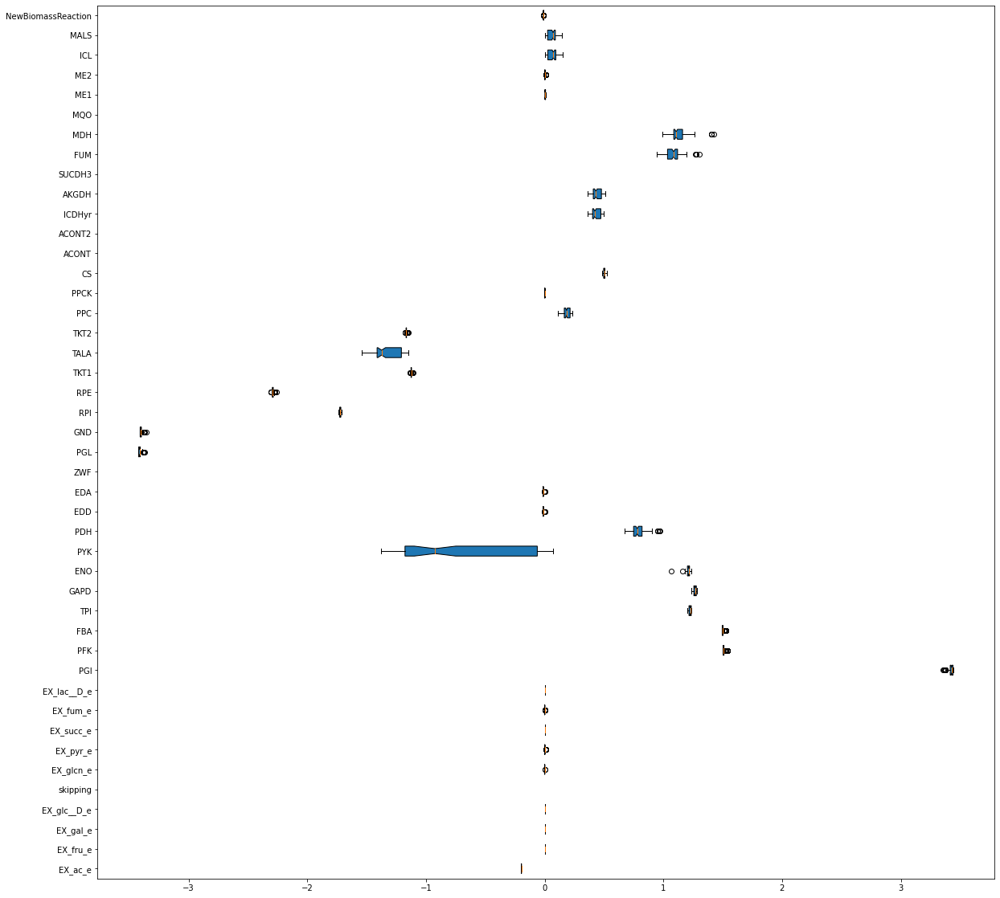

In [409]:
import matplotlib.pyplot as plt
import numpy as np

data = []
labels = []
for x in DictForCreatingBoxPlot['Glycerol']:
    labels.append(x)
    data.append(DictForCreatingBoxPlot['Glycerol'][x])


fig = plt.figure(figsize =(20, 20))

ax = fig.add_subplot(111)

#plt.boxplot(data)

bp = ax.boxplot(data, patch_artist = True,
                notch ='True', vert = 0)

ax.set_yticklabels(labels)

plt.show()

In [271]:
import reframed
import math
from cobra.sampling import sample

In [272]:
def round_up(n, decimals=0):
    multiplier = 10 ** decimals
    return math.ceil(n * multiplier) / multiplier

def round_down(n, decimals=0):
    multiplier = 10 ** decimals
    return math.floor(n * multiplier) / multiplier

In [231]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.29)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmphjfxmd7w.lp
Reading time = 0.04 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
148.68208796449494
78.53924943587114
1063.2653795812162
73.2783609482737
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.07853924943587114 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.0732783609482737 BM_Lipid + 1.0632653795812161 BM_Protein + 0.14868208796449495 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [232]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -20

In [233]:
rf_model = reframed.from_cobrapy(NewModel)

model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_ac_e')
OtherUptakeReaction.lower_bound = -20

rf_model2 = reframed.from_cobrapy(model)

In [234]:
solu = reframed.MOMA(rf_model, reference={'EX_ac_e': -13.58, 'NewBiomassReaction': 0.29})
solu2 = reframed.MOMA(rf_model2, reference={'EX_ac_e': -13.58, 'BIOMASS_Ec_iML1515_core_75p37M': 0.29})

In [235]:
solu.values['NewBiomassReaction']

0.25222149950603323

In [236]:
UptakeValue = solu.values['EX_ac_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_ac_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [237]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelAcetate.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelAcetate.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [161]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpl15d1g2n.lp
Reading time = 0.03 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.0,0.0,0.0,0.0,2.151632e-07,0.0,6.909776e-08,-0.000001,-0.000001,-0.000001,...,0.000085,0.0,0.037171,0.019635,0.265816,0.01832,0.015537,0.000863,0.002456,0.250000
1,0.0,0.0,0.0,0.0,5.391828e-08,0.0,1.807430e-06,-0.000266,-0.000266,-0.000030,...,0.000085,0.0,0.037171,0.019635,0.265819,0.01832,0.015537,0.000863,0.002456,0.250003
2,0.0,0.0,0.0,0.0,7.705427e-08,0.0,3.325151e-06,-0.000213,-0.000213,-0.000031,...,0.000085,0.0,0.037171,0.019635,0.265819,0.01832,0.015537,0.000863,0.002456,0.250003
3,0.0,0.0,0.0,0.0,6.024666e-08,0.0,3.248136e-06,-0.000314,-0.000314,-0.000097,...,0.000085,0.0,0.037171,0.019635,0.265816,0.01832,0.015537,0.000863,0.002456,0.250000
4,0.0,0.0,0.0,0.0,9.092160e-07,0.0,3.234365e-06,-0.000189,-0.000189,-0.000077,...,0.000085,0.0,0.037171,0.019635,0.265816,0.01832,0.015537,0.000863,0.002456,0.250000


In [162]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpty0xd4b9.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.0,0.0,0.0,0.0,0.0,0.0,5.355243e-08,-0.000005,-0.000005,-0.000006,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000166,0.000265,0.0,0.000099
1,0.0,0.0,0.0,0.0,0.0,0.0,8.313272e-07,-0.000005,-0.000005,-0.000006,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000161,0.000260,0.0,0.000099
2,0.0,0.0,0.0,0.0,0.0,0.0,4.168007e-06,-0.000024,-0.000024,-0.000027,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000839,0.000938,0.0,0.000099
3,0.0,0.0,0.0,0.0,0.0,0.0,4.162835e-06,-0.000469,-0.000469,-0.000027,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000838,0.000937,0.0,0.000099
4,0.0,0.0,0.0,0.0,0.0,0.0,1.536945e-05,-0.000465,-0.000465,-0.000346,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000819,0.000918,0.0,0.000099


In [163]:
s.to_csv('NewBiomassAcetateStuff.csv')

In [164]:
s1.to_csv('OldBiomassAcetateStuff.csv')

In [254]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.49)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp1_5udtgg.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
119.57600386907967
40.79069958654323
802.8227343808553
81.22856931769306
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.04079069958654322 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08122856931769305 BM_Lipid + 0.8028227343808553 BM_Protein + 0.11957600386907967 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [255]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_fru_e')
OtherUptakeReaction.lower_bound = -20

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model = reframed.from_cobrapy(NewModel)

In [256]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_fru_e')
OtherUptakeReaction.lower_bound = -20
OtherUptakeReaction.upper_bound = -0.001

model.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model2 = reframed.from_cobrapy(model)

Metabolite,Reaction,Flux,C-Number,C-Flux
ca2_e,EX_ca2_e,0.009264,0,0.00%
cl_e,EX_cl_e,0.009264,0,0.00%
cobalt2_e,EX_cobalt2_e,4.449E-05,0,0.00%
cu2_e,EX_cu2_e,0.001262,0,0.00%
fe2_e,EX_fe2_e,0.02859,0,0.00%
fru_e,EX_fru_e,20,6,100.00%
k_e,EX_k_e,0.3474,0,0.00%
mg2_e,EX_mg2_e,0.01544,0,0.00%
mn2_e,EX_mn2_e,0.00123,0,0.00%
mobd_e,EX_mobd_e,1.246E-05,0,0.00%


In [257]:
solu = reframed.MOMA(rf_model, reference={'EX_fru_e': -8.33, 'NewBiomassReaction': 0.49, 'EX_ac_e': 3.33})
solu2 = reframed.MOMA(rf_model2, reference={'EX_fru_e': -8.33, 'BIOMASS_Ec_iML1515_core_75p37M': 0.49, 'EX_ac_e': 3.33})

In [258]:
solu2.values

{'12DGR120tipp': 4.761863688431608e-12,
 '12DGR140tipp': 4.327757313129973e-12,
 '12DGR141tipp': 4.575074865547965e-12,
 '12DGR160tipp': 5.040535506871049e-12,
 '12DGR161tipp': 5.04985132859839e-12,
 '12DGR180tipp': 4.400833428215593e-12,
 '12DGR181tipp': 4.4095093351831486e-12,
 '12PPDRtex': -4.912022499631609e-13,
 '12PPDRtpp': -4.912022499631609e-13,
 '12PPDStex': -2.2737367544323206e-13,
 '12PPDStpp': -2.2737367544323206e-13,
 '13PPDH2': 0.0,
 '14GLUCANabcpp': 0.0,
 '14GLUCANtexi': 0.0,
 '23CAMPtex': -0.0,
 '23CCMPtex': -0.0,
 '23CGMPtex': -0.0,
 '23CUMPtex': -0.0,
 '23DAPPAt2pp': 0.0,
 '23DAPPAtex': -0.0,
 '23DOGULNt4pp': 0.0,
 '23PDE2pp': 0.0,
 '23PDE4pp': 0.0,
 '23PDE7pp': 0.0,
 '23PDE9pp': 0.0,
 '26DAHtex': -0.0,
 '2AGPA120tipp': 1.1277392991069697e-12,
 '2AGPA140tipp': 1.4184169085236913e-12,
 '2AGPA141tipp': 1.256808325998164e-12,
 '2AGPA160tipp': 6.929189008908807e-13,
 '2AGPA161tipp': 6.929358723121723e-13,
 '2AGPA180tipp': 1.3794314816983995e-12,
 '2AGPA181tipp': 1.3799441

In [259]:
UptakeValue = solu.values['EX_fru_e']
OtherUptakeValue = solu.values['EX_ac_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_fru_e']
OldOtherUptakeValue = solu2.values['EX_ac_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [260]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OtherUptakeValue, 2)

NewModel.reactions.get_by_id('EX_fru_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_fru_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldOtherUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldOtherUptakeValue, 2)

model.reactions.get_by_id('EX_fru_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_fru_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

In [261]:
write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelFructose.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelFructose.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [ ]:
#model.summary()

In [91]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp4qd4wmtw.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.250104,0.000278,0.189480,0.000229,0.000230,0.000229,0.000230,-0.000031,-0.000031,-0.000015,...,0.000215,0.0,0.075334,0.025698,0.505783,0.051174,0.039154,0.002175,0.006190,0.630006
1,0.021724,0.000327,0.188822,0.000376,0.000229,0.000228,0.000230,-0.000031,-0.000031,-0.000015,...,0.000215,0.0,0.075371,0.025711,0.506034,0.051200,0.039174,0.002176,0.006193,0.630319
2,0.021688,0.000326,0.155760,0.000376,0.000229,0.000228,0.000120,-0.000031,-0.000031,-0.000015,...,0.000215,0.0,0.075371,0.025711,0.506034,0.051200,0.039174,0.002176,0.006193,0.630319
3,0.021387,0.000325,0.155127,0.000374,0.000228,0.000256,0.000143,-0.000031,-0.000031,-0.000015,...,0.000215,0.0,0.075356,0.025706,0.505930,0.051189,0.039166,0.002176,0.006192,0.630189
4,0.020722,0.000323,0.135255,0.000371,0.000226,0.000254,0.000142,-0.000031,-0.000031,-0.000039,...,0.000215,0.0,0.075356,0.025706,0.505931,0.051189,0.039166,0.002176,0.006192,0.630190


In [92]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpiydz6yga.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.0,0.0,0.0,0.0,1.728503e-11,0.0,1.015404e-07,-0.000009,-0.000009,-3.009424e-10,...,0.0,0.0,0.0,0.0,0.0,0.0,0.009801,0.010023,0.0,0.000222
1,0.0,0.0,0.0,0.0,2.777360e-08,0.0,1.151194e-07,-0.000009,-0.000009,-1.800568e-07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.010104,0.010326,0.0,0.000222
2,0.0,0.0,0.0,0.0,4.171445e-07,0.0,1.722004e-06,-0.000079,-0.000079,-6.329756e-06,...,0.0,0.0,0.0,0.0,0.0,0.0,0.061247,0.061468,0.0,0.000222
3,0.0,0.0,0.0,0.0,1.083207e-06,0.0,1.789104e-06,-0.000082,-0.000082,-6.578647e-06,...,0.0,0.0,0.0,0.0,0.0,0.0,0.063578,0.063800,0.0,0.000222
4,0.0,0.0,0.0,0.0,2.326360e-06,0.0,4.650044e-06,-0.000081,-0.000081,-4.051623e-05,...,0.0,0.0,0.0,0.0,0.0,0.0,0.002543,0.002765,0.0,0.000222


In [93]:
s.to_csv('NewBiomassFructoseStuff.csv')

In [94]:
s1.to_csv('OldBiomassFructoseStuff.csv')

In [4]:
import reframed

In [238]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.18)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpdvl00ank.lp
Reading time = 0.04 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
234.5102673379291
209.46110712178884
1619.3314088278348
69.24247217305046
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.20946110712178884 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.06924247217305046 BM_Lipid + 1.6193314088278348 BM_Protein + 0.2345102673379291 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [239]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_gal_e')
OtherUptakeReaction.lower_bound = -2
OtherUptakeReaction.upper_bound = -0.001
#NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model = reframed.from_cobrapy(NewModel)

In [240]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_gal_e')
OtherUptakeReaction.lower_bound = -2
OtherUptakeReaction.upper_bound = -0.001
#model.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model2 = reframed.from_cobrapy(model)

In [8]:
NewModel.optimize()

,fluxes,reduced_costs
12DGR120tipp,0.000000,0.000000e+00
12DGR140tipp,0.000000,0.000000e+00
12DGR141tipp,0.000000,0.000000e+00
12DGR160tipp,0.000000,0.000000e+00
12DGR161tipp,0.000000,-5.572460e-03
...,...,...
LipidIntoBiomassReaction,0.006272,0.000000e+00
CellWallIntoBiomassReaction,0.005630,0.000000e+00
CofactorIntoBiomassReaction,0.000313,-1.665335e-16
InorganicIntoBiomassReaction,0.000890,0.000000e+00


In [241]:
reframed.FBA(rf_model)

Objective: 0.09058591245373432
Status: Optimal

In [242]:
solu = reframed.MOMA(rf_model, reference={'EX_gal_e': -1.97, 'NewBiomassReaction': 0.18})
solu2 = reframed.MOMA(rf_model2, reference={'EX_gal_e': -1.97, 'BIOMASS_Ec_iML1515_core_75p37M': 0.18})

In [243]:
print(solu.values)

None


In [99]:
UptakeValue = solu.values['EX_gal_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_gal_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

TypeError: 'NoneType' object is not subscriptable

In [ ]:
NewModel.reactions.get_by_id('EX_gal_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_gal_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_gal_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_gal_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

In [ ]:
s = sample(NewModel, 100)
s.head()

In [ ]:
s1 = sample(model, 100)
s1.head()

In [ ]:
s.to_excel('NewBiomassGalactoseStuff.xlsx')

In [ ]:
s1.to_excel('OldBiomassGalactoseStuff.xlsx')

In [262]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.65)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpx2mswlxx.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
131.96590545205677
32.285670806164674
726.2183037848025
88.20541546869333
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.03228567080616467 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08820541546869333 BM_Lipid + 0.7262183037848026 BM_Protein + 0.13196590545205678 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [263]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = -20

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model = reframed.from_cobrapy(NewModel)

In [264]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = -20

model.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model2 = reframed.from_cobrapy(model)

In [265]:
solu = reframed.MOMA(rf_model, reference={'EX_glc__D_e': -9.65, 'NewBiomassReaction': 0.65, 'EX_ac_e': 6.83})
solu2 = reframed.MOMA(rf_model2, reference={'EX_glc__D_e': -9.65, 'BIOMASS_Ec_iML1515_core_75p37M': 0.65, 'EX_ac_e': 6.83})

In [266]:
UptakeValue = solu.values['EX_glc__D_e']
OtherUptakeValue = solu.values['EX_ac_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_glc__D_e']
OldOtherUptakeValue = solu2.values['EX_ac_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [267]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OtherUptakeValue, 2)

NewModel.reactions.get_by_id('EX_glc__D_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldOtherUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldOtherUptakeValue, 2)

model.reactions.get_by_id('EX_glc__D_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_glc__D_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

In [268]:
write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelGlucose.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelGlucose.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [208]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp95c0ealc.lp
Reading time = 0.03 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.001237,0.004965,0.001114,0.001010,0.001241,0.001009,0.001016,-0.000205,-0.000205,-0.000068,...,0.000239,0.0,0.092381,0.022601,0.508377,0.061747,0.043506,0.002417,0.006878,0.700034
1,0.001235,0.004960,0.000944,0.001008,0.001239,0.001008,0.001015,-0.000652,-0.000652,-0.000286,...,0.000239,0.0,0.092381,0.022601,0.508381,0.061747,0.043507,0.002417,0.006878,0.700038
2,0.003618,0.004953,0.000943,0.001007,0.001238,0.001006,0.002295,-0.000652,-0.000652,-0.000459,...,0.000239,0.0,0.092380,0.022601,0.508373,0.061746,0.043506,0.002417,0.006878,0.700027
3,0.004469,0.004025,0.003142,0.001306,0.001233,0.000206,0.002173,-0.000218,-0.000218,-0.000458,...,0.000239,0.0,0.092378,0.022600,0.508365,0.061745,0.043505,0.002417,0.006878,0.700016
4,0.004465,0.006361,0.003139,0.001305,0.001232,0.000207,0.001781,-0.000218,-0.000218,-0.000458,...,0.000239,0.0,0.092378,0.022600,0.508365,0.061745,0.043505,0.002417,0.006878,0.700016


In [209]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpsyy7xrvy.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.0,0.0,0.0,0.0,3.899998e-08,0.0,3.646961e-08,-7.280886e-07,-7.280886e-07,-3.613071e-07,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000024,0.000263,0.0,0.000239
1,0.0,0.0,0.0,0.0,1.956097e-07,0.0,1.194835e-08,-7.190669e-07,-7.190669e-07,-7.052061e-08,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000243,0.000481,0.0,0.000239
2,0.0,0.0,0.0,0.0,9.096842e-06,0.0,8.506487e-06,-1.698252e-04,-1.698252e-04,-6.123933e-02,...,0.0,0.0,0.0,0.0,0.0,0.0,0.005643,0.005882,0.0,0.000239
3,0.0,0.0,0.0,0.0,1.201051e-05,0.0,5.534881e-06,-9.878202e-05,-9.878202e-05,-1.778044e-02,...,0.0,0.0,0.0,0.0,0.0,0.0,0.005624,0.005863,0.0,0.000239
4,0.0,0.0,0.0,0.0,1.122135e-05,0.0,6.917176e-06,-6.223044e-05,-6.223044e-05,-1.775772e-02,...,0.0,0.0,0.0,0.0,0.0,0.0,0.005619,0.005858,0.0,0.000239


In [210]:
s.to_csv('NewBiomassGlucoseStuff.csv')

In [211]:
s1.to_csv('OldBiomassGlucoseStuff.csv')

In [269]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.49)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpc9s4xef2.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
119.57600386907967
40.79069958654323
802.8227343808553
81.22856931769306
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.04079069958654322 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08122856931769305 BM_Lipid + 0.8028227343808553 BM_Protein + 0.11957600386907967 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [270]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_glyc_e')
OtherUptakeReaction.lower_bound = -20
OtherUptakeReaction.upper_bound = -0.01

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model = reframed.from_cobrapy(NewModel)

In [271]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_glyc_e')
OtherUptakeReaction.lower_bound = -20
OtherUptakeReaction.upper_bound = -0.9

model.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model2 = reframed.from_cobrapy(model)

In [272]:
solu = reframed.MOMA(rf_model, reference={'EX_glyc_e': -10.14, 'NewBiomassReaction': 0.49, 'EX_ac_e': 0.60})
solu2 = reframed.MOMA(rf_model2, reference={'EX_glyc_e': -10.14, 'BIOMASS_Ec_iML1515_core_75p37M': 0.49, 'EX_ac_e': 0.60})

In [273]:
UptakeValue = solu.values['EX_glyc_e']
OtherUptakeValue = solu.values['EX_ac_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_glyc_e']
OldOtherUptakeValue = solu2.values['EX_ac_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [274]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OtherUptakeValue, 2)

NewModel.reactions.get_by_id('EX_glyc_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_glyc_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldOtherUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldOtherUptakeValue, 2)

model.reactions.get_by_id('EX_glyc_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_glyc_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

In [275]:
write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelGlycerol.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelGlycerol.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [124]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmplw85q5tp.lp
Reading time = 0.02 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.0,0.0,0.0,0.0,0.000010,0.0,0.000002,-0.000144,-0.000144,0.0,...,0.000164,0.0,0.057396,0.01958,0.385355,0.03899,0.029832,0.001657,0.004716,0.48
1,0.0,0.0,0.0,0.0,0.000010,0.0,0.000005,-0.000105,-0.000105,0.0,...,0.000164,0.0,0.057396,0.01958,0.385355,0.03899,0.029832,0.001657,0.004716,0.48
2,0.0,0.0,0.0,0.0,0.000012,0.0,0.000004,-0.000098,-0.000098,0.0,...,0.000164,0.0,0.057396,0.01958,0.385355,0.03899,0.029832,0.001657,0.004716,0.48
3,0.0,0.0,0.0,0.0,0.000012,0.0,0.000005,-0.000088,-0.000088,0.0,...,0.000164,0.0,0.057396,0.01958,0.385355,0.03899,0.029832,0.001657,0.004716,0.48
4,0.0,0.0,0.0,0.0,0.000013,0.0,0.000008,-0.000064,-0.000064,0.0,...,0.000164,0.0,0.057396,0.01958,0.385355,0.03899,0.029832,0.001657,0.004716,0.48


In [125]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpomj24r8p.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.0,0.0,0.0,0.0,0.0,0.0,2.964753e-07,-0.000003,-0.000003,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000883,0.001050,0.0,0.000167
1,0.0,0.0,0.0,0.0,0.0,0.0,2.845109e-07,-0.000003,-0.000003,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000177,0.000344,0.0,0.000167
2,0.0,0.0,0.0,0.0,0.0,0.0,1.983165e-07,-0.000003,-0.000003,-0.000003,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000177,0.000344,0.0,0.000167
3,0.0,0.0,0.0,0.0,0.0,0.0,1.986809e-07,-0.000003,-0.000003,-0.000427,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000177,0.000344,0.0,0.000167
4,0.0,0.0,0.0,0.0,0.0,0.0,1.782545e-07,-0.000016,-0.000016,-0.001318,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000157,0.000324,0.0,0.000167


In [ ]:
s.to_csv('NewBiomassGlycerolStuff.csv')

In [ ]:
s1.to_csv('OldBiomassGlycerolStuff.csv')

In [276]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.59)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpogq3hmdc.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
126.03723871690505
34.72457158502773
749.2576779913157
85.52150456432896
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.03472457158502773 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08552150456432897 BM_Lipid + 0.7492576779913157 BM_Protein + 0.12603723871690506 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [277]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_glcn_e')
OtherUptakeReaction.lower_bound = -20

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model = reframed.from_cobrapy(NewModel)

In [282]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_glcn_e')
OtherUptakeReaction.lower_bound = -50
model.reactions.get_by_id('EX_ac_e').upper_bound = 20

rf_model2 = reframed.from_cobrapy(model)

In [283]:
solu = reframed.MOMA(rf_model, reference={'EX_glcn_e': -7.28, 'NewBiomassReaction': 0.59, 'EX_ac_e': 5.00})
solu2 = reframed.MOMA(rf_model2, reference={'EX_glcn_e': -7.28, 'BIOMASS_Ec_iML1515_core_75p37M': 0.59, 'EX_ac_e': 5.00})

In [284]:
UptakeValue = solu.values['EX_glcn_e']
OtherUptakeValue = solu.values['EX_ac_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_glcn_e']
OldOtherUptakeValue = solu2.values['EX_ac_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [288]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OtherUptakeValue, 2)

NewModel.reactions.get_by_id('EX_glcn_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_glcn_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldOtherUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldOtherUptakeValue, 2)

model.reactions.get_by_id('EX_glcn_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_glcn_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)


write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelGluconate.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelGluconate.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [286]:
s = sample(NewModel, 100)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpnx58ylgx.lp
Reading time = 0.03 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


KeyboardInterrupt: 

In [ ]:
#s1 = sample(model, 100)
#s1.head()

In [134]:
s.to_excel('NewBiomassGluconateStuff.xlsx')

In [ ]:
#s1.to_excel('OldBiomassGluconateStuff.xlsx')

In [289]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.39)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpn2nlkvk6.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
122.78066671648499
52.04094181585457
891.2238913473865
77.15112715815488
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.05204094181585457 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.07715112715815488 BM_Lipid + 0.8912238913473864 BM_Protein + 0.12278066671648499 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [290]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_pyr_e')
OtherUptakeReaction.lower_bound = -40

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 1000

NewModel.reactions.get_by_id('EX_lac__D_e').upper_bound = 1000

rf_model = reframed.from_cobrapy(NewModel)

In [291]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_pyr_e')
OtherUptakeReaction.lower_bound = -50

model.reactions.get_by_id('EX_ac_e').upper_bound = 1000

model.reactions.get_by_id('EX_lac__D_e').upper_bound = 1000

rf_model2 = reframed.from_cobrapy(model)

In [262]:
reframed.FBA(rf_model2)

Objective: 1.6722389546557976
Status: Optimal

In [292]:
solu = reframed.MOMA(rf_model, reference={'EX_pyr_e': -26.71, 'NewBiomassReaction': 0.39, 'EX_ac_e': 11.91, 'EX_lac__D_e': 1.16})
solu2 = reframed.MOMA(rf_model2, reference={'EX_pyr_e': -26.71, 'BIOMASS_Ec_iML1515_core_75p37M': 0.39, 'EX_ac_e': 11.91, 'EX_lac__D_e': 1.16})

In [298]:
solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

0.5551518392404887

In [299]:
UptakeValue = solu.values['EX_pyr_e']
OtherUptakeValue = solu.values['EX_ac_e']
OtherOtherUptakeValue = solu.values['EX_lac__D_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_pyr_e']
OldOtherUptakeValue = solu2.values['EX_ac_e']
OldOtherOtherUptakeValue = solu2.values['EX_lac__D_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [301]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OtherUptakeValue, 2)

NewModel.reactions.get_by_id('EX_pyr_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_pyr_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('EX_lac__D_e').upper_bound = round_up(OtherOtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_lac__D_e').lower_bound = round_down(OtherOtherUptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldOtherUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldOtherUptakeValue, 2)

model.reactions.get_by_id('EX_pyr_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_pyr_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('EX_lac__D_e').upper_bound = round_up(OldOtherOtherUptakeValue, 2)
model.reactions.get_by_id('EX_lac__D_e').lower_bound = round_down(OldOtherOtherUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelPyruvate.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelPyruvate.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [279]:
NewModel.summary()

Metabolite,Reaction,Flux,C-Number,C-Flux
ca2_e,EX_ca2_e,0.002671,0,0.00%
cl_e,EX_cl_e,0.002671,0,0.00%
cobalt2_e,EX_cobalt2_e,1.283E-05,0,0.00%
cu2_e,EX_cu2_e,0.0003639,0,0.00%
fe2_e,EX_fe2_e,0.008243,0,0.00%
h_e,EX_h_e,8.431,0,0.00%
k_e,EX_k_e,0.1002,0,0.00%
mg2_e,EX_mg2_e,0.004452,0,0.00%
mn2_e,EX_mn2_e,0.0003546,0,0.00%
mobd_e,EX_mobd_e,3.593E-06,0,0.00%


In [ ]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp6mbw4het.lp
Reading time = 0.34 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


In [269]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpsq86whhz.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


KeyboardInterrupt: 

In [ ]:
s.to_csv('NewBiomassPyruvateStuff.csv')

In [ ]:
s1.to_csv('OldBiomassPyruvateStuff.csv')

In [302]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.51)

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpi7jiw0u5.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
120.35090035881117
39.29909475783802
790.0983518624626
82.06956089681691
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.03929909475783802 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.08206956089681691 BM_Lipid + 0.7900983518624626 BM_Protein + 0.12035090035881117 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [303]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_succ_e')
OtherUptakeReaction.lower_bound = -20

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

NewModel.reactions.get_by_id('EX_fum_e').upper_bound = 20

rf_model = reframed.from_cobrapy(NewModel)

In [304]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_succ_e')
OtherUptakeReaction.lower_bound = -30

model.reactions.get_by_id('EX_ac_e').upper_bound = 20

model.reactions.get_by_id('EX_fum_e').upper_bound = 20

rf_model2 = reframed.from_cobrapy(model)

In [305]:
solu = reframed.MOMA(rf_model, reference={'EX_succ_e': -15.9, 'NewBiomassReaction': 0.51, 'EX_ac_e': 3.32, 'EX_fum_e': 1.14})
solu2 = reframed.MOMA(rf_model2, reference={'EX_succ_e': -15.9, 'BIOMASS_Ec_iML1515_core_75p37M': 0.51, 'EX_ac_e': 3.32, 'EX_fum_e': 1.14})

In [306]:
UptakeValue = solu.values['EX_succ_e']
OtherUptakeValue = solu.values['EX_ac_e']
OtherOtherUptakeValue = solu.values['EX_fum_e']
GrowthValue = solu.values['NewBiomassReaction']

OldUptakeValue = solu2.values['EX_succ_e']
OldOtherUptakeValue = solu2.values['EX_ac_e']
OldOtherOtherUptakeValue = solu2.values['EX_fum_e']
OldGrowthValue = solu2.values['BIOMASS_Ec_iML1515_core_75p37M']

In [307]:
NewModel.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OtherUptakeValue, 2)

NewModel.reactions.get_by_id('EX_succ_e').upper_bound = round_up(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_succ_e').lower_bound = round_down(UptakeValue, 2)

NewModel.reactions.get_by_id('EX_fum_e').upper_bound = round_up(OtherOtherUptakeValue, 2)
NewModel.reactions.get_by_id('EX_fum_e').lower_bound = round_down(OtherOtherUptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_ac_e').upper_bound = round_up(OldOtherUptakeValue, 2)
model.reactions.get_by_id('EX_ac_e').lower_bound = round_down(OldOtherUptakeValue, 2)

model.reactions.get_by_id('EX_succ_e').upper_bound = round_up(OldUptakeValue, 2)
model.reactions.get_by_id('EX_succ_e').lower_bound = round_down(OldUptakeValue, 2)

model.reactions.get_by_id('EX_fum_e').upper_bound = round_up(OldOtherOtherUptakeValue, 2)
model.reactions.get_by_id('EX_fum_e').lower_bound = round_down(OldOtherOtherUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelSuccinate.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelSuccinate.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [194]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpatibm_ao.lp
Reading time = 0.03 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.0,0.0,0.0,0.0,4.948183e-08,0.0,1.635416e-08,-0.000034,-0.000034,-5.754148e-07,...,0.000219,0.0,0.077227,0.025217,0.506989,0.052662,0.039880,0.002215,0.006305,0.641679
1,0.0,0.0,0.0,0.0,1.719841e-05,0.0,1.641317e-08,-0.000056,-0.000056,-5.774912e-07,...,0.000219,0.0,0.077216,0.025214,0.506918,0.052655,0.039874,0.002215,0.006304,0.641588
2,0.0,0.0,0.0,0.0,1.895114e-05,0.0,1.620450e-08,-0.000043,-0.000043,-5.701491e-07,...,0.000219,0.0,0.077214,0.025213,0.506906,0.052654,0.039873,0.002215,0.006304,0.641574
3,0.0,0.0,0.0,0.0,1.071306e-05,0.0,3.442430e-06,-0.000247,-0.000247,-1.212855e-04,...,0.000218,0.0,0.077047,0.025159,0.505810,0.052540,0.039787,0.002210,0.006290,0.640186
4,0.0,0.0,0.0,0.0,2.479354e-07,0.0,3.529791e-06,-0.000257,-0.000257,-3.023054e-04,...,0.000218,0.0,0.077062,0.025164,0.505909,0.052550,0.039795,0.002211,0.006291,0.640311


In [195]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpp16jnwrp.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.000802,0.000315,0.000315,0.000487,0.000317,0.000315,0.000788,-0.000238,-0.000238,-0.000044,...,0.0,0.0,0.0,0.0,0.0,0.000291,0.003397,0.003341,0.000566,0.000218
1,0.000789,0.000310,0.000310,0.000480,0.000310,0.000310,0.000775,-0.000235,-0.000235,-0.000043,...,0.0,0.0,0.0,0.0,0.0,0.000285,0.003343,0.003290,0.000557,0.000218
2,0.000791,0.004044,0.000310,0.000481,0.000322,0.000310,0.000778,-0.001269,-0.001269,-0.000043,...,0.0,0.0,0.0,0.0,0.0,0.000633,0.000842,0.001135,0.000559,0.000218
3,0.000365,0.004042,0.000310,0.004658,0.000322,0.000130,0.000778,-0.001268,-0.001268,-0.000043,...,0.0,0.0,0.0,0.0,0.0,0.000632,0.000834,0.001127,0.000557,0.000218
4,0.000364,0.004038,0.000309,0.003838,0.000321,0.000481,0.000048,-0.001267,-0.001267,-0.000043,...,0.0,0.0,0.0,0.0,0.0,0.000631,0.000832,0.001125,0.000556,0.000218


In [196]:
s.to_csv('NewBiomassSuccinateStuff.csv')

In [197]:
s1.to_csv('OldBiomassSuccinateStuff.csv')

In [22]:
import numpy as np
import math
import pandas as pd

In [23]:
def RMSE(Predicted, Actual):
    MSE = 0
    for x in Predicted:
        MSE += np.square(np.subtract(x, Actual))
    MSE = MSE/len(Predicted)
    RMSE = math.sqrt(MSE)
    return RMSE

In [24]:
def fRMSE(Predicted, Actual):
    RMSE = 0
    RMSE = np.square(np.subtract(Predicted, Actual))
    RMSE = math.sqrt(RMSE)
    return RMSE

In [34]:
print(fRMSE(3,2))

1.0


In [29]:
print(NAcetateDF['NewBiomassReaction'])

0     0.250002
1     0.250007
2     0.250001
3     0.250003
4     0.250008
        ...   
95    0.250006
96    0.250001
97    0.250004
98    0.250023
99    0.250034
Name: NewBiomassReaction, Length: 100, dtype: float64


In [55]:
df = pd.DataFrame.from_dict(CorrectValuesDF)
print(df)

      FluxNames  Acetate  Fructose  Galactose  Glucose  Glycerol  Gluconate  \
0       EX_ac_e -13.5840   -3.3287     0.0000  -6.8270    0.5970    -5.0040   
1      EX_fru_e   0.0000    8.3280     0.0000   0.0000    0.0000     0.0000   
2      EX_gal_e   0.0000    0.0000     1.9690   0.0000    0.0000     0.0000   
3   EX_glc__D_e   0.0000    0.0000     0.0000   9.6540    0.0000     0.0000   
4     EX_glyc_e   0.0000    0.0000     0.0000   0.0000    4.9448     0.0000   
5     EX_glcn_e   0.0000    0.0000     0.0000   0.0000    0.0000     7.2839   
6      EX_pyr_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
7     EX_succ_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
8      EX_fum_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
9   EX_lac__D_e   0.0000    0.0000     0.0000   0.0000    0.0000     0.0000   
10          PGI  -3.4233   -6.1979     1.3685   5.7000   -3.4494    -0.0313   
11          PFK  -1.8862   -2.4610     1.5475   7.05

In [126]:
NAcetateDF = pd.read_excel('NewBiomassAcetateStuff.xlsx')
OAcetateDF = pd.read_excel('OldBiomassAcetateStuff.xlsx')

NGlucoseDF = pd.read_excel('NewBiomassGlucoseStuff.xlsx')
OGlucoseDF = pd.read_excel('OldBiomassGlucoseStuff.xlsx')

NSuccinateDF = pd.read_excel('NewBiomassSuccinateStuff.xlsx')
OSuccinateDF = pd.read_excel('OldBiomassSuccinateStuff.xlsx')

NFructoseDF = pd.read_csv('NewBiomassFructoseStuff.csv')
OFructoseDF = pd.read_csv('OldBiomassFructoseStuff.csv')

In [136]:
NFructoseDF = pd.read_csv('NewBiomassFructoseStuff.csv')
OFructoseDF = pd.read_csv('OldBiomassFructoseStuff.csv')

In [137]:
NewRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {}}
OldRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {}}

In [148]:
print(NSuccinateDF['NewBiomassReaction'])

0     0.640026
1     0.640053
2     0.640027
3     0.640087
4     0.640127
        ...   
95    0.640039
96    0.640053
97    0.640024
98    0.640024
99    0.640024
Name: NewBiomassReaction, Length: 100, dtype: float64


In [138]:
for count, idvar in enumerate(df['FluxNames']):
    TempList, TempListGlucose, TempListSucc, TempListFructose = [], [], [], []
    if idvar == 'GrowthRate':
        idvar = 'NewBiomassReaction'
    
    try:
        for y in NAcetateDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Acetate'])
            TempList.append(RMSE)
        NewRMSEDict['Acetate'][idvar] = TempList
    except:
        print(idvar + ' not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism')
        
    try:
        for y in NGlucoseDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Glucose'])
            TempListGlucose.append(RMSE)
        NewRMSEDict['Glucose'][idvar] = TempListGlucose
    except:
        print(idvar + ' not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism')
        
    try:
        for y in NSuccinateDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Succinate'])
            TempListSucc.append(RMSE)
        NewRMSEDict['Succinate'][idvar] = TempListSucc
    except:
        print(idvar + ' not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism')
        
    try:
        for y in NFructoseDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Fructose'])
            TempListFructose.append(RMSE)
        NewRMSEDict['Fructose'][idvar] = TempListFructose
    except:
        print(idvar + ' not found in the dataframe for Fructose, perhaps it doesnt exist in the metabolism')

ZWF not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism
ZWF not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism
ZWF not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism
ZWF not found in the dataframe for Fructose, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Fructose, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataf

In [140]:
for count, idvar in enumerate(df['FluxNames']):
    TempList, TempListGlucose, TempListSucc, TempListFructose = [], [], [], []
    if idvar == 'GrowthRate':
        idvar = 'BIOMASS_Ec_iML1515_core_75p37M'
    
    try:
        for y in OAcetateDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Acetate'])
            TempList.append(RMSE)
        OldRMSEDict['Acetate'][idvar] = TempList
    except:
        print(idvar + ' not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism')
    
    try:
        for y in OGlucoseDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Glucose'])
            TempListGlucose.append(RMSE)
        OldRMSEDict['Glucose'][idvar] = TempListGlucose
    except:
        print(idvar + ' not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism')
        
    try:
        for y in OSuccinateDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Succinate'])
            TempListSucc.append(RMSE)
        OldRMSEDict['Succinate'][idvar] = TempListSucc
    except:
        print(idvar + ' not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism')
        
    try:
        for y in OFructoseDF[idvar]:
            RMSE = fRMSE(y, df.loc[count, 'Fructose'])
            TempListFructose.append(RMSE)
        OldRMSEDict['Fructose'][idvar] = TempListFructose
    except:
        print(idvar + ' not found in the dataframe for Fructose, perhaps it doesnt exist in the metabolism')
        

ZWF not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism
ZWF not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism
ZWF not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism
ZWF not found in the dataframe for Fructose, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism
ACONT not found in the dataframe for Fructose, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataframe for Acetate, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataframe for Glucose, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataframe for Succinate, perhaps it doesnt exist in the metabolism
ACONT2 not found in the dataf

In [65]:
NewRMSEDict

{'Acetate': {'EX_ac_e': [0.47586920419654,
   0.47596069750228054,
   0.4759088739544506,
   0.4758145618902301,
   0.4757827986404095,
   0.47579569516147124,
   0.4757994656421207,
   0.4757988351117106,
   0.4756511983516205,
   0.4756891938505312,
   0.47570177707364003,
   0.4757021365695895,
   0.47562894236162023,
   0.4756106134721598,
   0.4756300326636911,
   0.4758103185276301,
   0.47581271221419996,
   0.4757722135523501,
   0.4758833613926807,
   0.4758249247160595,
   0.47582762304403126,
   0.47589092468292016,
   0.4758813050682207,
   0.47590628428786097,
   0.47588256634891124,
   0.47577549368006977,
   0.4757107014703603,
   0.4757352820636207,
   0.4756761946254304,
   0.4756441689389703,
   0.47564243681635077,
   0.47588450944884997,
   0.47590977451256045,
   0.475844926291181,
   0.47581254830035036,
   0.475664089059471,
   0.47588133797153986,
   0.47588375419389095,
   0.47585903473026114,
   0.47586279307495083,
   0.4758615429530604,
   0.4758443167050998

In [66]:
OldRMSEDict

{'Acetate': {'EX_ac_e': [0.07599863391627082,
   0.07567111400279103,
   0.07595320707259035,
   0.07596901533479006,
   0.07596475265108005,
   0.07596476211944037,
   0.0759647634858105,
   0.07596469352048096,
   0.0759956278391698,
   0.0759530498140304,
   0.07595224812598111,
   0.07596501368251118,
   0.07596097678785974,
   0.07599769928255995,
   0.07599801536752082,
   0.07599796872329101,
   0.07598773711769091,
   0.07597820230787988,
   0.07597818843037096,
   0.07594304224176085,
   0.075943342497931,
   0.07597481574821074,
   0.07597353848047028,
   0.07598175068994095,
   0.07598176393249112,
   0.07598395040723993,
   0.07596600261441111,
   0.07595093206874104,
   0.07595080319692116,
   0.07592734670853041,
   0.07592783863142039,
   0.07592783937879055,
   0.07592804670903952,
   0.07595429004278031,
   0.07590025031386993,
   0.07591670912541026,
   0.07597113242323061,
   0.07597467621012122,
   0.07597487501153033,
   0.07599508419495038,
   0.07599451733035067,

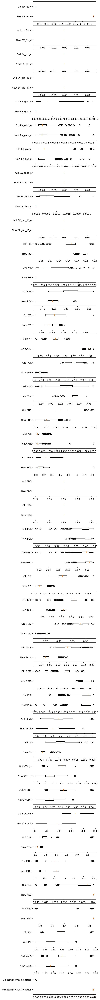

In [68]:
import matplotlib.pyplot as plt
import numpy as np

data = {}
labels = {}
for x in NewRMSEDict['Acetate']:
    TempList1, TempList2 = [], []
#    labels[x] = str('New ')+x
#    data.append(NewRMSEDict['Acetate'][x])
    
    TempList1.append(NewRMSEDict['Acetate'][x])
    TempList2.append('New '+x)
    
    if x == 'NewBiomassReaction':
        x = 'BIOMASS_Ec_iML1515_core_75p37M'
    
    TempList1.append(OldRMSEDict['Acetate'][x])
    
    if x == 'BIOMASS_Ec_iML1515_core_75p37M':
        x = 'NewBiomassReaction'
    TempList2.append('Old '+x)
    
    
    
    data[x] = TempList1
    labels[x] = TempList2

fig, axs = plt.subplots(len(data))


for count, x in enumerate(data):
    axs[count].boxplot(data[x], vert = 0)
    axs[count].set_yticklabels(labels[x])
    
#axs[0].boxplot(data['EX_ac_e'], vert = 0)
#axs[0].set_yticklabels(labels['EX_ac_e'])

#ax = fig.add_subplot(111)

#plt.boxplot(data)

#bp = ax.boxplot(data, patch_artist = True,
#                notch ='True', vert = 0)

#ax.set_yticklabels(labels)
plt.show()

In [67]:
plt.rcParams['figure.figsize'] = (5, 80)
plt.rcParams['figure.dpi'] = 140

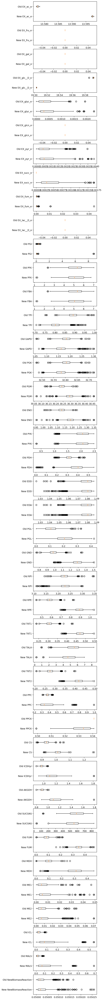

In [69]:
data = {}
labels = {}
for x in NewRMSEDict['Glucose']:
    TempList1, TempList2 = [], []
    
    TempList1.append(NewRMSEDict['Glucose'][x])
    TempList2.append('New '+x)
    
    if x == 'NewBiomassReaction':
        x = 'BIOMASS_Ec_iML1515_core_75p37M'
    
    TempList1.append(OldRMSEDict['Glucose'][x])
    
    if x == 'BIOMASS_Ec_iML1515_core_75p37M':
        x = 'NewBiomassReaction'
    TempList2.append('Old '+x)
    
    
    
    data[x] = TempList1
    labels[x] = TempList2

fig, axs = plt.subplots(len(data))


for count, x in enumerate(data):
    axs[count].boxplot(data[x], vert = 0)
    axs[count].set_yticklabels(labels[x])
    

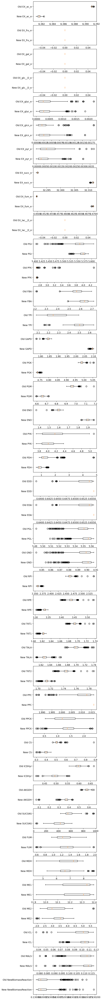

In [70]:
data = {}
labels = {}
for x in NewRMSEDict['Succinate']:
    TempList1, TempList2 = [], []
    
    TempList1.append(NewRMSEDict['Succinate'][x])
    TempList2.append('New '+x)
    
    if x == 'NewBiomassReaction':
        x = 'BIOMASS_Ec_iML1515_core_75p37M'
    
    TempList1.append(OldRMSEDict['Succinate'][x])
    
    if x == 'BIOMASS_Ec_iML1515_core_75p37M':
        x = 'NewBiomassReaction'
    TempList2.append('Old '+x)
    
    
    
    data[x] = TempList1
    labels[x] = TempList2

fig, axs = plt.subplots(len(data))


for count, x in enumerate(data):
    axs[count].boxplot(data[x], vert = 0)
    axs[count].set_yticklabels(labels[x])
    

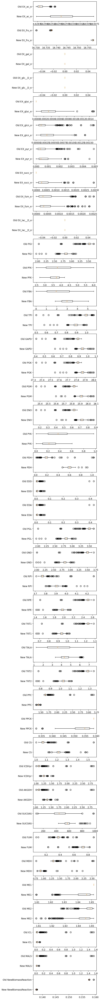

In [142]:
data = {}
labels = {}
for x in NewRMSEDict['Fructose']:
    TempList1, TempList2 = [], []
    
    TempList1.append(NewRMSEDict['Fructose'][x])
    TempList2.append('New '+x)
    
    if x == 'NewBiomassReaction':
        x = 'BIOMASS_Ec_iML1515_core_75p37M'
    
    TempList1.append(OldRMSEDict['Fructose'][x])
    
    if x == 'BIOMASS_Ec_iML1515_core_75p37M':
        x = 'NewBiomassReaction'
    TempList2.append('Old '+x)
    
    
    
    data[x] = TempList1
    labels[x] = TempList2

fig, axs = plt.subplots(len(data))


for count, x in enumerate(data):
    axs[count].boxplot(data[x], vert = 0)
    axs[count].set_yticklabels(labels[x])

In [141]:
print(OldRMSEDict['Fructose'])

{'EX_ac_e': [6.628721251881645, 6.6287270399193154, 6.628898067261861, 6.628905657746815, 6.6287271492605235, 6.628727275983913, 6.628744862052091, 6.628745475303928, 6.62876621283061, 6.628700038649728, 6.628758927579812, 6.628761126600402, 6.6287678962851775, 6.628761750310124, 6.628823118783982, 6.6288670677976445, 6.628894130512267, 6.6288295565455275, 6.628894271197993, 6.628893134281288, 6.628882348932828, 6.628959499133497, 6.628964206061751, 6.628930010947936, 6.628825781033324, 6.628791878224701, 6.628786609318025, 6.628791325379678, 6.628790630257084, 6.628791915987238, 6.6287234741412435, 6.6287218644453905, 6.628754953286483, 6.6287267307941935, 6.628785204775104, 6.628935215893636, 6.628939086282424, 6.628915787529442, 6.628890796083777, 6.62888768542439, 6.628886385702742, 6.629087565870784, 6.629087221211974, 6.629024084587492, 6.629045562449757, 6.629040214683938, 6.629044472118059, 6.629045762862535, 6.62897372155077, 6.629064066700648, 6.629064665890544, 6.62906493504

In [139]:
print(NewRMSEDict['Fructose'])

{'EX_ac_e': [6.628712522175388, 6.628710689822232, 6.628712231181373, 6.62870944176492, 6.628710054951577, 6.628712404253452, 6.628712865633068, 6.628759488706082, 6.62875945890465, 6.628757985420776, 6.628758033909614, 6.628758110361208, 6.628778024384873, 6.62877565808125, 6.628855981363017, 6.6288764197852155, 6.628888484102742, 6.628859673453485, 6.628842940664859, 6.628883711405784, 6.6288804921124385, 6.628878862196924, 6.628867397536283, 6.62886911797724, 6.628925176713044, 6.628985672609481, 6.629023658210054, 6.6290221307792585, 6.629060726390266, 6.62907982139143, 6.628934212427646, 6.628939155776353, 6.6289402013977305, 6.628939699641405, 6.62894006671077, 6.62889278443359, 6.6289015880520195, 6.628915875796547, 6.628959868552318, 6.628959150936673, 6.628963320612867, 6.62895542307058, 6.62896311141311, 6.628963408061597, 6.628950065160574, 6.628973872121062, 6.628936521076622, 6.628916382738661, 6.6289155441542995, 6.628898566907365, 6.628898783009187, 6.628951712690309, 6.

In [103]:
import reframed

In [237]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.18)


Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp0as1s5b2.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
234.5102673379291
209.46110712178884
1619.3314088278348
69.24247217305046
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.20946110712178884 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.06924247217305046 BM_Lipid + 1.6193314088278348 BM_Protein + 0.2345102673379291 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [79]:
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = NewModel.reactions.get_by_id('EX_glc__D_e')
#UptakeReaction.lower_bound = 0

OtherUptakeReaction = NewModel.reactions.get_by_id('EX_gal_e')
#OtherUptakeReaction.lower_bound = -2
#NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 20

write_sbml_model(NewModel, "NewModelGalactose.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [80]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'
model.objective = 'BIOMASS_Ec_iML1515_core_75p37M'

BMReaction = model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

UptakeReaction = model.reactions.get_by_id('EX_glc__D_e')
UptakeReaction.lower_bound = 0

OtherUptakeReaction = model.reactions.get_by_id('EX_gal_e')
OtherUptakeReaction.lower_bound = -2
#model.reactions.get_by_id('EX_ac_e').upper_bound = 20

write_sbml_model(model, "OldModelGalactose.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [131]:
#rfmodel = reframed.load_cbmodel("NewModelGalactose.xml")

rfmodel = reframed.load_cbmodel('iML1515.xml.gz')

In [128]:
import reframed

In [132]:
#rfmodel.reactions.R_EX_glc__D_e.lb = 0
#rfmodel.reactions.R_EX_gal_e.lb = -2

rfmodel.reactions.R_EX_glc__D_e.lb = 0
rfmodel.reactions.R_EX_gal_e.lb = -2

In [113]:
reframed.FBA(rfmodel)

Objective: 0.09058591245373447
Status: Optimal

In [123]:
reframed.FBA(rfmodel2)

Objective: 0.15287452515360742
Status: Optimal

In [115]:
solu = reframed.MOMA(rfmodel, reference={'R_EX_gal_e': -1.97, 'R_NewBiomassReaction': 0.18})
solu2 = reframed.MOMA(rfmodel2, reference={'R_EX_gal_e': -1.97, 'R_BIOMASS_Ec_iML1515_core_75p37M': 0.18})

In [116]:
print(solu2)

Objective: None
Status: Unknown



In [133]:
solu = reframed.MOMA(rfmodel, reference={'EX_gal_e': -1.97, 'BIOMASS_Ec_iML1515_core_75p37M': 0.18})

C:\Users\Helge\anaconda3\lib\site-packages\reframed\solvers\gurobi_solver.py:183: UserWarning: Objective variable not previously declared: EX_gal_e
  warn(f"Objective variable not previously declared: {r_id}")
C:\Users\Helge\anaconda3\lib\site-packages\reframed\solvers\gurobi_solver.py:183: UserWarning: Objective variable not previously declared: BIOMASS_Ec_iML1515_core_75p37M
  warn(f"Objective variable not previously declared: {r_id}")
C:\Users\Helge\anaconda3\lib\site-packages\reframed\solvers\gurobi_solver.py:191: UserWarning: Objective variable not previously declared: EX_gal_e
  warn(f"Objective variable not previously declared: {r_id1}")
C:\Users\Helge\anaconda3\lib\site-packages\reframed\solvers\gurobi_solver.py:191: UserWarning: Objective variable not previously declared: BIOMASS_Ec_iML1515_core_75p37M
  warn(f"Objective variable not previously declared: {r_id1}")


In [137]:
print(solu.values['BIOMASS_Ec_iML1515_core_75p37M'])

KeyError: 'BIOMASS_Ec_iML1515_core_75p37M'

In [102]:
import reframed

In [245]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.18)
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000
cobra.io.write_sbml_model(NewModel, "NewModelGalac.xml")

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpcwb2h9xe.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
234.5102673379291
209.46110712178884
1619.3314088278348
69.24247217305046
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.20946110712178884 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.06924247217305046 BM_Lipid + 1.6193314088278348 BM_Protein + 0.2345102673379291 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [246]:
rf_model= reframed.load_cbmodel('NewModelGalac.xml')

rf_model.reactions.R_EX_glc__D_e.lb = 0
rf_model.reactions.R_EX_gal_e.lb = -20

In [247]:
rf_model2 = reframed.load_cbmodel('iML1515.xml')

rf_model2.reactions.R_EX_glc__D_e.lb = 0
rf_model2.reactions.R_EX_gal_e.lb = -20

In [248]:
solu = reframed.MOMA(rf_model, reference={'R_EX_gal_e': -1.97, 'R_NewBiomassReaction': 0.18})
solu2 = reframed.MOMA(rf_model2, reference={'R_EX_gal_e': -1.97, 'R_BIOMASS_Ec_iML1515_core_75p37M': 0.18})

In [249]:
UptakeValue = solu.values['R_EX_gal_e']
GrowthValue = solu.values['R_NewBiomassReaction']

OldUptakeValue = solu2.values['R_EX_gal_e']
OldGrowthValue = solu2.values['R_BIOMASS_Ec_iML1515_core_75p37M']

In [250]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'

In [251]:
NewModel.reactions.get_by_id('EX_gal_e').lower_bound = round_down(UptakeValue, 2)
NewModel.reactions.get_by_id('EX_gal_e').upper_bound = round_up(UptakeValue, 2)

NewModel.reactions.get_by_id('NewBiomassReaction').upper_bound = round_up(GrowthValue, 2)
NewModel.reactions.get_by_id('NewBiomassReaction').lower_bound = round_down(GrowthValue, 2)

model.reactions.get_by_id('EX_gal_e').lower_bound = round_down(OldUptakeValue, 2)
model.reactions.get_by_id('EX_gal_e').upper_bound = round_up(OldUptakeValue, 2)

model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').upper_bound = round_up(OldGrowthValue, 2)
model.reactions.get_by_id('BIOMASS_Ec_iML1515_core_75p37M').lower_bound = round_down(OldGrowthValue, 2)

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
model.reactions.get_by_id('EX_glc__D_e').lower_bound = 0

In [253]:
write_sbml_model(NewModel, "C:/Users/Helge/MasterProject/Part2/Sampling/NewModelGalactose.xml")
write_sbml_model(model, "C:/Users/Helge/MasterProject/Part2/Sampling/OldModelGalactose.xml")

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [20]:
s = sample(NewModel, 1000)
s.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmp0h3i6ybi.lp
Reading time = 0.03 seconds
: 1884 rows, 5442 columns, 21336 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
0,0.000003,0.000009,0.000004,0.000004,0.000248,0.000004,0.000004,-3.367523e-07,-3.367523e-07,-1.671102e-07,...,0.000027,0.0,0.018761,0.016757,0.129547,0.005539,0.004972,0.000276,0.000786,0.08
1,0.000003,0.000009,0.000004,0.000004,0.000248,0.000005,0.000004,-3.366693e-07,-3.366693e-07,-1.670690e-07,...,0.000027,0.0,0.018761,0.016757,0.129547,0.005539,0.004972,0.000276,0.000786,0.08
2,0.000251,0.000001,0.000009,0.000004,0.000652,0.000004,0.000013,-2.981629e-07,-2.981629e-07,-1.479605e-07,...,0.000027,0.0,0.018761,0.016757,0.129547,0.005539,0.004972,0.000276,0.000786,0.08
3,0.000250,0.000112,0.000008,0.000005,0.000648,0.000006,0.000012,-4.341703e-06,-4.341703e-06,-1.384197e-07,...,0.000027,0.0,0.018761,0.016757,0.129547,0.005539,0.004972,0.000276,0.000786,0.08
4,0.000250,0.000211,0.000008,0.000005,0.000647,0.000009,0.000025,-4.339543e-06,-4.339543e-06,-1.376784e-07,...,0.000027,0.0,0.018761,0.016757,0.129547,0.005539,0.004972,0.000276,0.000786,0.08


In [111]:
s1 = sample(model, 1000)
s1.head()

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpbxgxeyn3.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros


,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,XYLUtex,XYLabcpp,XYLt2pp,XYLtex,YUMPS,ZN2abcpp,ZN2t3pp,ZN2tpp,ZNabcpp,Zn2tex
0,0.0,0.0,0.0,0.0,2.172225e-06,0.0,0.000020,-0.000007,-0.000007,-0.000007,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000051,0.0,0.000051
1,0.0,0.0,0.0,0.0,1.788827e-05,0.0,0.000009,-0.000006,-0.000006,-0.000006,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000051,0.0,0.000051
2,0.0,0.0,0.0,0.0,7.957255e-06,0.0,0.000015,-0.000163,-0.000163,-0.000016,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000051,0.0,0.000051
3,0.0,0.0,0.0,0.0,4.153248e-07,0.0,0.000007,-0.000079,-0.000079,-0.000016,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000051,0.0,0.000051
4,0.0,0.0,0.0,0.0,3.390409e-06,0.0,0.000007,-0.000078,-0.000078,-0.000001,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000051,0.0,0.000051


In [112]:
s.to_csv('NewBiomassGalactoseStuff.csv')

In [113]:
s1.to_csv('OldBiomassGalactoseStuff.csv')

In [51]:
print(s1)

     12DGR120tipp  12DGR140tipp  12DGR141tipp  12DGR160tipp  12DGR161tipp  \
0        0.000292      0.000317      0.000264      0.000290      0.000267   
1        0.000290      0.000129      0.000067      0.000288      0.000266   
2        0.000291      0.015723      0.000016      0.000877      0.022236   
3        0.000292      0.015723      0.000016      0.000877      0.022240   
4        0.000382      0.016133      0.000016      0.000877      0.001009   
..            ...           ...           ...           ...           ...   
995      0.466013      0.281327      0.231606      0.090608      0.119732   
996      0.455470      0.282896      0.233398      0.092332      0.120999   
997      0.454067      0.281437      0.231733      0.090730      0.119062   
998      0.454279      0.281658      0.231985      0.090973      0.119355   
999      0.455066      0.320122      0.232915      0.089566      0.120805   

     12DGR180tipp  12DGR181tipp  12PPDRtex  12PPDRtpp  12PPDStex  ...  \
0 

In [243]:
NAcetDF = pd.read_csv('NewBiomassAcetateStuff.csv')
OAcetDF = pd.read_csv('OldBiomassAcetateStuff.csv')

NFructDF = pd.read_csv('NewBiomassFructoseStuff.csv')
OFructDF = pd.read_csv('OldBiomassFructoseStuff.csv')

NGalacDF = pd.read_csv('NewBiomassGalactoseStuff.csv')
OGalacDF = pd.read_csv('OldBiomassGalactoseStuff.csv')

NGlucDF = pd.read_csv('NewBiomassGlucoseStuff.csv')
OGlucDF = pd.read_csv('OldBiomassGlucoseStuff.csv')

NSuccDF = pd.read_csv('NewBiomassSuccinateStuff.csv')
OSuccDF = pd.read_csv('OldBiomassSuccinateStuff.csv')

In [244]:
NewRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {}}
OldRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {}}

In [53]:
import pandas as pd

In [84]:
ListOfNumber = []

In [245]:
ForOtherStuff = []
for x in NGalacDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Galactose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Galactose'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

In [246]:
ForOtherStuff = []
for x in OGalacDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Galactose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Galactose'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

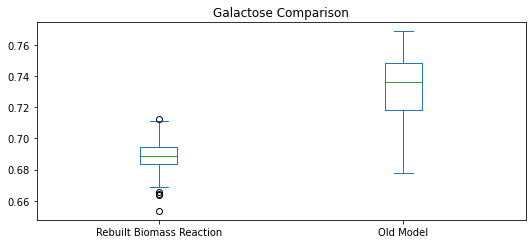

In [247]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.rcParams["figure.figsize"] = [7.5, 3.5]
plt.rcParams["figure.autolayout"] = True

data = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Galactose'], "Old Model": OldRMSEDict['Galactose']})

ax = data[["Rebuilt Biomass Reaction", "Old Model"]].plot(kind = 'box', title = 'Galactose Comparison')

plt.show()

In [248]:
ForOtherStuff = []
for x in NAcetDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Acetate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

In [249]:
ForOtherStuff = []
for x in OAcetDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Acetate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

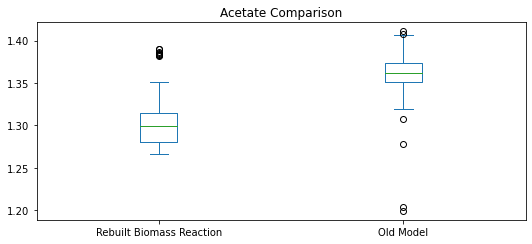

In [250]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.rcParams["figure.figsize"] = [7.5, 3.5]
plt.rcParams["figure.autolayout"] = True

data = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Acetate'], "Old Model": OldRMSEDict['Acetate']})

ax = data[["Rebuilt Biomass Reaction", "Old Model"]].plot(kind = 'box', title = 'Acetate Comparison')

plt.show()

In [251]:
ForOtherStuff = []
for x in NFructDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Fructose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Fructose'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

In [252]:
ForOtherStuff = []
for x in OFructDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Fructose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Fructose'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

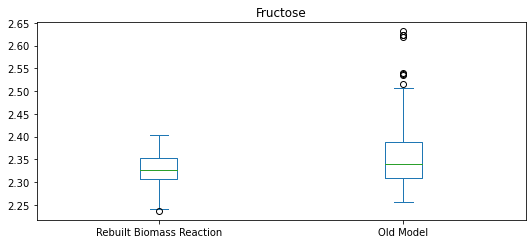

In [253]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.rcParams["figure.figsize"] = [7.5, 3.5]
plt.rcParams["figure.autolayout"] = True

data = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Fructose'], "Old Model": OldRMSEDict['Fructose']})

ax = data[["Rebuilt Biomass Reaction", "Old Model"]].plot(kind = 'box', title = 'Fructose')

plt.show()

In [254]:
ForOtherStuff = []
for x in NSuccDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Succinate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Succinate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

In [255]:
ForOtherStuff = []
for x in OSuccDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Succinate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Succinate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

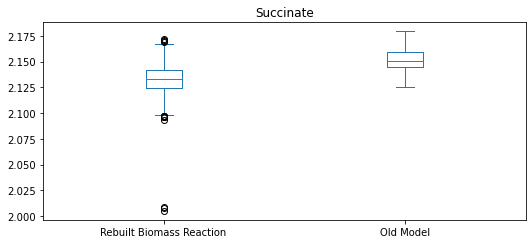

In [256]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.rcParams["figure.figsize"] = [7.5, 3.5]
plt.rcParams["figure.autolayout"] = True

data = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Succinate'], "Old Model": OldRMSEDict['Succinate']})

ax = data[["Rebuilt Biomass Reaction", "Old Model"]].plot(kind = 'box', title = 'Succinate')

plt.show()

In [257]:
ForOtherStuff = []
for x in NGlucDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glucose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Glucose'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

In [258]:
ForOtherStuff = []
for x in OGlucDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glucose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Glucose'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

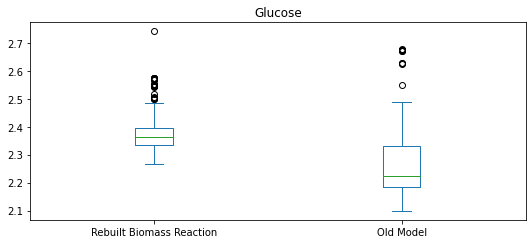

In [259]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.rcParams["figure.figsize"] = [7.5, 3.5]
plt.rcParams["figure.autolayout"] = True

data = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glucose'], "Old Model": OldRMSEDict['Glucose']})

ax = data[["Rebuilt Biomass Reaction", "Old Model"]].plot(kind = 'box', title = 'Glucose')

plt.show()

In [274]:
from scipy.stats import mannwhitneyu

U1, p = mannwhitneyu(NewRMSEDict['Acetate'], OldRMSEDict['Acetate'], method='auto')



In [275]:
print(U1)

15062.0


In [276]:
print(p)

1.2255268753550316e-308


In [21]:
print(s)

     12DGR120tipp  12DGR140tipp  12DGR141tipp  12DGR160tipp  12DGR161tipp  \
0        0.000003      0.000009      0.000004      0.000004      0.000248   
1        0.000003      0.000009      0.000004      0.000004      0.000248   
2        0.000251      0.000001      0.000009      0.000004      0.000652   
3        0.000250      0.000112      0.000008      0.000005      0.000648   
4        0.000250      0.000211      0.000008      0.000005      0.000647   
..            ...           ...           ...           ...           ...   
995      0.005330      0.006817      0.008564      0.002964      0.005447   
996      0.005313      0.005771      0.008320      0.002525      0.005425   
997      0.005309      0.005010      0.008315      0.003005      0.012322   
998      0.012563      0.001649      0.008336      0.003026      0.002654   
999      0.012572      0.001658      0.011271      0.003157      0.002666   

     12DGR180tipp  12DGR181tipp     12PPDRtex     12PPDRtpp     12PPDStex  

In [94]:
byeah = s.head()
for x in byeah:
    print(x)
#what = buh.Solution.__init__(self=rfmaybeyea2, values = what2.values)
what = buh.Solution(rfmaybeyea2)

12DGR120tipp
12DGR140tipp
12DGR141tipp
12DGR160tipp
12DGR161tipp
12DGR180tipp
12DGR181tipp
12PPDRtex
12PPDRtpp
12PPDStex
12PPDStpp
13PPDH2
14GLUCANabcpp
14GLUCANtexi
23CAMPtex
23CCMPtex
23CGMPtex
23CUMPtex
23DAPPAt2pp
23DAPPAtex
23DOGULNt4pp
23PDE2pp
23PDE4pp
23PDE7pp
23PDE9pp
26DAHtex
2AGPA120tipp
2AGPA140tipp
2AGPA141tipp
2AGPA160tipp
2AGPA161tipp
2AGPA180tipp
2AGPA181tipp
2AGPE120tipp
2AGPE140tipp
2AGPE141tipp
2AGPE160tipp
2AGPE161tipp
2AGPE180tipp
2AGPE181tipp
2AGPEAT120
2AGPEAT140
2AGPEAT141
2AGPEAT160
2AGPEAT161
2AGPEAT180
2AGPEAT181
2AGPG120tipp
2AGPG140tipp
2AGPG141tipp
2AGPG160tipp
2AGPG161tipp
2AGPG180tipp
2AGPG181tipp
2AGPGAT120
2AGPGAT140
2AGPGAT141
2AGPGAT160
2AGPGAT161
2AGPGAT180
2AGPGAT181
2DDARAA
2DGLCptspp
2DGLCtex
2DGULRGx
2DGULRGy
2DGULRx
2DGULRy
2DOXG6PP
2HESR
2HPTCOAT
2MAHMP
34dhpactex
3AMACHYD
3AMPtex
3CMPtex
3GMPtex
3HAD100
3HAD120
3HAD121
3HAD140
3HAD141
3HAD160
3HAD161
3HAD180
3HAD181
3HAD40
3HAD60
3HAD80
3HBZCT
3HCINNMH
3HPADHi
3HPPPNH
3HPPtex
3HPPtpp
3KGK
3NT

MINOHPtexi
MLDCP1App
MLDCP1Bpp
MLDCP2App
MLDCP2Bpp
MLDCP3App
MLDEP1pp
MLDEP2pp
MLTG1
MLTG2
MLTG3
MLTG4
MLTG5
MLTGY1pp
MLTGY2pp
MLTGY3pp
MLTGY4pp
MLTP1
MLTP2
MLTP3
MMCD
MMETt2pp
MMETtex
MMM
MN2t3pp
MN2tipp
MN2tpp
MN6PP
MNLptspp
MNLtex
MNNH
MNt2pp
MNtex
MOADSUx
MOAT
MOAT2
MOAT3C
MOBDabcpp
MOBDtex
MOCDS
MOCOS
MOGDS
MOHMT
MOX
MPTAT
MPTG
MPTG2
MPTS
MPTSS
MSAR
MSO3abcpp
MSO3tex
MTAN
MTHFC
MTHFD
MTHFR2
MTHTHFSs
MTRPOX
N2Otex
N2Otpp
NACtex
NACtpp
NADDP
NADH10
NADH16pp
NADH17pp
NADH18pp
NADH5
NADH9
NADHHR
NADHHS
NADHPO
NADHXD
NADHXE
NADK
NADN
NADPHHR
NADPHHS
NADPHQR2
NADPHQR3
NADPHQR4
NADPHXD
NADPHXE
NADPPPS
NADS1
NADTRHD
NAMNPP
NAt3_1p5pp
NAt3_2pp
NAt3pp
NAtex
NDP3
NDP7
NDPK1
NDPK2
NDPK3
NDPK4
NDPK5
NDPK6
NDPK7
NDPK8
NH4tex
NH4tpp
NHFRBO
NI2abcpp
NI2t3pp
NI2tex
NI2tpp
NI2uabcpp
NMNAT
NMNDA
NMNN
NMNPtpp
NMNt7pp
NMNtex
NNAM
NNATr
NNDMBRT
NNDPR
NO2t2rpp
NO2tex
NO3R1bpp
NO3R1pp
NO3R2bpp
NO3R2pp
NO3t7pp
NO3tex
NODOx
NODOy
NOVBCNtex
NOVBCNtpp
NOtex
NOtpp
NTD1
NTD10
NTD10pp
NTD11
NTD11pp
NTD12
NTD12p

In [34]:
import reframed.solvers.solution as buh

In [95]:
print(what)

AttributeError: 'CBModel' object has no attribute 'value'

In [42]:
what2 = reframed.FBA(rf_model)

In [96]:
huh = s.head(1)

In [97]:
print(huh)

   12DGR120tipp  12DGR140tipp  12DGR141tipp  12DGR160tipp  12DGR161tipp  \
0      0.000003      0.000009      0.000004      0.000004      0.000248   

   12DGR180tipp  12DGR181tipp     12PPDRtex     12PPDRtpp     12PPDStex  ...  \
0      0.000004      0.000004 -3.367523e-07 -3.367523e-07 -1.671102e-07  ...   

     Zn2tex  FixingMetaboliteIssue  RNAIntoBiomassReaction  \
0  0.000027                    0.0                0.018761   

   DNAIntoBiomassReaction  ProteinIntoBiomassReaction  \
0                0.016757                    0.129547   

   LipidIntoBiomassReaction  CellWallIntoBiomassReaction  \
0                  0.005539                     0.004972   

   CofactorIntoBiomassReaction  InorganicIntoBiomassReaction  \
0                     0.000276                      0.000786   

   NewBiomassReaction  
0                0.08  

[1 rows x 2721 columns]


In [82]:
print(what2)

Objective: 1.0434766007896472
Status: Optimal



In [151]:
s = reframed.solvers.solution.Solution()

In [152]:
print(s)

Objective: None
Status: Unknown



In [159]:
model = cobra.io.load_json_model('2017iML1515.json')
model.solver = 'gurobi'

In [160]:
NewModel, OldModel = RebuildBiomass(model, GR = 0.877)

C:\Users\Helge\anaconda3\lib\site-packages\cobra\util\solver.py:554: UserWarning: Solver status is 'infeasible'.
  warn(f"Solver status is '{status}'.", UserWarning)


Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpxbz_xe2m.lp
Reading time = 0.03 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
157.89202381557902
26.82329788711526
670.7237164201488
99.14419024339097
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.02682329788711526 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.09914419024339097 BM_Lipid + 0.6707237164201488 BM_Protein + 0.157892023815579 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


In [77]:
from reframed import load_cbmodel, from_cobrapy

In [78]:
rfmaybeyea = from_cobrapy(NewModel)

In [85]:
rfmaybeyea2 = from_cobrapy(model)

In [88]:
what2 = reframed.FBA(rfmaybeyea2)

In [89]:
print(what2)

Objective: 0.877
Status: Optimal



In [161]:
rf_model= reframed.load_cbmodel('NewModelGalac.xml')

rf_model.reactions.R_EX_glc__D_e.lb = 0
rf_model.reactions.R_EX_gal_e.lb = -20

In [162]:
rf_model2 = reframed.load_cbmodel('iML1515.xml')

rf_model2.reactions.R_EX_glc__D_e.lb = 0
rf_model2.reactions.R_EX_gal_e.lb = -20

In [102]:
reframed.FBA(rf_model)

Objective: 1.0434766007896472
Status: Optimal

In [163]:
solu = reframed.MOMA(rf_model, reference={'R_EX_gal_e': -1.97, 'R_NewBiomassReaction': 0.18})
solu2 = reframed.MOMA(rf_model2, reference={'R_EX_gal_e': -1.97, 'R_BIOMASS_Ec_iML1515_core_75p37M': 0.18})

In [164]:
solu.values['R_NewBiomassReaction']

0.0892520427989675

In [166]:
solu

Objective: -3.9050417293722717
Status: Optimal

In [110]:
rf_model.reactions.R_EX_gal_e.lb = round_down(solu.values['R_EX_gal_e'], 2)
rf_model.reactions.R_EX_gal_e.ub = round_up(solu.values['R_EX_gal_e'], 2)

rf_model.reactions.R_NewBiomassReaction.ub = round_up(solu.values['R_NewBiomassReaction'], 2)
rf_model.reactions.R_NewBiomassReaction.lb = round_down(solu.values['R_NewBiomassReaction'], 2)

rf_model2.reactions.R_EX_gal_e.lb = round_down(solu2.values['R_EX_gal_e'], 2)
rf_model2.reactions.R_EX_gal_e.ub = round_up(solu2.values['R_EX_gal_e'], 2)

rf_model2.reactions.R_BIOMASS_Ec_iML1515_core_75p37M.ub = round_up(solu2.values['R_BIOMASS_Ec_iML1515_core_75p37M'], 2)
rf_model2.reactions.R_BIOMASS_Ec_iML1515_core_75p37M.lb = round_down(solu2.values['R_BIOMASS_Ec_iML1515_core_75p37M'], 2)

In [111]:
reframed.FBA(rf_model)

Objective: 0.08952714502225022
Status: Optimal

In [118]:
s_rf = reframed.alpha.sampling.sampling(rf_model, n=1000)

In [116]:
from reframed import alpha
from reframed.alpha import sampling

In [119]:
print(s_rf)

[]


In [138]:
from reframed.solvers.solver.solver import solver_instance, solver


ImportError: cannot import name 'solve' from 'reframed.solvers.solver' (C:\Users\Helge\anaconda3\lib\site-packages\reframed-1.3.0-py3.9.egg\reframed\solvers\solver.py)

In [123]:
print(solver_instance(rf_model))

In [148]:
damn = reframed.solvers.solver.Solver.solve(rf_model.get_objective())

Exception: Not implemented for this solver.

In [147]:
rf_model.get_objective()

{'R_NewBiomassReaction': 1.0}

In [153]:
pre_solver = solver_instance(rf_model)

In [179]:
solu.fobj

-3.9050417293722717

In [175]:
rf_model.get_objective()

{'R_NewBiomassReaction': 1.0}

In [172]:
def testing_some_shit(model, solution):

    solver = solver_instance(rf_model)

    objective = rf_model.get_objective()

    solver.add_constraint('obj', objective, '=', solu.fobj)
    
    solution = solver.solve(objective, minimize = True)
    solver.remove_constraint('obj')
    
    return solution

In [185]:
solver = solver_instance(rf_model)
print(solver)

In [170]:
rf_model.get_objective()

{'R_NewBiomassReaction': 1.0}

In [173]:
thingy = testing_some_shit(rf_model, solu)

C:\Users\Helge\AppData\Local\Temp/ipykernel_11312/4294753187.py:7: DeprecationWarning: Deprecated, pass a TempConstr or use Model.addLConstr
  solver.add_constraint('obj', objective, '=', solu.fobj)


In [181]:
puhly = solver_instance(rf_model)

In [182]:
puhly.values() 

AttributeError: 'GurobiSolver' object has no attribute 'values'

In [213]:
import os
dirpath = r'./Part2SC'
for x in os.listdir(dirpath):
    if str(x) != 'test':
        print(x+' is a file')
    else:
        print(x+' is a folder')
#    model = read_sbml_model(dirpath+'/'+str(x))
#    print(model.summary())
#    print(x)

NewModelGalactosePrep.xml is a file
OldModelGalactosePrep.xml is a file
test is a folder


In [206]:
from cobra.io import read_sbml_model


In [207]:
print(dirpath)

./Part2SC


In [210]:
print(str(\))

SyntaxError: unexpected character after line continuation character (Temp/ipykernel_11312/1532357942.py, line 1)

In [17]:
import os
import pandas as pd

In [55]:
NAcetDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelAcetateResults.csv')
OAcetDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelAcetateResults.csv')

NFructDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelFructoseResults.csv')
OFructDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelFructoseResults.csv')

NGalacDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGalactoseResults.csv')
OGalacDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGalactoseResults.csv')

NGlcnDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGluconateResults.csv')
OGlcnDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGluconateResults.csv')

NGlucDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGlucoseResults.csv')
OGlucDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGlucoseResults.csv')

NGlycDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGlycerolResults.csv')
OGlycDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGlycerolResults.csv')

NPyruDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelPyruvateResults.csv')
OPyruDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelPyruvateResults.csv')

NSuccDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelSuccinateResults.csv')
OSuccDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelSuccinateResults.csv')

In [19]:
NewRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {}.
              'Gluconate': {}}
OldRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {},
              'Gluconate': {}}

In [20]:
import matplotlib.pyplot as plt
import numpy as np

In [58]:
ForOtherStuff = []
for x in NAcetDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Acetate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Acetate'] = ForOtherStuff

In [59]:
ForOtherStuff = []
for x in OAcetDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Acetate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Acetate'] = ForOtherStuff

In [60]:
ForOtherStuff = []
for x in NGalacDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Galactose'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Galactose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Galactose'] = ForOtherStuff

In [61]:
ForOtherStuff = []
for x in OGalacDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Galactose'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Galactose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Galactose'] = ForOtherStuff

In [62]:
ForOtherStuff = []
for x in NFructDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Fructose'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Fructose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Fructose'] = ForOtherStuff

In [63]:
ForOtherStuff = []
for x in OFructDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Fructose'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Fructose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Fructose'] = ForOtherStuff

In [64]:
ForOtherStuff = []
for x in NSuccDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Succinate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Succinate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Succinate'] = ForOtherStuff

In [65]:
ForOtherStuff = []
for x in OSuccDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Succinate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Succinate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Succinate'] = ForOtherStuff

In [66]:
ForOtherStuff = []
for x in NGlucDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Glucose'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glucose'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Glucose'] = ForOtherStuff

In [67]:
ForOtherStuff = []
for x in OGlucDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Glucose'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glucose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Glucose'] = ForOtherStuff

In [68]:
ForOtherStuff = []
for x in NPyruDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Pyruvate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Pyruvate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Pyruvate'] = ForOtherStuff

In [69]:
ForOtherStuff = []
for x in OPyruDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Pyruvate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Pyruvate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Pyruvate'] = ForOtherStuff

In [70]:
ForOtherStuff = []
for x in NGlcnDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGlcnDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Gluconate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Gluconate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Gluconate'] = ForOtherStuff

In [71]:
ForOtherStuff = []
for x in OGlcnDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGlcnDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Gluconate'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Gluconate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Gluconate'] = ForOtherStuff

In [72]:
ForOtherStuff = []
for x in NGlycDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Glycerol'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glycerol'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Glycerol'] = ForOtherStuff

In [73]:
ForOtherStuff = []
for x in OGlycDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'ME1+ME2':
            val2 = buh['ME1'] + buh['ME2']
            ForStuff.append(fRMSE(val2, CorrectValuesDF['Glycerol'][count]))
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glycerol'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Glycerol'] = ForOtherStuff

In [41]:
from matplotlib.pyplot import hold

ImportError: cannot import name 'hold' from 'matplotlib.pyplot' (C:\Users\Helge\anaconda3\lib\site-packages\matplotlib\pyplot.py)

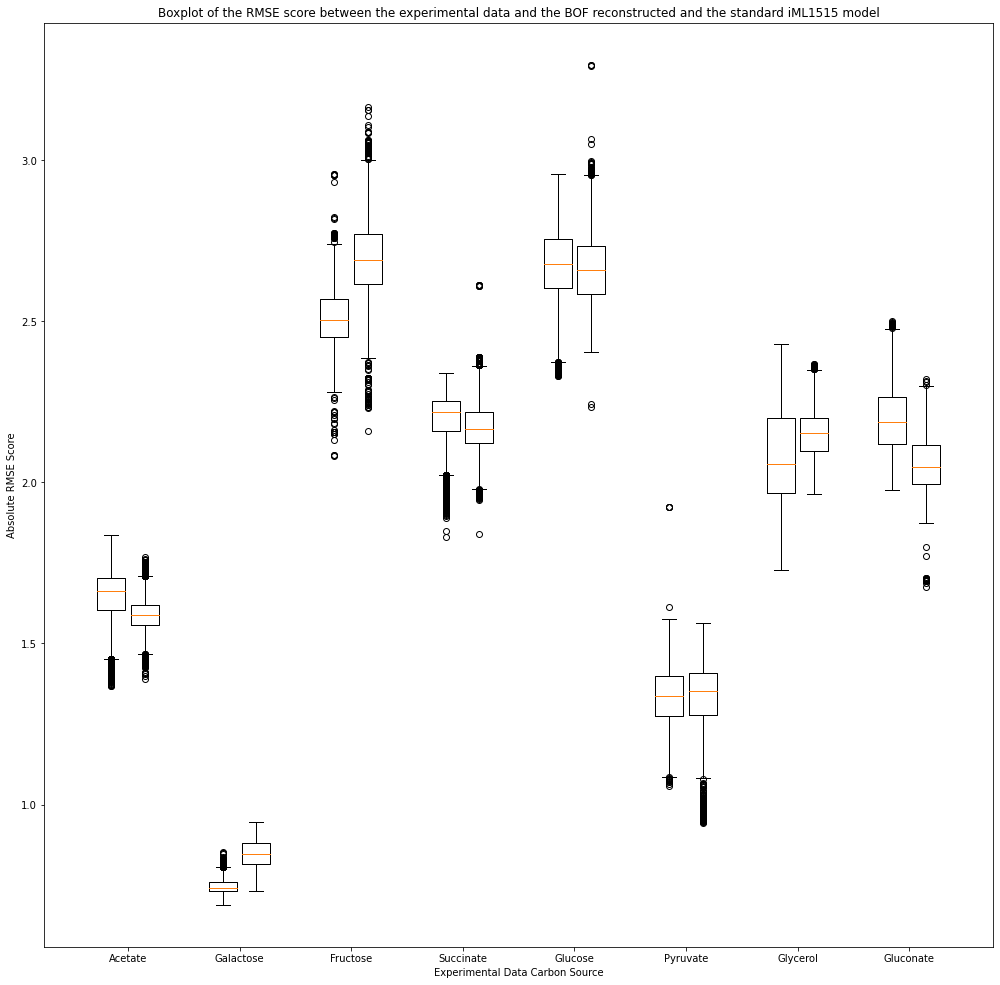

In [81]:
fig = plt.figure()
ax = plt.axes()

#Acetate
Acetate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Acetate'], "Old Model": OldRMSEDict['Acetate']})
bp = plt.boxplot(Acetate, positions = [1.2, 1.8], widths = 0.5)

#Galactose
Galactose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Galactose'], "Old Model": OldRMSEDict['Galactose']})
bp = plt.boxplot(Galactose, positions = [3.2, 3.8], widths = 0.5)

#Fructose
Fructose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Fructose'], "Old Model": OldRMSEDict['Fructose']})
bp = plt.boxplot(Fructose, positions = [5.2, 5.8], widths = 0.5)

#Succinate
Succinate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Succinate'], "Old Model": OldRMSEDict['Succinate']})
bp = plt.boxplot(Succinate, positions = [7.2, 7.8], widths = 0.5)

#Glucose
Glucose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glucose'], "Old Model": OldRMSEDict['Glucose']})
bp = plt.boxplot(Glucose, positions = [9.2, 9.8], widths = 0.5)

#Pyruvate
Pyruvate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Pyruvate'], "Old Model": OldRMSEDict['Pyruvate']})
bp = plt.boxplot(Pyruvate, positions = [11.2, 11.8], widths = 0.5)

#Glycerol
Glycerol = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glycerol'], "Old Model": OldRMSEDict['Glycerol']})
bp = plt.boxplot(Glycerol, positions = [13.2, 13.8], widths = 0.5)

#Gluconate
Gluconate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Gluconate'], "Old Model": OldRMSEDict['Gluconate']})
bp = plt.boxplot(Gluconate, positions = [15.2, 15.8], widths = 0.5)

plt.xlim(0,17)
ax.set_xticks([1.5, 3.5, 5.5, 7.5, 9.5, 11.5, 13.5, 15.5])
ax.set_xticklabels(['Acetate', 'Galactose', 'Fructose', 'Succinate', 'Glucose', 'Pyruvate', 'Glycerol', 'Gluconate'])


plt.rcParams["figure.figsize"] = [17, 17]
plt.rcParams["figure.autolayout"] = False

plt.xlabel('Experimental Data Carbon Source')
plt.ylabel('Absolute RMSE Score')
plt.title('Boxplot of the RMSE score between the experimental data and the BOF reconstructed and the standard iML1515 model')
plt.show()
fig.savefig('AbsoluteBoxPlot.pdf')

In [82]:
print('Acetate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Acetate'], OldRMSEDict['Acetate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Galactose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Galactose'], OldRMSEDict['Galactose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Fructose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Fructose'], OldRMSEDict['Fructose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Succinate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Succinate'], OldRMSEDict['Succinate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glucose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Glucose'], OldRMSEDict['Glucose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Pyruvate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Pyruvate'], OldRMSEDict['Pyruvate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glycerol t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Glycerol'], OldRMSEDict['Glycerol'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Gluconate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Gluconate'], OldRMSEDict['Gluconate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))

Acetate t-test comparison between the two populations:
T-value: 69.1361081885382
p: 0.0

Galactose t-test comparison between the two populations:
T-value: -194.84148522428958
p: 0.0

Fructose t-test comparison between the two populations:
T-value: -134.34978849760188
p: 0.0

Succinate t-test comparison between the two populations:
T-value: 18.897568178009127
p: 5.824127362622804e-79

Glucose t-test comparison between the two populations:
T-value: 7.995984266449163
p: 1.3548223526322695e-15

Pyruvate t-test comparison between the two populations:
T-value: -2.9726638424443563
p: 0.002955792793849656

Glycerol t-test comparison between the two populations:
T-value: -46.281351934308276
p: 0.0

Gluconate t-test comparison between the two populations:
T-value: 102.22056286259561
p: 0.0


In [112]:
print(NGlcnDF['NewBiomassReaction'])

0       0.460000
1       0.460290
2       0.460290
3       0.460273
4       0.460134
          ...   
9995    0.460005
9996    0.460015
9997    0.460015
9998    0.460024
9999    0.460045
Name: NewBiomassReaction, Length: 10000, dtype: float64


In [86]:
print(OldRMSEDict['Glucose'])

[2.3939372593459933, 2.3914740298236024, 2.401012699855808, 2.397508889567909, 2.412473948456219, 2.417794296443687, 2.4190501099521, 2.4228005956234977, 2.4311142072355882, 2.422824965151542, 2.424435423576549, 2.417765388467162, 2.4119966278987395, 2.4084655796580803, 2.410258771141498, 2.407327155503071, 2.392155248455296, 2.393852584663908, 2.396158225445582, 2.3989601321881997, 2.4063856091492632, 2.3967583096995475, 2.382012963925011, 2.390146062924444, 2.3806636828247534, 2.383048480101664, 2.3614999425717835, 2.3479632077917683, 2.342628064915478, 2.358604588001138, 2.36568648599333, 2.362404434088517, 2.3382235664726974, 2.3324771186272386, 2.3400155664194946, 2.338993143053323, 2.3422446034869133, 2.3475947542521247, 2.353172118084296, 2.3360943176156144, 2.331045918554235, 2.3308925366994537, 2.3308962729334017, 2.3424975781213555, 2.3541248965051276, 2.3472964301344303, 2.3353852655674774, 2.330891354721344, 2.323802181586024, 2.3162049986771605, 2.3141669999900487, 2.32101

In [89]:
print(Succinate)

      Rebuilt Biomass Reaction  Old Model
0                     2.179810   2.189079
1                     2.178065   2.187333
2                     2.169321   2.178589
3                     2.160144   2.169412
4                     2.158455   2.167723
...                        ...        ...
9995                  2.118729   2.127996
9996                  2.122972   2.132240
9997                  2.128271   2.137539
9998                  2.126302   2.135570
9999                  2.130853   2.140120

[10000 rows x 2 columns]


In [120]:
print(RMSE(NewRMSEDict['Galactose'], 0))
print(RMSE(OldRMSEDict['Galactose'], 0))

0.6886835646044752
0.7226408255294511


In [115]:
NewRMSEDict['Glucose']

[2.3642613363951135,
 2.3511165463521047,
 2.346094723424382,
 2.349953622914782,
 2.357882606196612,
 2.263688843180526,
 2.260609837029196,
 2.2882918584390177,
 2.3028903083707597,
 2.327428545041386,
 2.3293303768414986,
 2.352830378146128,
 2.3529510117258066,
 2.3253468005872464,
 2.324955327392329,
 2.3337784868018256,
 2.3370177214006853,
 2.3300159103004203,
 2.339254100177496,
 2.3366567837925114,
 2.3304365341288626,
 2.3190447122517566,
 2.340741857987402,
 2.3385352767289955,
 2.341484209186068,
 2.352629737638606,
 2.3455536300287516,
 2.345785115804335,
 2.324776005678229,
 2.321018453754191,
 2.3192577548969444,
 2.3170479388221237,
 2.3154350110857718,
 2.3142962365015918,
 2.307798249586574,
 2.2993280335471735,
 2.2940656635907613,
 2.3009598051940423,
 2.3079911535295734,
 2.3047429642767483,
 2.3023639092519814,
 2.3040038105628153,
 2.31739073171564,
 2.3205691811586475,
 2.3263664549639667,
 2.3427467144949428,
 2.33935568685012,
 2.34614409571726,
 2.34266893212

In [148]:
def percent_comparison(t_val, c_val):
    if c_val == 0:
        return 'nan'
    
    else:
        val = 0
        val = (abs(t_val-c_val))/(abs(c_val))
        return val
    

In [139]:
NewPercentDict = {'Acetate': {},
                  'Glucose': {},
                  'Succinate': {},
                  'Fructose': {},
                  'Galactose': {},
                  'Pyruvate': {},
                  'Glycerol': {},
                  'Gluconate':{}}
OldPercentDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {},
                 'Gluconate': {}}

In [150]:
ForOtherStuff = []
for x in NAcetDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Acetate'][count]))
            if Val != 'nan':
                ForStuff.append(percent_comparison(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Acetate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

In [155]:
ForOtherStuff = []
for x in OAcetDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Acetate'][count]))
            if Val != 'nan':
                ForStuff.append(percent_comparison(buh[y], CorrectValuesDF['Acetate'][count]))
                
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Acetate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

In [157]:
ForOtherStuff = []
for x in NGlucDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Glucose'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Glucose'] = ForOtherStuff

[0.008121685796339005, 0.020275534903929086, 0.009526850262436961, 0.5488912274088296, 0.5508307571670216, 0.1125607215131923, 0.07282408695699301, 2.072824086956993, 2.078622283037368, 0.07876493618599706, 0.941570185408725, 0.043654798403723515, 0.9988797533967063, 0.9988797533967063, 0.06559477710678396, 0.4744995246356555, 2.27497897023629, 0.6568140325990822, 0.5942940606684811, 4.13394285741517, 0.7445302162760086, 0.1272175311637319, 0.9984789570027699, 0.3507967797867877, 0.35715769436038675, 0.48405201397573355, 0.17726879465134895, 0.1897761373412284, 0.07694834334288568]


In [159]:
ForOtherStuff = []
for x in OGlucDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Glucose'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
                
        except:
            pass
            
    count = 0
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Glucose'] = ForOtherStuff

[0.01114356647689568, 0.029572131392752457, 0.0625660953366521, 0.7926235040275834, 0.7954135073835978, 0.12781580243578314, 0.07600288202440043, 2.0760028820244005, 2.079422015273041, 0.07975919931926767, 0.6597359347942252, 0.026237018874746106, 0.999501895262103, 0.999501895262103, 0.027971962700237066, 0.3465292228558645, 2.2593695358311767, 0.41512943125823737, 0.37459815494936205, 7.416892799179929, 0.47199524177584495, 0.1572055879730664, 1.0, 0.3047929541790865, 0.32683400011647035, 0.4206830276847611, 0.029973529261907397, 0.031662401002381706, 0.07701205171817783]


In [161]:
ForOtherStuff = []
for x in NSuccDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Succinate'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Succinate'] = ForOtherStuff

[0.07842689725516878, 0.031930004513604754, 1.5880804220342333, 0.9982237718362174, 1.0018760010130723, 0.9723416828445752, 0.8214842110797087, 0.6124347451777815, 1.3875652548222186, 1.552488574698968, 0.4478626633146232, 1.0667144745912012, 0.13199755941823396, 1.0, 1.0, 0.99946671907986, 0.9994544686846617, 1.1959174734858966, 1.1397111375861364, 1.0396465843814031, 1.0423344657665017, 1.2539649891488847, 1.0, 0.5296725819045794, 0.1295120974303484, 0.16423921159171812, 0.16241246519410293, 0.043414444614123145, 0.3717495450946332, 0.9968713231719235, 0.3295228628184353, 0.7888541260916909, 0.8209021367721863, 0.25496293512624635]


In [162]:
ForOtherStuff = []
for x in OSuccDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Succinate'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
                
        except:
            pass
            
    count = 0
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Succinate'] = ForOtherStuff

[0.07842689725516878, 0.031930004513604754, 1.5880804220342333, 0.9982237718362174, 1.0018760010130723, 0.9723416828445752, 0.8214842110797087, 0.6124347451777815, 1.3875652548222186, 1.552488574698968, 0.4478626633146232, 1.0667144745912012, 0.13199755941823396, 1.0, 1.0, 0.99946671907986, 0.9994544686846617, 1.1959174734858966, 1.1397111375861364, 1.0396465843814031, 1.0423344657665017, 1.2539649891488847, 1.0, 0.5296725819045794, 0.1295120974303484, 0.16423921159171812, 0.16241246519410293, 0.043414444614123145, 0.3717495450946332, 0.9968713231719235, 0.3295228628184353, 0.7888541260916909, 0.8209021367721863, 1.0]


In [165]:
ForOtherStuff = []
for x in NFructDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Fructose'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Fructose'] = ForOtherStuff

[0.007735922819434624, 0.012012393479847202, 0.455483516143242, 1.1155777615467302, 0.1746143680948694, 0.14909159915293785, 0.06900813148897261, 2.069008131488973, 2.056459975569652, 0.05768629646470366, 0.4811571242451276, 0.06882828101727047, 0.4584954538941581, 0.4588741540700999, 1.6367901049837705, 0.5264154260215728, 0.4773657012770636, 0.9371130029033182, 0.5808091003175991, 0.3990090683595526, 0.9935381281279972, 0.2655324232640886, 0.26833805005573513, 0.35012174917551386, 0.19305973150643727, 0.3968523592351098, 0.9981964179429242, 0.9925507536378144, 3.786364987858818, 3.905319082437181, 0.2795555207226783]


In [166]:
ForOtherStuff = []
for x in OFructDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Fructose'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
                
        except:
            pass
            
    count = 0
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Fructose'] = ForOtherStuff

[0.00861924852072979, 0.009840265314484219, 0.57071516561231, 1.917277362206811, 0.270695282652333, 0.1715853916351165, 0.06666186320612234, 2.0666618632061224, 2.0511623054164687, 0.0511623054164687, 0.9354391934380907, 0.012123660503192845, 0.5688659394260145, 0.5697184080390877, 1.5688722723743251, 0.664699268174485, 0.6186785118665695, 1.6994931580024097, 0.7157339690317943, 0.47638139529076073, 1.0, 0.232391054209493, 0.24853480997856522, 0.30239248417718395, 0.0991169711269544, 0.6003137205473854, 1.0, 0.9983838581119315, 33.23139783460227, 33.06887997393023, 0.32008692299592195]


In [167]:
ForOtherStuff = []
for x in NGalacDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Galactose'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Galactose'] = ForOtherStuff

[0.005338015451482946, 0.15438145531865044, 0.6249815256714137, 0.635691894265139, 0.000208214857194536, 0.003813895503602754, 1.9961861044963973, 1.9827510184496189, 0.017026763416885846, 0.9267401453544459, 0.4093544635069583, 0.9873673352331399, 0.9873673352331399, 0.31558340723855705, 0.8520897208353561, 2.812554083034541, 0.881475399915252, 0.6378437762067405, 5.9525384770918, 1.4311016909441416, 0.46614583632883066, 0.9819804209934049, 0.028596729682505366, 2.012073000979722, 4.353892071269516, 0.26300294640652155, 0.3183899356320916, 38.7809561208898, 3.3359052830092004, 0.9400114415484186, 0.9532596031156633, 0.555472882629181]


In [168]:
ForOtherStuff = []
for x in OGalacDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Galactose'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
                
        except:
            pass
            
    count = 0
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Galactose'] = ForOtherStuff

[0.005561625099198335, 0.34215384792582587, 0.6884349678119762, 0.6898985867219709, 0.1489517643184545, 0.07130233766606288, 2.071302337666063, 2.079777075263806, 0.07978616791032644, 0.9472794021925299, 0.221999831915636, 0.9938356781580006, 0.9938356781580006, 0.7579723914957417, 0.6617374644306554, 1.7071127424192212, 1.134389316109023, 0.8793433936973729, 8.5168882687064, 1.7097659533584932, 0.13468321891027898, 1.0, 0.18452885641241618, 2.5916947356555418, 5.849435793345374, 0.43720575131273237, 0.19888466416161324, 1.0, 0.06941695689180005, 0.9811667388235225, 0.9814645045480699, 0.1666346673125078]


In [169]:
ForOtherStuff = []
for x in NPyruDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Pyruvate'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Pyruvate'] = ForOtherStuff

[0.006186041601727401, 0.003193119412960613, 1.908373402755747, 0.9080167641661712, 1.0038343174159652, 0.510183414906522, 0.40947584208927923, 0.03523656454212533, 2.0352365645421253, 2.153976035006154, 0.15179111627854686, 1.0007554223041586, 0.009240547780556026, 0.9139672969213708, 0.9204894250930983, 1.6670286516978547, 1.9183056868885076, 1.1086126716004034, 1.1104195194156, 4.145306690834713, 0.9981600814468164, 0.9958261121223693, 0.2568162961513963, 0.4910494280419507, 0.5527233521593854, 0.2305709095392362, 0.02677513489563867, 1.0, 1.0, 17.95971810242893, 17.858060086991603, 0.3076951268315075]


In [170]:
ForOtherStuff = []
for x in OPyruDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Pyruvate'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
                
        except:
            pass
            
    count = 0
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Pyruvate'] = ForOtherStuff

[0.0045036502002337294, 0.0024609411223845724, 1.9249649637441764, 0.9505957597586493, 1.0146787276787324, 0.8568573734950474, 0.4844109951682114, 0.18581674777259105, 2.185816747772591, 2.2700150701529256, 0.26615281150609355, 1.0015843286373416, 0.012572567225793991, 0.9748517889317465, 0.9782642267933224, 1.7660707922808276, 2.2307921661362484, 1.41596331989472, 1.436924927788511, 4.472259251936846, 0.9870368555887218, 0.9937679881054723, 0.23966212734500555, 0.4331444508868327, 0.4720147970345038, 0.17914413652620836, 0.03249856812365895, 1.0, 0.9927434817285159, 14.78847424590929, 14.672595178052898, 0.41025731758661077]


In [171]:
ForOtherStuff = []
for x in NGlycDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = NGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Glycerol'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
NewPercentDict['Glycerol'] = ForOtherStuff

[0.04521866515212168, 1.0607506875919617, 0.9951978255987656, 1.0263454533326273, 1.024197547777975, 0.1314499418543699, 0.14733980406457528, 2.1473398040645755, 2.1555695480430144, 0.15556984075127844, 0.5784662443994449, 0.3468201564526034, 1.0, 1.0, 0.9951659428009855, 0.9951720548377805, 1.2049255597566142, 1.1486271845867453, 1.03600376736311, 1.1284141393300229, 1.283204945526155, 0.3220285749480448, 0.09245314584146107, 0.18031420911521512, 0.23545993814705674, 0.5317027939982328, 0.8967200446167068, 0.02040816326558959]


In [172]:
ForOtherStuff = []
for x in OGlycDF['Unnamed: 0']:
    ForStuff = []
    Val = 0
    buh = OGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
            
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
                  
        try:
            Val = (percent_comparison(buh[y], CorrectValuesDF['Glycerol'][count]))
            if Val != 'nan':
                ForStuff.append(Val)
                
        except:
            pass
            
    count = 0
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)

print(ForStuff)
OldPercentDict['Glycerol'] = ForOtherStuff

[0.09376231592128599, 1.0748927943123587, 0.9905742571322219, 1.5999384745317615, 1.594029756329944, 0.12700492268814834, 0.12931371555868953, 2.1293137155586894, 2.1332242310192098, 0.13485692894966314, 0.9734840319470799, 0.575096251664993, 0.3860054814785891, 0.3860054814785891, 0.9957684598848187, 0.9986413243537389, 1.2658795629240573, 1.1987462717578385, 1.0960942241224365, 1.250128913222925, 1.3214088855123292, 0.10935484576812068, 0.1670264421900181, 0.06205040547748445, 0.12466242843506116, 0.7735996385233974, 0.9030538435915909, 4.166860697165925e-05]


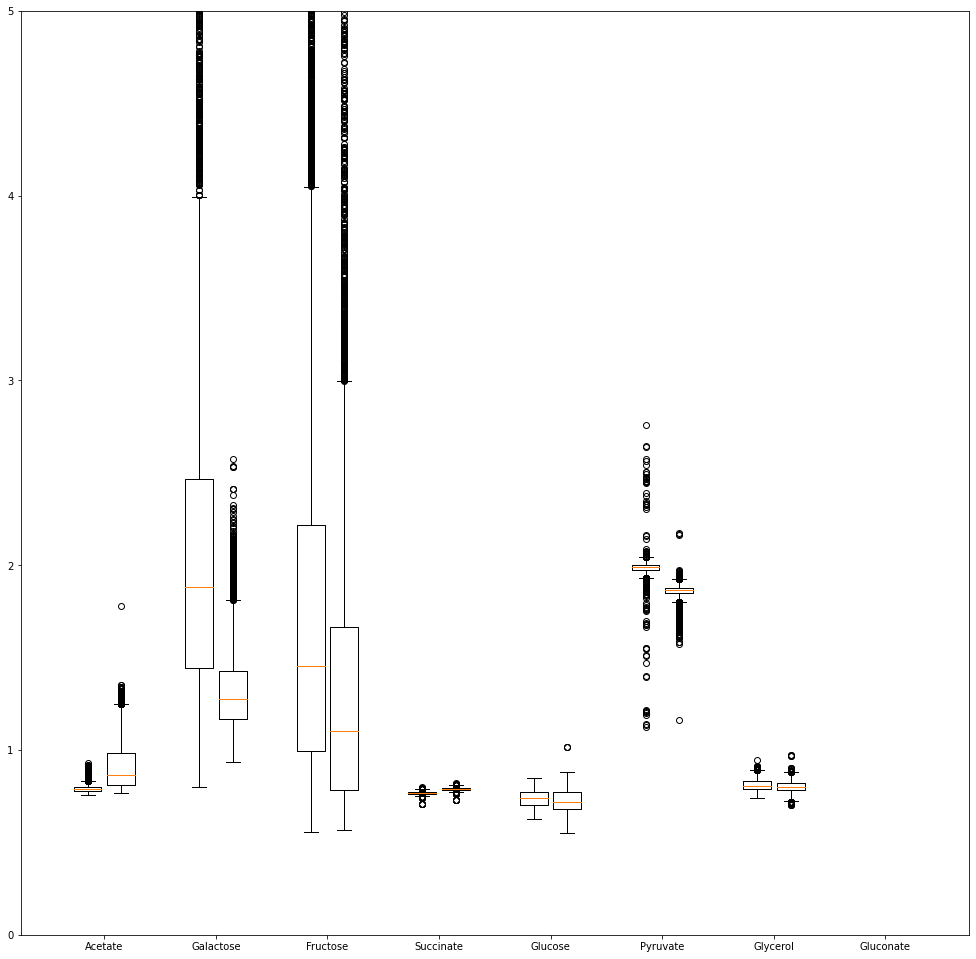

In [175]:
fig = plt.figure()
ax = plt.axes()

#Acetate
Acetate = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Acetate'], "Old Model": OldPercentDict['Acetate']})
bp = plt.boxplot(Acetate, positions = [1.2, 1.8], widths = 0.5)

#Galactose
Galactose = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Galactose'], "Old Model": OldPercentDict['Galactose']})
bp = plt.boxplot(Galactose, positions = [3.2, 3.8], widths = 0.5)

#Fructose
Fructose = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Fructose'], "Old Model": OldPercentDict['Fructose']})
bp = plt.boxplot(Fructose, positions = [5.2, 5.8], widths = 0.5)

#Succinate
Succinate = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Succinate'], "Old Model": OldPercentDict['Succinate']})
bp = plt.boxplot(Succinate, positions = [7.2, 7.8], widths = 0.5)

#Glucose
Glucose = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Glucose'], "Old Model": OldPercentDict['Glucose']})
bp = plt.boxplot(Glucose, positions = [9.2, 9.8], widths = 0.5)

#Pyruvate
Pyruvate = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Pyruvate'], "Old Model": OldPercentDict['Pyruvate']})
bp = plt.boxplot(Pyruvate, positions = [11.2, 11.8], widths = 0.5)

#Glycerol
Glycerol = pd.DataFrame({"Rebuilt Biomass Reaction": NewPercentDict['Glycerol'], "Old Model": OldPercentDict['Glycerol']})
bp = plt.boxplot(Glycerol, positions = [13.2, 13.8], widths = 0.5)

#Gluconate
#Gluconate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Gluconate'], "Old Model": OldRMSEDict['Gluconate']})
#bp = plt.boxplot(Gluconate, positions = [15.2, 15.8], widths = 0.5)

plt.xlim(0,17)
plt.ylim(0,5)
ax.set_xticks([1.5, 3.5, 5.5, 7.5, 9.5, 11.5, 13.5, 15.5])
ax.set_xticklabels(['Acetate', 'Galactose', 'Fructose', 'Succinate', 'Glucose', 'Pyruvate', 'Glycerol', 'Gluconate'])


plt.rcParams["figure.figsize"] = [17, 17]
plt.rcParams["figure.autolayout"] = False

plt.title('')

plt.show()

In [3]:
from scipy import stats

In [4]:
print('Acetate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Acetate'], OldRMSEDict['Acetate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Galactose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Galactose'], OldRMSEDict['Galactose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Fructose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Fructose'], OldRMSEDict['Fructose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Succinate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Succinate'], OldRMSEDict['Succinate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glucose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Glucose'], OldRMSEDict['Glucose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Pyruvate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Pyruvate'], OldRMSEDict['Pyruvate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glycerol t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Glycerol'], OldRMSEDict['Glycerol'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Gluconate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Gluconate'], OldRMSEDict['Gluconate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))

Acetate t-test comparison between the two populations:


NameError: name 'NewRMSEDict' is not defined

In [186]:
AcTest=stats.ttest_ind(NewRMSEDict['Acetate'], OldRMSEDict['Acetate'])
print(AcTest[1])

0.0


In [196]:
print('Acetate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Acetate'], OldPercentDict['Acetate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Galactose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Galactose'], OldPercentDict['Galactose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Fructose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Fructose'], OldPercentDict['Fructose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Succinate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Succinate'], OldPercentDict['Succinate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glucose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Glucose'], OldPercentDict['Glucose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Pyruvate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Pyruvate'], OldPercentDict['Pyruvate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glycerol t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Glycerol'], OldPercentDict['Glycerol'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Gluconate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewPercentDict['Gluconate'], OldPercentDict['Gluconate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))

Acetate t-test comparison between the two populations:
T-value: -89.42863407359208
p: 0.0

Galactose t-test comparison between the two populations:
T-value: 86.07971907723687
p: 0.0

Fructose t-test comparison between the two populations:
T-value: 8.439160596688078
p: 3.410989132107158e-17

Succinate t-test comparison between the two populations:
T-value: -208.7114365800661
p: 0.0

Glucose t-test comparison between the two populations:
T-value: 22.938174172216833
p: 5.878030812075371e-115

Pyruvate t-test comparison between the two populations:
T-value: 227.36469582838492
p: 0.0

Glycerol t-test comparison between the two populations:
T-value: 23.311177048819694
p: 1.300062409761028e-118

Gluconate t-test comparison between the two populations:


KeyError: 'Gluconate'

In [223]:
sol = Solution(values=NGlycDF.iloc[0], status=Status.OPTIMAL, fobj=0.48)

In [214]:
import reframed
from reframed.solvers.solution import Solution, Status

In [220]:
print(sol.values)

Unnamed: 0                      0.000000
12DGR120tipp                    0.000000
12DGR140tipp                    0.000000
12DGR141tipp                    0.000000
12DGR160tipp                    0.000000
                                  ...   
LipidIntoBiomassReaction        0.038990
CellWallIntoBiomassReaction     0.029832
CofactorIntoBiomassReaction     0.001657
InorganicIntoBiomassReaction    0.004716
NewBiomassReaction              0.480000
Name: 0, Length: 2722, dtype: float64


In [224]:
print(sol)

Objective: 0.48
Status: Optimal



In [225]:
rf_model= reframed.load_cbmodel('NewModelGalac.xml')

rf_model.reactions.R_EX_glc__D_e.lb = 0
rf_model.reactions.R_EX_gal_e.lb = -20

In [226]:
print(rf_model)

R_12DGR120tipp: M_12dgr120_p --> M_12dgr120_c
R_12DGR140tipp: M_12dgr140_p --> M_12dgr140_c
R_12DGR141tipp: M_12dgr141_p --> M_12dgr141_c
R_12DGR160tipp: M_12dgr160_p --> M_12dgr160_c
R_12DGR161tipp: M_12dgr161_p --> M_12dgr161_c
R_12DGR180tipp: M_12dgr180_p --> M_12dgr180_c
R_12DGR181tipp: M_12dgr181_p --> M_12dgr181_c
R_12PPDRtex: M_12ppd__R_e <-> M_12ppd__R_p
R_12PPDRtpp: M_12ppd__R_p <-> M_12ppd__R_c
R_12PPDStex: M_12ppd__S_e <-> M_12ppd__S_p
R_12PPDStpp: M_12ppd__S_p <-> M_12ppd__S_c
R_13PPDH2: M_3hppnl_c + M_h_c + M_nadph_c <-> M_13ppd_c + M_nadp_c
R_14GLUCANabcpp: M_14glucan_p + M_atp_c + M_h2o_c --> M_14glucan_c + M_adp_c + M_h_c + M_pi_c
R_14GLUCANtexi: M_14glucan_e --> M_14glucan_p
R_23CAMPtex: M_23camp_e <-> M_23camp_p
R_23CCMPtex: M_23ccmp_e <-> M_23ccmp_p
R_23CGMPtex: M_23cgmp_e <-> M_23cgmp_p
R_23CUMPtex: M_23cump_e <-> M_23cump_p
R_23DAPPAt2pp: M_23dappa_p + M_h_p --> M_23dappa_c + M_h_c
R_23DAPPAtex: M_23dappa_e <-> M_23dappa_p
R_23DOGULNt4pp: M_23doguln_p + M_na1_p -->

In [227]:
thingymajig = reframed.FBA(rf_model)

Set parameter WLSAccessID
Set parameter WLSSecret
Set parameter LicenseID to value 934576
Academic license - for non-commercial use only - registered to helgesmo@stud.ntnu.no


In [228]:
print(thingymajig)

Objective: 1.0434766007896472
Status: Optimal



In [229]:
thingymajig.values['R_NewBiomassReaction']

1.0434766007896472

In [468]:
from reframed.solvers import solver_instance
from reframed.solvers.solver import VarType
from reframed.solvers.solution import Solution, Status
from reframed.core.model import ReactionType
from warnings import warn
from math import inf

def my_pFBA(model, objective=None, obj_frac=None, minimize=False, constraints=None, reactions=None, solver=None,
         cleanup=True, values = None, fobj_val=None):
    """ Run a parsimonious Flux Balance Analysis (pFBA) simulation:
    Arguments:
        model (CBModel): a constraint-based model
        objective (dict): objective coefficients (optional)
        obj_frac (float): require only a fraction of the main objective during the flux minimization step (optional)
        minimize (bool): sense of optimization (maximize by default)
        constraints (dict): environmental or additional constraints (optional)
        reactions (list): list of reactions to be minimized (optional, default: all)
        solver (Solver): solver instance instantiated with the model, for speed (optional)
        cleanup (bool): remove temporary variables from solution (default: True)
        
        Values: For bypassing the FBA state
        fobj_val: same thing
        
    Returns:
        Solution: solution
    """

    if not solver:
        solver = solver_instance(model)

    if not objective:
        objective = model.get_objective()
    elif isinstance(objective, str):
        objective = {objective: 1}

    pre_solution = Solution(values = values, status = Status.OPTIMAL, fobj = values['NewBiomassReaction'])

    if pre_solution.status != Status.OPTIMAL:
        return pre_solution

    if obj_frac is None:
        solver.add_constraint('obj', objective, '=', pre_solution.fobj)
    else:
        solver.add_constraint('obj', objective, '>', obj_frac * pre_solution.fobj)

    if not reactions:
        reactions = model.reactions.keys()

    if not hasattr(solver, 'pFBA_flag'):
        solver.pFBA_flag = True
        for r_id in reactions:
            if model.reactions[r_id].reversible:
                pos, neg = r_id + '_p', r_id + '_n'
                solver.add_variable(pos, 0, inf, update=False)
                solver.add_variable(neg, 0, inf,  update=False)
        solver.update()
        for r_id in reactions:
            if model.reactions[r_id].reversible:
                pos, neg = r_id + '_p', r_id + '_n'
                solver.add_constraint('c' + pos, {r_id: -1, pos: 1}, '>', 0, update=False)
                solver.add_constraint('c' + neg, {r_id: 1, neg: 1}, '>', 0, update=False)
        solver.update()

    objective = dict()
    for r_id in reactions:
        if model.reactions[r_id].reversible:
            pos, neg = r_id + '_p', r_id + '_n'
            objective[pos] = 1
            objective[neg] = 1
        else:
            objective[r_id] = 1

    solution = solver.solve(objective, minimize=True, constraints=constraints)
    solver.remove_constraint('obj')
    solution.pre_solution = pre_solution

    if cleanup:
        for r_id in reactions:
            if model.reactions[r_id].reversible:
                pos, neg = r_id + '_p', r_id + '_n'
                del solution.values[pos]
                del solution.values[neg]

    return solution

In [249]:
NGalacDF.iloc[0]['NewBiomassReaction']

0.0800000725132493

In [327]:
model = cobra.io.load_json_model('2017iML1515.json')
NewModel, OldModel = RebuildBiomass(model, GR = 0.39)
BMReaction = NewModel.reactions.get_by_id('NewBiomassReaction')
BMReaction.lower_bound = 0
BMReaction.upper_bound = 1000

NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0

NewModel.reactions.get_by_id('EX_pyr_e').lower_bound = -40

NewModel.reactions.get_by_id('EX_ac_e').upper_bound = 1000

NewModel.reactions.get_by_id('EX_lac__D_e').upper_bound = 1000

cobra.io.write_sbml_model(NewModel, 'NPyruModel.xml')

model = cobra.io.load_json_model('2017iML1515.json')
model.reactions.get_by_id('EX_glc__D_e').lower_bound = 0
model.reactions.get_by_id('EX_pyr_e').lower_bound = -40
model.reactions.get_by_id('EX_ac_e').upper_bound = 1000
model.reactions.get_by_id('EX_lac__D_e').upper_bound = 1000

cobra.io.write_sbml_model(model, 'OPyruModel.xml')

Read LP format model from file C:\Users\Helge\AppData\Local\Temp\tmpawsi44ef.lp
Reading time = 0.02 seconds
: 1877 rows, 5424 columns, 21150 nonzeros
122.78066671648499
52.04094181585457
891.2238913473865
77.15112715815488
62.149090484982004
3.4524848298
9.825061811939001
NewBiomassReaction: 0.062149090484982 BM_CellWall + 0.0034524848298 BM_Cofactor + 0.05204094181585457 BM_DNA + 0.009825061811939002 BM_Inorganic + 0.07715112715815488 BM_Lipid + 0.8912238913473864 BM_Protein + 0.12278066671648499 BM_RNA + 75.37723 atp_c + 70.028756 h2o_c --> 75.37723 adp_c + 75.37723 h_c + 75.37323 pi_c


'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, use 'sbo' provider instead
'SBO' provider is deprecated, u

In [308]:
NewModel.reactions.get_by_id('EX_glc__D_e').lower_bound = 0

NewModel.reactions.get_by_id('EX_gal_e').lower_bound = -2

rf_model = reframed.from_cobrapy(NewModel)
rf_model.reactions.EX_gal_e.lb = round_down(NGalacDF.iloc[0]['EX_gal_e'], 2)
rf_model.reactions.EX_gal_e.ub = round_up(NGalacDF.iloc[0]['EX_gal_e'], 2)

In [309]:
thingy2 = None
thingy2 = my_pFBA(rf_model, values=NGalacDF.iloc[0], 
                  fobj_val=NGalacDF.iloc[0]['NewBiomassReaction'], 
                  constraints={rf_model.reactions.NewBiomassReaction.lb: 0.7,
                              rf_model.reactions.NewBiomassReaction.ub: 0.9})

C:\Users\Helge\AppData\Local\Temp/ipykernel_16908/846534401.py:42: DeprecationWarning: Deprecated, pass a TempConstr or use Model.addLConstr
  solver.add_constraint('obj', objective, '=', pre_solution.fobj)
C:\Users\Helge\AppData\Local\Temp/ipykernel_16908/846534401.py:60: DeprecationWarning: Deprecated, pass a TempConstr or use Model.addLConstr
  solver.add_constraint('c' + pos, {r_id: -1, pos: 1}, '>', 0, update=False)
C:\Users\Helge\AppData\Local\Temp/ipykernel_16908/846534401.py:61: DeprecationWarning: Deprecated, pass a TempConstr or use Model.addLConstr
  solver.add_constraint('c' + neg, {r_id: 1, neg: 1}, '>', 0, update=False)


In [310]:
print(thingy2.values['EX_gal_e'])

-1.97


In [311]:
print(rf_model.reactions.EX_gal_e)

EX_gal_e: gal_e <->  [-1.98, -1.97]


print(rf_model.reactions.EX_gal_e)

In [281]:
print(NGalacDF.iloc[0]['EX_gal_e'])

-1.9799979873399776


In [315]:
print(round_up(NGalacDF.iloc[0]['NewBiomassReaction'], ))

0.1


In [278]:
print(round_up(-1.9, 2))

-1.9


In [470]:
ListOfDataFrames={'NAcetDF': NAcetDF, 'OAcetDF': OAcetDF, 'NFructDF': NFructDF, 'OFructDF': OFructDF,
                  'NGalacDF': NGalacDF, 'OGalacDF': OGalacDF, 'NGlcnDF': NGlcnDF, 'OGlcnDF': OGlcnDF, 
                  'NGlucDF': NGlucDF, 'OGlucDF': OGlucDF, 'NGlycDF': NGlycDF, 'OGlycDF': OGlycDF, 
                  'NPyruDF': NPyruDF, 'OPyruDF': OPyruDF, 'NSuccDF': NSuccDF, 'OSuccDF': OSuccDF}

In [473]:
ConstraintsDataFrame = {'NAcetDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0)}, 
                        'OAcetDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0)}, 
                        
                        'NFructDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0),
                                     'EX_fru_e':(0,0)}, 
                        'OFructDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0),
                                     'EX_fru_e':(0,0)},
                        
                        'NGalacDF': {'NewBiomassReaction':(0,0),
                                   'EX_gal_e':(0,0)}, 
                        'OGalacDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_gal_e':(0,0)}, 
                        
                        'NGlcnDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_glcn_e':(0,0)}, 
                        'OGlcnDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_glcn_e':(0,0)},
                        
                        'NGlucDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_glc__D_e':(0,0)}, 
                        'OGlucDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_glc__D_e':(0,0)}, 
                        
                        'NGlycDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_glyc_e':(0,0)}, 
                        'OGlycDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_glyc_e':(0,0)},
                        
                        'NPyruDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_lac__D_e':(0,0),
                                   'EX_pyr_e':(0,0)}, 
                        'OPyruDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_lac__D_e':(0,0),
                                   'EX_pyr_e':(0,0)}, 
                        
                        'NSuccDF': {'NewBiomassReaction':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_succ_e':(0,0),
                                   'EX_fum_e':(0,0)}, 
                        'OSuccDF': {'BIOMASS_Ec_iML1515_core_75p37M':(0,0),
                                   'EX_ac_e':(0,0),
                                   'EX_succ_e':(0,0),
                                   'EX_fum_e':(0,0)}}

In [501]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')

for x in ListOfDataFrames:
    print('Starting on '+str(x))
    dir_path = 'C:/Users/Helge/MasterProject/Part2/models/' +str(x).strip('DF')+'Model.xml'
    cmodel = cobra.io.read_sbml_model(dir_path)
    rf_model = reframed.from_cobrapy(cmodel)
    
    
    DataFrameForSaving = pd.DataFrame()
    
    for y in range(len(ListOfDataFrames[x])):
        if y%10 == 0:
            print(y)
        for z in ConstraintsDataFrame[x]:
            wild = (round_down(ListOfDataFrames[x].iloc[y][z]), round_up(ListOfDataFrames[x].iloc[y][z]))
            ConstraintsDataFrame[x][z] = wild
            
        if x[0]=='N':
            fobj_val2 = ListOfDataFrames[x].iloc[y]['NewBiomassReaction']
        else:
            fobj_val2 = ListOfDataFrames[x].iloc[y]['BIOMASS_Ec_iML1515_core_75p37M']
            
        solu = my_pFBA(rf_model, values = ListOfDataFrames[x].iloc[y], fobj_val = fobj_val2, constraints = ConstraintsDataFrame[x])
        SoluDF = solu.to_dataframe().T
        DataFrameForSaving = pd.concat([DataFrameForSaving, SoluDF])
        
    DataFrameForSaving.to_csv(str(x)+'Results.csv')
    print(str(x)+' is done!')

SyntaxError: invalid syntax (Temp/ipykernel_16908/3648572155.py, line 14)

In [504]:
def timetest(value):
    match(value):
        case 0:
            return(value)

SyntaxError: invalid syntax (Temp/ipykernel_16908/215928749.py, line 2)

In [477]:
ListOfDataFrames['NAcetDF'].iloc[0]['NewBiomassReaction']

0.2500001072506023

In [482]:
rf_model

12DGR120tipp: 12dgr120_p --> 12dgr120_c [0.0, 1000.0]
12DGR140tipp: 12dgr140_p --> 12dgr140_c [0.0, 1000.0]
12DGR141tipp: 12dgr141_p --> 12dgr141_c [0.0, 1000.0]
12DGR160tipp: 12dgr160_p --> 12dgr160_c [0.0, 1000.0]
12DGR161tipp: 12dgr161_p --> 12dgr161_c [0.0, 1000.0]
12DGR180tipp: 12dgr180_p --> 12dgr180_c [0.0, 1000.0]
12DGR181tipp: 12dgr181_p --> 12dgr181_c [0.0, 1000.0]
12PPDRtex: 12ppd__R_e <-> 12ppd__R_p [-1000.0, 1000.0]
12PPDRtpp: 12ppd__R_p <-> 12ppd__R_c [-1000.0, 1000.0]
12PPDStex: 12ppd__S_e <-> 12ppd__S_p [-1000.0, 1000.0]
12PPDStpp: 12ppd__S_p <-> 12ppd__S_c [-1000.0, 1000.0]
13PPDH2: 3hppnl_c + h_c + nadph_c <-> 13ppd_c + nadp_c [-1000.0, 1000.0]
14GLUCANabcpp: 14glucan_p + atp_c + h2o_c --> 14glucan_c + adp_c + h_c + pi_c [0.0, 1000.0]
14GLUCANtexi: 14glucan_e --> 14glucan_p [0.0, 1000.0]
23CAMPtex: 23camp_e <-> 23camp_p [-1000.0, 1000.0]
23CCMPtex: 23ccmp_e <-> 23ccmp_p [-1000.0, 1000.0]
23CGMPtex: 23cgmp_e <-> 23cgmp_p [-1000.0, 1000.0]
23CUMPtex: 23cump_e <-> 23cump

In [483]:
soluthing = reframed.FBA(rf_model)

In [485]:
soluthing.to_dataframe().T

,12DGR120tipp,12DGR140tipp,12DGR141tipp,12DGR160tipp,12DGR161tipp,12DGR180tipp,12DGR181tipp,12PPDRtex,12PPDRtpp,12PPDStex,...,Zn2tex,FixingMetaboliteIssue,RNAIntoBiomassReaction,DNAIntoBiomassReaction,ProteinIntoBiomassReaction,LipidIntoBiomassReaction,CellWallIntoBiomassReaction,CofactorIntoBiomassReaction,InorganicIntoBiomassReaction,NewBiomassReaction
value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000125,0.0,0.054643,0.028864,0.390765,0.026931,0.022841,0.001269,0.003611,0.367514


In [493]:
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [508]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')

for x in ListOfDataFrames:
    print('Starting on '+str(x))
    dir_path = 'C:/Users/Helge/MasterProject/Part2/models/' +str(x).strip('DF')+'Model.xml'
    cmodel = cobra.io.read_sbml_model(dir_path)
    rf_model = reframed.from_cobrapy(cmodel)
    
    DictResultList={}
    DictResultList[x] = []
    DataFrameForSaving = pd.DataFrame()
    
    for y in range(len(ListOfDataFrames[x])):
        if y%1000 == 0:
            print(y)
        for z in ConstraintsDataFrame[x]:
            wild = (round_down(ListOfDataFrames[x].iloc[y][z]), round_up(ListOfDataFrames[x].iloc[y][z]))
            ConstraintsDataFrame[x][z] = wild
            
        if x[0]=='N':
            fobj_val2 = ListOfDataFrames[x].iloc[y]['NewBiomassReaction']
        else:
            fobj_val2 = ListOfDataFrames[x].iloc[y]['BIOMASS_Ec_iML1515_core_75p37M']
            
        solu = my_pFBA(rf_model, values = ListOfDataFrames[x].iloc[y], fobj_val = fobj_val2, constraints = ConstraintsDataFrame[x])
        DictResultList[x].extend([solu])
        
    DataFrameForSaving = pd.concat(DictResultList[x])
        
    DataFrameForSaving.to_csv(str(x)+'Results.csv')
    print(str(x)+' is done!')

Starting on NAcetDF
0
10
20
30
40
50
60


KeyboardInterrupt: 

In [516]:
abpath = os.path.dirname('..')+str('/models/')
dir_path = str(x).strip('DF')+'Model.xml'
cmodel = cobra.io.read_sbml_model(abpath+dir_path)

OSError: [Errno The file with 'filename' does not exist, or is not an SBML string. Provide the path to an existing SBML file or a valid SBML string representation: 
%s] /models/NAcetModel.xml

In [512]:
x = 'NAcetDF'
print(str(x).strip('DF')+'Model.xml')

NAcetModel.xml


In [517]:
print(os.path.dirname('..'))

In [518]:
abpath = os.getcwd()
dir_path = r'/models/'+str(x).strip('DF')+'Model.xml'
cmodel = cobra.io.read_sbml_model(abpath+dir_path)

In [521]:
cobra.io.read_sbml_model(r'C:\Users\Helge\NAcetModel.xml')

Name,iML1515
Memory address,0x021c7fab9d30
Number of metabolites,1884
Number of reactions,2721
Number of groups,0
Objective expression,1.0*NewBiomassReaction - 1.0*NewBiomassReaction_reverse_cf236
Compartments,"cytosol, periplasm, extracellular space"


In [522]:
cobra.io.validate_sbml_model(r'C:\Users\Helge\NAcetModel.xml')

(<Model iML1515 at 0x21c7f8679d0>,
 {'SBML_FATAL': [],
  'SBML_ERROR': [],
  'SBML_SCHEMA_ERROR': [],
  'SBML_WARNING': [],
  'COBRA_FATAL': [],
  'COBRA_ERROR': [],
  'COBRA_WARNING': [],
  'COBRA_CHECK': []})

In [524]:
print(solu.to_dataframe().T)

       12DGR120tipp  12DGR140tipp  12DGR141tipp  12DGR160tipp  12DGR161tipp  \
value           0.0           0.0           0.0           0.0           0.0   

       12DGR180tipp  12DGR181tipp  12PPDRtex  12PPDRtpp  12PPDStex  ...  \
value           0.0           0.0        0.0        0.0        0.0  ...   

         Zn2tex  FixingMetaboliteIssue  RNAIntoBiomassReaction  \
value  0.000085                    0.0                0.037171   

       DNAIntoBiomassReaction  ProteinIntoBiomassReaction  \
value                0.019635                    0.265821   

       LipidIntoBiomassReaction  CellWallIntoBiomassReaction  \
value                   0.01832                     0.015538   

       CofactorIntoBiomassReaction  InorganicIntoBiomassReaction  \
value                     0.000863                      0.002456   

       NewBiomassReaction  
value            0.250005  

[1 rows x 2721 columns]


In [29]:
import os
import pandas as pd
from scipy import stats

In [30]:
NAcetDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NAcetDFResults.csv')
OAcetDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OAcetDFResults.csv')

NFructDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NFructDFResults.csv')
OFructDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OFructDFResults.csv')

NGalacDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NGalacDFResults.csv')
OGalacDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OGalacDFResults.csv')

NGlcnDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NGlcnDFResults.csv')
OGlcnDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OGlcnDFResults.csv')

NGlucDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NGlucDFResults.csv')
OGlucDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OGlucDFResults.csv')

NGlycDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NGlycDFResults.csv')
OGlycDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OGlycDFResults.csv')

NPyruDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NPyruDFResults.csv')
OPyruDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\OPyruDFResults.csv')

NSuccDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NSuccDFResults.csv')
OSuccDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2SC\results\NSuccDFResults.csv')

In [39]:
CorrectValuesDF['Acetate'][10]

-3.4233

In [31]:
NewRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {}}
OldRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {}}

In [42]:
ForOtherStuff = []
for x in range(len(NAcetDF)):
    ForStuff = []
    Val = 0
    buh = NAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Acetate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

In [43]:
ForOtherStuff = []
for x in range(len(OAcetDF)):
    ForStuff = []
    Val = 0
    buh = OAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Acetate'][count]))
        except:
            print(y+' not found in dataframe')
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Acetate'] = ForOtherStuff

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe

ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe

SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe
SUCDH3 not found in dataframe
MQO not found in dataframe
ZWF not found in dataframe
ACONT not found in dataframe
ACONT2 not found in dataframe

In [44]:
ForOtherStuff = []
for x in range(len(NGalacDF)):
    ForStuff = []
    Val = 0
    buh = NGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Galactose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Galactose'] = ForOtherStuff

In [45]:
ForOtherStuff = []
for x in range(len(OGalacDF)):
    ForStuff = []
    Val = 0
    buh = OGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Galactose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Galactose'] = ForOtherStuff

In [46]:
ForOtherStuff = []
for x in range(len(NFructDF)):
    ForStuff = []
    Val = 0
    buh = NFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Fructose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Fructose'] = ForOtherStuff

In [47]:
ForOtherStuff = []
for x in range(len(OFructDF)):
    ForStuff = []
    Val = 0
    buh = OFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Fructose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Fructose'] = ForOtherStuff

In [48]:
ForOtherStuff = []
for x in range(len(NSuccDF)):
    ForStuff = []
    Val = 0
    buh = NSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Succinate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Succinate'] = ForOtherStuff

In [49]:
ForOtherStuff = []
for x in range(len(OSuccDF)):
    ForStuff = []
    Val = 0
    buh = OSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Succinate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Succinate'] = ForOtherStuff

In [50]:
ForOtherStuff = []
for x in range(len(NGlucDF)):
    ForStuff = []
    Val = 0
    buh = NGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glucose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Glucose'] = ForOtherStuff

In [51]:
ForOtherStuff = []
for x in range(len(OGlucDF)):
    ForStuff = []
    Val = 0
    buh = OGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glucose'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Glucose'] = ForOtherStuff

In [52]:
ForOtherStuff = []
for x in range(len(NPyruDF)):
    ForStuff = []
    Val = 0
    buh = NPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Pyruvate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Pyruvate'] = ForOtherStuff

In [53]:
ForOtherStuff = []
for x in range(len(OPyruDF)):
    ForStuff = []
    Val = 0
    buh = OPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Pyruvate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Pyruvate'] = ForOtherStuff

In [54]:
ForOtherStuff = []
for x in range(len(NGlcnDF)):
    ForStuff = []
    Val = 0
    buh = NGlcnDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Gluconate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Gluconate'] = ForOtherStuff

In [55]:
ForOtherStuff = []
for x in range(len(OGlcnDF)):
    ForStuff = []
    Val = 0
    buh = OGlcnDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Gluconate'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Gluconate'] = ForOtherStuff

In [56]:
ForOtherStuff = []
for x in range(len(NGlycDF)):
    ForStuff = []
    Val = 0
    buh = NGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glycerol'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


NewRMSEDict['Glycerol'] = ForOtherStuff

In [57]:
ForOtherStuff = []
for x in range(len(OGlycDF)):
    ForStuff = []
    Val = 0
    buh = OGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        try:
            ForStuff.append(fRMSE(buh[y], CorrectValuesDF['Glycerol'][count]))
        except:
            pass
            
    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)


OldRMSEDict['Glycerol'] = ForOtherStuff

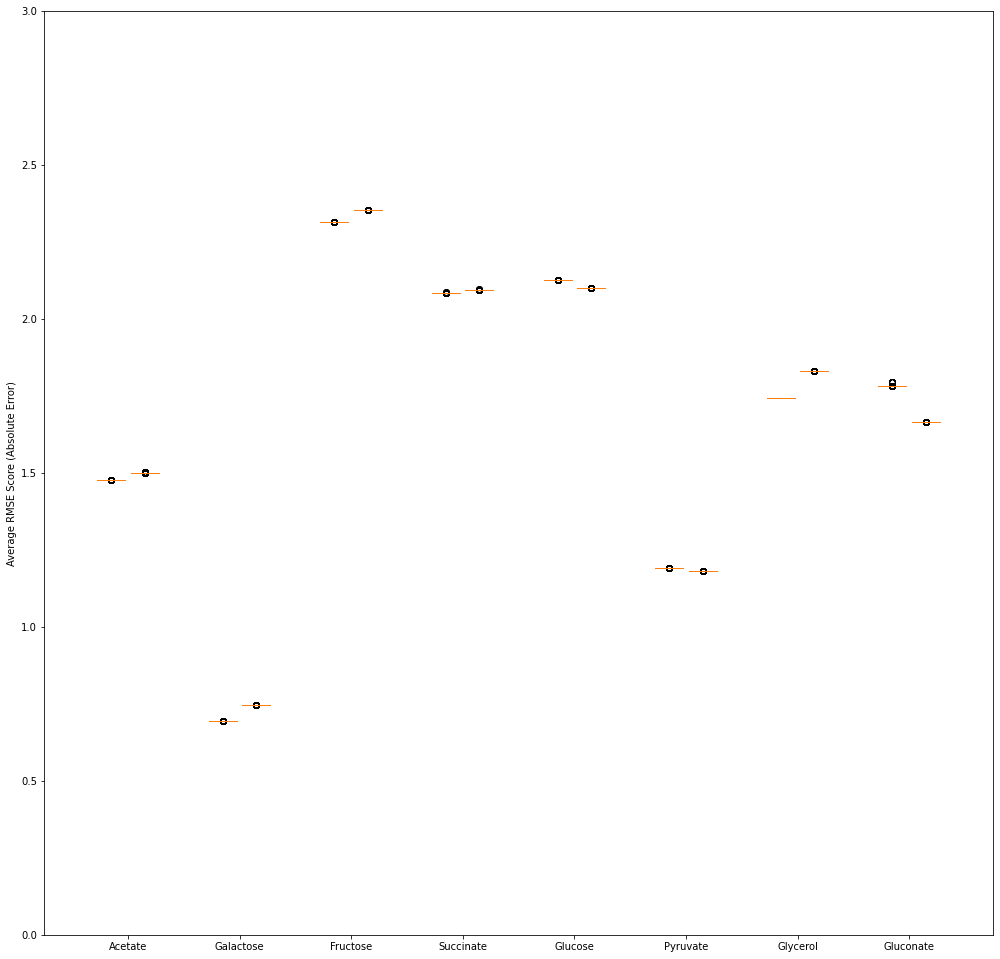

In [65]:
fig = plt.figure()
ax = plt.axes()

#Acetate
Acetate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Acetate'], "Old Model": OldRMSEDict['Acetate']})
bp = plt.boxplot(Acetate, positions = [1.2, 1.8], widths = 0.5)

#Galactose
Galactose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Galactose'], "Old Model": OldRMSEDict['Galactose']})
bp = plt.boxplot(Galactose, positions = [3.2, 3.8], widths = 0.5)

#Fructose
Fructose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Fructose'], "Old Model": OldRMSEDict['Fructose']})
bp = plt.boxplot(Fructose, positions = [5.2, 5.8], widths = 0.5)

#Succinate
Succinate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Succinate'], "Old Model": OldRMSEDict['Succinate']})
bp = plt.boxplot(Succinate, positions = [7.2, 7.8], widths = 0.5)

#Glucose
Glucose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glucose'], "Old Model": OldRMSEDict['Glucose']})
bp = plt.boxplot(Glucose, positions = [9.2, 9.8], widths = 0.5)

#Pyruvate
Pyruvate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Pyruvate'], "Old Model": OldRMSEDict['Pyruvate']})
bp = plt.boxplot(Pyruvate, positions = [11.2, 11.8], widths = 0.5)

#Glycerol
Glycerol = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glycerol'], "Old Model": OldRMSEDict['Glycerol']})
bp = plt.boxplot(Glycerol, positions = [13.2, 13.8], widths = 0.5)

#Gluconate
Gluconate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Gluconate'], "Old Model": OldRMSEDict['Gluconate']})
bp = plt.boxplot(Gluconate, positions = [15.2, 15.8], widths = 0.5)

plt.xlim(0,17)
ax.set_xticks([1.5, 3.5, 5.5, 7.5, 9.5, 11.5, 13.5, 15.5])
ax.set_xticklabels(['Acetate', 'Galactose', 'Fructose', 'Succinate', 'Glucose', 'Pyruvate', 'Glycerol', 'Gluconate'])

plt.ylabel('Average RMSE Score (Absolute Error)')
plt.ylim(0,3)

plt.rcParams["figure.figsize"] = [17, 17]
plt.rcParams["figure.autolayout"] = False


plt.show()

In [33]:
from scipy import stats

In [32]:
print('Acetate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Acetate'], OldRMSEDict['Acetate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Galactose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Galactose'], OldRMSEDict['Galactose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Fructose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Fructose'], OldRMSEDict['Fructose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Succinate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Succinate'], OldRMSEDict['Succinate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glucose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Glucose'], OldRMSEDict['Glucose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Pyruvate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Pyruvate'], OldRMSEDict['Pyruvate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glycerol t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Glycerol'], OldRMSEDict['Glycerol'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Gluconate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRMSEDict['Gluconate'], OldRMSEDict['Gluconate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))

Acetate t-test comparison between the two populations:


NameError: name 'stats' is not defined

In [201]:
import matplotlib.pyplot as plt
import pandas as pd

In [203]:
NAcetDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelAcetateResults.csv')
OAcetDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelAcetateResults.csv')

NFructDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelFructoseResults.csv')
OFructDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelFructoseResults.csv')

NGalacDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGalactoseResults.csv')
OGalacDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGalactoseResults.csv')

NGlcnDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGluconateResults.csv')
OGlcnDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGluconateResults.csv')

NGlucDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGlucoseResults.csv')
OGlucDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGlucoseResults.csv')

NGlycDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelGlycerolResults.csv')
OGlycDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelGlycerolResults.csv')

NPyruDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelPyruvateResults.csv')
OPyruDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelPyruvateResults.csv')

NSuccDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\NewModelSuccinateResults.csv')
OSuccDF = pd.read_csv(r'C:\Users\Helge\MasterProject\Part2\Sampling\output\OldModelSuccinateResults.csv')

In [204]:
NewRelRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {},
              'Gluconate': {}}
OldRelRMSEDict = {'Acetate': {},
              'Glucose': {},
              'Succinate': {},
              'Fructose': {},
              'Galactose': {},
              'Pyruvate': {},
              'Glycerol': {},
              'Gluconate': {}}

In [205]:
CorrectValuesDF = {
    'FluxNames': ['EX_ac_e', 'EX_fru_e', 'EX_gal_e', 'EX_glc__D_e', 'EX_glyc_e', 'EX_glcn_e', 'EX_pyr_e', 'EX_succ_e', 'EX_fum_e', 
                  'EX_lac__D_e', 'PGI', 'PFK', 'FBA', 'TPI', 'GAPD', 'PGK', 'PGM', 'ENO', 'PYK', 'PDH', 'EDD', 'EDA',
                 'G6PDH2r', 'PGL', 'GND', 'RPI', 'RPE', 'TKT1', 'TALA', 'TKT2', 'PPC', 'PPCK', 'CS', 'ACONTa', 'ACONTb', 'ICDHyr',
                 'AKGDH', 'SUCOAS', 'SUCDi', 'FUM', 'ME1+ME2', 'ICL', 'MALS', 'GrowthRate'],
    'Acetate': [-13.584, 0, 0, 0, 0, 0, 0, 0, 0, 0, -3.4233, -1.8862, -1.8862, -1.8862, -2.2639, -2.2639, -2.7366, -2.7366, -1.6532, 
                0.0655, 0.8216, 0.8216, 3.4083, 3.4083, 2.5867, 1.0293, 1.5574, 0.8391, 0.8391, 0.7182, 1.7741, 3.1143,
               8.8340, 8.8340, 8.8340, 4.6964, 4.2672, 4.2672, 8.4048, 8.4048, 1.8710, 4.1376, 4.1376,
               0.29],
    'Fructose': [3.3287, -8.328, 0, 0, 0, 0, 0, 0, 0, 0, -6.1979, -2.461, 5.867, 5.867, 13.4646, 13.4646, 12.5985, 12.5985, 0.6690, 
                9.0688, 0, 0, 6.1713, 6.1713, 6.1713, 2.3985, 3.7727, 1.9838, 1.9838, 1.7889, 3.5457, 0.3589,
               4.5683, 4.5683, 4.5683, 4.5661, 3.8749, 3.8749, 3.8771, 3.8771, 1.6516, 0.0022, 0.0022,
               0.4924],
    'Galactose': [0, 0, -1.969, 0, 0, 0, 0, 0, 0, 0, 1.3685, 1.5475, 1.5475, 1.5475, 3.3085, 3.3085, 3.0415, 3.0415, 3.3573, 
                2.9427, 0.173, 0.173, 0.5917, 0.5917, 0.4187, 0.2279, 0.1908, 0.1322, 0.1322, 0.0586, 0.3774, 0.8489,
               1.5210, 1.5210, 1.5210, 0.4962, 0.2361, 0.2361, 1.2609, 1.2609, 0.0005, 1.0248, 1.0248,
               0.1800],
    'Glucose': [6.8270, 0, 0, -9.6540, 0, 0, 0, 0, 0, 0, 5.7000, 7.0585, 7.0585, 7.0585, 15.7104, 15.7104, 14.5577, 14.5577, 2.4873, 
                11.2985, 1.087, 1.087, 3.9193, 3.9193, 2.8323, 1.4274, 1.4048, 0.8202, 0.8202, 0.5846, 2.4533, 0.5409,
               2.978, 2.978, 2.978, 2.978, 2.1381, 2.1381, 2.1381, 2.1381, 0, 0, 0,
               0.65],
    'Glycerol': [0.597, 0, 0, 0, -4.9448, 0, 0, 0, 0, 0, -3.4494, -1.5, -1.4957, 8.6403, 8.0129, 8.0129, 7.2588, 7.2588, 5.5073, 
                4.0977, 0.0146, 0.0146, 3.4261, 3.4261, 3.4115, 1.4264, 1.9851, 1.0807, 1.0807, 0.9044, 1.3765, 0,
               2.4648, 2.4648, 2.4648, 2.4648, 1.8405, 1.8405, 1.8405, 1.8405, 0, 0, 0,
               0.49],
    'Gluconate': [5.0040, 0, 0, 0, 0, -7.2839, 0, 0, 0, 0, -0.0313, 0.4869, 0.4869, 0.4869, 6.8946, 6.8946, 5.8734, 5.8734, 3.4646, 
                7.5055, 5.819, 5.819, 0, 0, 1.465, 0.9052, 0.5598, 0.3888, 0.3888, 0.1710, 1.9434, 0,
               1.154, 1.154, 1.154, 1.154, 0.1824, 0.1824, 0.1824, 0.1824, 0, 0, 0,
               0.59],
    'Pyruvate': [11.9139, 0, 0, 0, 0, 0, -26.714, 0, 0, -1.1570, -0.8982, -0.587, -0.587, -0.587, -1.1293, -1.1293, -1.7891, -1.7891, -3.4504, 
                21.0174, 0, 0, 0.8768, 0.8768, 0.8768, 0.5389, 0.3379, 0.2477, 0.2477, 0.0901, 2.4894, 1.1648,
               8.0819, 8.0819, 8.0819, 7.9793, 7.4157, 7.4157, 7.5183, 7.5183, 0.1931, 0.1026, 0.1026,
               0.39],
    'Succinate': [3.3210, 0, 0, 0, 0, 0, 0, -15.9020, -1.14, 0, -5.5903, -2.6916, -2.6916, -2.6919, -3.4151, -3.4151, -4.2739, -4.2739, -3.73, 
                7.7521, 0.6555, 0.6555, 5.5633, 5.5633, 4.9078, 1.9741, 2.9338, 1.5639, 1.5639, 1.3698, 2.0161, 2.9718,
               3.1554, 3.1554, 3.1554, 3.0389, 2.3520, 2.352, 18.3704, 17.2304, 12.3962, 0.1165, 0.1165,
               0.51]
}

In [85]:
import os
os.getcwd()

'C:\\Users\\Helge\\MasterProject\\Part2'

In [97]:
CValDF = pd.read_excel(r'C:\Users\Helge\MasterProject\Part2\mmc2.xlsx', sheet_name='Metabolic fluxes')

In [110]:
CValDF.iloc[:, 0]

0              Flux
1            Ace_Ex
2            Fru_Ex
3            Gal_Ex
4            Glc_Ex
5            Gly_Ex
6            Gln_Ex
7            Pyr_Ex
8            Suc_Ex
9            Fum_Ex
10           Lac_Ex
11              PGI
12          PFK-FBP
13              FBA
14              TPI
15       Middle_EMP
16          Low_EMP
17          PYK-PPS
18              PDH
19               ED
20    PPP_ED_branch
21        Early_PPP
22              RPI
23              RPE
24       Non-ox_PPP
25             TKT2
26              PPC
27             PPCK
28        Early_TCA
29             ICDH
30          Int_TCA
31           SUCDH3
32              FUM
33          MDH+MQO
34               ME
35        Glx_Cycle
36      Growth_rate
Name: Unnamed: 0, dtype: object

In [305]:
CorrectValuesDeviationDF = {
    'FluxNames': ['EX_ac_e', 'EX_fru_e', 'EX_gal_e', 'EX_glc__D_e', 'EX_glyc_e', 'EX_glcn_e', 'EX_pyr_e', 'EX_succ_e', 'EX_fum_e', 
                  'EX_lac__D_e', 'PGI', 'PFK', 'FBA', 'TPI', 'GAPD', 'PGK', 'PGM', 'ENO', 'PYK', 'PDH', 'EDD', 'EDA',
                 'G6PDH2r', 'PGL', 'GND', 'RPI', 'RPE', 'TKT1', 'TALA', 'TKT2', 'PPC', 'PPCK', 'CS', 'ACONTa', 'ACONTb', 'ICDHyr',
                 'AKGDH', 'SUCOAS', 'SUCDi', 'FUM', 'ME1+ME2', 'ICL', 'MALS', 'GrowthRate'],
    'Acetate': [0.3255, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.5667, 0.3006, 0.1181, 0.3006, 0.3006, 0.3006, 0.3006, 0.3006, 1.3110, 
                0.1664, 0.2047, 0.2047, 0.4926, 0.4926, 0.4480, 0.1493, 0.1493, 0.1493, 0.1493, 0.1493, 0.3539, 1.2093,
               0.1493, 0.1493, 0.1493, 0.3367, 0.3367, 0.3367, 0.1493, 0.1493, 1.1855, 0.2196, 0.2196,
               0.0130],
    'Fructose': [0.0588, 0.2788, 0, 0, 0, 0, 0, 0, 0, 0, 0.3726, 0.1242, 0.0459, 0.1242, 0.1242, 0.1242, 0.1242, 0.1242, 0.4693, 
                0.1215, 0, 0, 0.3726, 0.3726, 0.3726, 0.1242, 0.1242, 0.1242, 0.1242, 0.1242, 0.1158, 0.4586,
               0.1242, 0.1242, 0.1242, 0.1282, 0.1282, 0.1242, 0.1242, 0.1242, 0.4625, 0.0135, 0.0135,
               0.0100],
    'Galactose': [0, 0, 0.0132, 0, 0, 0, 0, 0, 0, 0, 0.040, 0.0140, 0.0064, 0.0140, 0.0140, 0.0140, 0.0140, 0.0140, 0.0140, 
                0.033, 0.0155, 0.0155, 0.0498, 0.0498, 0.0473, 0.0158, 0.0158, 0.0158, 0.0158, 0.0158, 0.0206, 0.0334,
               0.0158, 0.0158, 0.0158, 0.0354, 0.0354, 0.0354, 0.0158, 0.0158, 0.0033, 0.0305, 0.0305,
               0.01],
    'Glucose': [1.0289, 0, 0, 0.0380, 0, 0, 0, 0, 0, 0, 0.3110, 0.1417, 0.525, 0.1417, 0.1417, 0.1417, 0.1417, 0.1417, 0.1417, 
                0.0906, 0.0799, 0.0799, 0.2833, 0.2833, 0.2718, 0.0906, 0.0906, 0.0906, 0.0906, 0.0906, 0.1208, 0.1208,
               0.0906, 0.0906, 0.0906, 0.0906, 0.0906, 0.0906, 0.0906, 0.0906, 0, 0, 0,
               0.01],
    'Glycerol': [0.2002, 0, 0, 0, 0.1459, 0, 0, 0, 0, 0, 0.1624, 0.0831, 0.0405, 0.0831, 0.0831, 0.0831, 0.0831, 0.0831, 0.0831, 
                0.0516, 0, 0, 0.0717, 0.0717, 0.1547, 0.0516, 0.0516, 0.0516, 0.0516, 0.0516, 0, 0,
               0.0516, 0.0516, 0.0516, 0.0516, 0.0516, 0.0516, 0.0516, 0.0516, 0, 0, 0,
               0.008],
    'Gluconate': [0.1576, 0, 0, 0, 0, 0.0336, 0, 0, 0, 0, 0, 0.0328, 0.0158, 0.0328, 0.0328, 0.0328, 0.0328, 0.0328, 0.0328, 
                0.0164, 0.0492, 0.0492, 0.0696, 0.0696, 0.0492, 0.0164, 0.0164, 0.0164, 0.0164, 0.0164, 0, 0,
               0.0164, 0.0164, 0.0164, 0.0164, 0.0164, 0.0164, 0.0164, 0.0164, 0, 0, 0,
               0.0250],
    'Pyruvate': [0.5305, 0, 0, 0, 0, 0, 0.7982, 0, 0, -0.0690, 0.0667, 0.0222, 0.0086, 0.0222, 0.0222, 0.0222, 0.0222, 0.0222, 0.2471, 
                0.1101, 0, 0, 0.0667, 0.0667, 0.0667, 0.0222, 0.0222, 0.0222, 0.0222, 0.0222, 0.1279, 0.2741,
               0.0222, 0.0222, 0.0222, 0.1015, 0.1015, 0.1015, 0.0222, 0.2471, 0.2496, 0.1035, 0.1035,
               0.01],
    'Succinate': [0.3087, 0, 0, 0, 0, 0, 0, 0.3057, 0.0690, 0, 0.5445, 0.2996, 0.1142, 0.2996, 0.2996, 0.2996, 0.2996, 0.2996, 3.5183, 
                0.0405, 0.2444, 0.2444, 0.5290, 0.5290, 0.4692, 0.1564, 0.1564, 0.1564, 0.1564, 0.1564, 0.0527, 3.4868,
               0.1564, 0.1564, 0.1564, 0.3014, 0.3014, 0.3014, 0.1564, 0.1564, 3.4725, 0.1475, 0.1475,
               0.01]
}

In [306]:
CutVal = 0.5

In [392]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NAcetDF['Unnamed: 0']:
    ForStuff = []
    buh = NAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Acetate'][count]
        z2 = abs(CorrectValuesDF['Acetate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Acetate'][count])/CorrectValuesDF['Acetate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Acetate'][count])/CorrectValuesDF['Acetate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Acetate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'PDH', 'ME1+ME2', 'PYK'}


In [393]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OAcetDF['Unnamed: 0']:
    ForStuff = []
    buh = OAcetDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Acetate'][count]
        z2 = abs(CorrectValuesDF['Acetate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Acetate'][count])/CorrectValuesDF['Acetate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Acetate'][count])/CorrectValuesDF['Acetate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Acetate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'PDH', 'ME1+ME2', 'PYK'}


In [394]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NFructDF['Unnamed: 0']:
    ForStuff = []
    buh = NFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Fructose'][count]
        z2 = abs(CorrectValuesDF['Fructose'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Fructose'][count])/CorrectValuesDF['Fructose'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Fructose'][count])/CorrectValuesDF['Fructose'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Fructose'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'MALS', 'PPCK', 'ICL', 'PYK'}


In [395]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OFructDF['Unnamed: 0']:
    ForStuff = []
    buh = OFructDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Fructose'][count]
        z2 = abs(CorrectValuesDF['Fructose'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Fructose'][count])/CorrectValuesDF['Fructose'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Fructose'][count])/CorrectValuesDF['Fructose'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Fructose'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'MALS', 'PPCK', 'ICL', 'PYK'}


In [396]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NGalacDF['Unnamed: 0']:
    ForStuff = []
    buh = NGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Galactose'][count]
        z2 = abs(CorrectValuesDF['Galactose'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Galactose'][count])/CorrectValuesDF['Galactose'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Galactose'][count])/CorrectValuesDF['Galactose'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Galactose'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'ME1+ME2'}


In [397]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OGalacDF['Unnamed: 0']:
    ForStuff = []
    buh = OGalacDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Galactose'][count]
        z2 = abs(CorrectValuesDF['Galactose'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Galactose'][count])/CorrectValuesDF['Galactose'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Galactose'][count])/CorrectValuesDF['Galactose'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Galactose'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'ME1+ME2'}


In [398]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NGlucDF['Unnamed: 0']:
    ForStuff = []
    buh = NGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Glucose'][count]
        z2 = abs(CorrectValuesDF['Glucose'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Glucose'][count])/CorrectValuesDF['Glucose'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Glucose'][count])/CorrectValuesDF['Glucose'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Glucose'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
set()


In [399]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OGlucDF['Unnamed: 0']:
    ForStuff = []
    buh = OGlucDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Glucose'][count]
        z2 = abs(CorrectValuesDF['Glucose'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Glucose'][count])/CorrectValuesDF['Glucose'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Glucose'][count])/CorrectValuesDF['Glucose'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Glucose'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
set()


In [400]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NGlycDF['Unnamed: 0']:
    ForStuff = []
    buh = NGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Glycerol'][count]
        z2 = abs(CorrectValuesDF['Glycerol'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Glycerol'][count])/CorrectValuesDF['Glycerol'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Glycerol'][count])/CorrectValuesDF['Glycerol'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Glycerol'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
set()


In [401]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OGlycDF['Unnamed: 0']:
    ForStuff = []
    buh = OGlycDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Glycerol'][count]
        z2 = abs(CorrectValuesDF['Glycerol'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Glycerol'][count])/CorrectValuesDF['Glycerol'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Glycerol'][count])/CorrectValuesDF['Glycerol'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Glycerol'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
set()


In [402]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NGlcnDF['Unnamed: 0']:
    ForStuff = []
    buh = NGlcnDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Gluconate'][count]
        z2 = abs(CorrectValuesDF['Gluconate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Gluconate'][count])/CorrectValuesDF['Gluconate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Gluconate'][count])/CorrectValuesDF['Gluconate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Gluconate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
set()


In [403]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OGlcnDF['Unnamed: 0']:
    ForStuff = []
    buh = OGlcnDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Gluconate'][count]
        z2 = abs(CorrectValuesDF['Gluconate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Gluconate'][count])/CorrectValuesDF['Gluconate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Gluconate'][count])/CorrectValuesDF['Gluconate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Gluconate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
set()


In [404]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in NPyruDF['Unnamed: 0']:
    ForStuff = []
    buh = NPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Pyruvate'][count]
        z2 = abs(CorrectValuesDF['Pyruvate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Pyruvate'][count])/CorrectValuesDF['Pyruvate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Pyruvate'][count])/CorrectValuesDF['Pyruvate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Pyruvate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'MALS', 'ME1+ME2', 'ICL'}


In [405]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OPyruDF['Unnamed: 0']:
    ForStuff = []
    buh = OPyruDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Pyruvate'][count]
        z2 = abs(CorrectValuesDF['Pyruvate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Pyruvate'][count])/CorrectValuesDF['Pyruvate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Pyruvate'][count])/CorrectValuesDF['Pyruvate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Pyruvate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'MALS', 'ME1+ME2', 'ICL'}


In [406]:
ForOtherStuff = []
CutSet = set([])
Val = 0
TestVal = 0
for x in NSuccDF['Unnamed: 0']:
    ForStuff = []
    buh = NSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'NewBiomassReaction'
            
        z = CorrectValuesDeviationDF['Succinate'][count]
        z2 = abs(CorrectValuesDF['Succinate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            TestVal = abs((Val-CorrectValuesDF['Succinate'][count])/CorrectValuesDF['Succinate'][count])
#            print(str(y) + ' and ' + str(TestVal))
            ForStuff.append(TestVal)
            continue
        if z2 > 0.1:
            TestVal = abs((buh[y]-CorrectValuesDF['Succinate'][count])/CorrectValuesDF['Succinate'][count])
#            print(str(y) + ' and ' + str(TestVal))
            ForStuff.append(TestVal)

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
NewRelRMSEDict['Succinate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'MALS', 'PPCK', 'ICL', 'PYK'}


In [407]:
ForOtherStuff = []
CutSet = set([])
Val = 0
for x in OSuccDF['Unnamed: 0']:
    ForStuff = []
    buh = OSuccDF.iloc[x]
    for count, y in enumerate(CorrectValuesDF['FluxNames']):
        if y == 'SUCOAS':
            continue
        if y == 'GrowthRate':
            y = 'BIOMASS_Ec_iML1515_core_75p37M'
            
        z = CorrectValuesDeviationDF['Succinate'][count]
        z2 = abs(CorrectValuesDF['Succinate'][count])
        if z2 == 0:
            continue
        if (z/z2 > CutVal):
            CutSet.add(y)
            continue
        if y == 'ME1+ME2':
            Val = buh['ME1'] + buh['ME2']
            ForStuff.append(abs((Val-CorrectValuesDF['Succinate'][count])/CorrectValuesDF['Succinate'][count]))
            continue
        if z2 > 0.1:
            ForStuff.append(abs((buh[y]-CorrectValuesDF['Succinate'][count])/CorrectValuesDF['Succinate'][count]))

    count = 0        
    for i in ForStuff:
        count += i
    avg = count/len(ForStuff)
    ForOtherStuff.append(avg)
            
OldRelRMSEDict['Succinate'] = ForOtherStuff
print('Removed cuz too high deviation')
print(CutSet)

Removed cuz too high deviation
{'MALS', 'PPCK', 'ICL', 'PYK'}


In [408]:
plt.rcParams['figure.figsize'] = (10, 10)

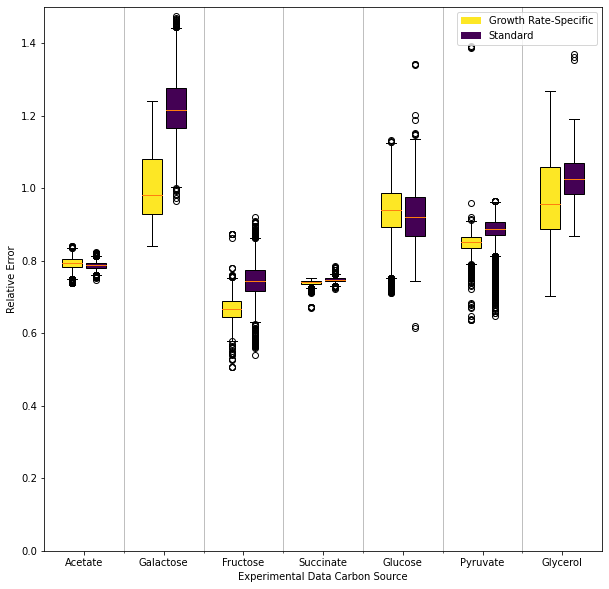

In [440]:
fig = plt.figure()
ax = plt.axes()
colormap = ('#fde725', '#440154')


#Acetate
Acetate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Acetate'], "Old Model": OldRelRMSEDict['Acetate']})
bp = plt.boxplot(Acetate, positions = [0.7, 1.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Galactose
Galactose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Galactose'], "Old Model": OldRelRMSEDict['Galactose']})
bp = plt.boxplot(Galactose, positions = [2.7, 3.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Fructose
Fructose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Fructose'], "Old Model": OldRelRMSEDict['Fructose']})
bp = plt.boxplot(Fructose, positions = [4.7, 5.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Succinate
Succinate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Succinate'], "Old Model": OldRelRMSEDict['Succinate']})
bp = plt.boxplot(Succinate, positions = [6.7, 7.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Glucose
Glucose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Glucose'], "Old Model": OldRelRMSEDict['Glucose']})
bp = plt.boxplot(Glucose, positions = [8.7, 9.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Pyruvate
Pyruvate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Pyruvate'], "Old Model": OldRelRMSEDict['Pyruvate']})
bp = plt.boxplot(Pyruvate, positions = [10.7, 11.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Glycerol
Glycerol = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Glycerol'], "Old Model": OldRelRMSEDict['Glycerol']})
bp = plt.boxplot(Glycerol, positions = [12.7, 13.3], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')



plt.xlim(0,14)
plt.ylim(0,1.5)
ax.set_xticks([1, 3, 5, 7, 9, 11, 13])
ax.set_xticks([2, 4, 6, 8, 10, 12], minor=True)

ax.set_xticklabels(['Acetate', 'Galactose', 'Fructose', 'Succinate', 'Glucose', 'Pyruvate', 'Glycerol'])


plt.rcParams["figure.figsize"] = [10, 10]
plt.rcParams["figure.autolayout"] = False

from matplotlib.patches import Patch
custom_lines = [Patch(facecolor = '#fde725'),
               Patch(facecolor = '#440154')]
ax.legend(custom_lines, ['Growth Rate-Specific', 'Standard'])

plt.xlabel('Experimental Data Carbon Source')
plt.ylabel('Relative Error')
plt.grid(visible=True, axis='x', which='minor', alpha=1.0)
plt.show()
fig.savefig('RelativeBoxPlot.pdf')

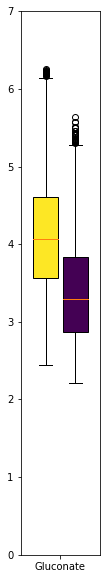

In [443]:
fig = plt.figure()
ax = plt.axes()
colormap = ('#fde725', '#440154')

#Gluconate
Gluconate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRelRMSEDict['Gluconate'], "Old Model": OldRelRMSEDict['Gluconate']})
bp = plt.boxplot(Gluconate, positions = [0.2, 0.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')


plt.ylim(0,7.0)
from matplotlib.patches import Patch
custom_lines = [Patch(facecolor = '#fde725'),
               Patch(facecolor = '#440154')]
#ax.legend(custom_lines, ['Growth Rate-Specific', 'Standard'])
ax.set_xticks([0.5])
ax.set_xticklabels(['Gluconate'])
plt.rcParams["figure.figsize"] = [1.43, 10]
#plt.xlabel('Experimental Data Carbon Source')
#plt.ylabel('Relative Error')
plt.show()
fig.savefig('RelativeBoxPlotGluconate.pdf')

In [419]:
plt.rcParams["figure.autolayout"] = True

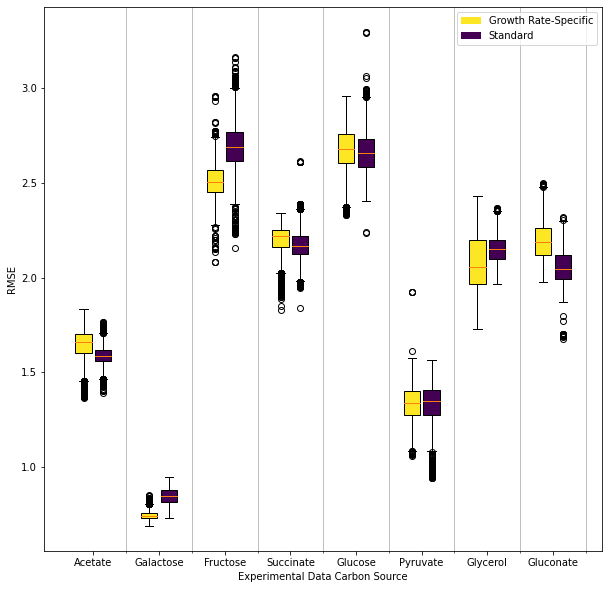

In [372]:
fig = plt.figure()
ax = plt.axes()
colormap = ('#fde725', '#440154')


#Acetate
Acetate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Acetate'], "Old Model": OldRMSEDict['Acetate']})
bp = plt.boxplot(Acetate, positions = [1.2, 1.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Galactose
Galactose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Galactose'], "Old Model": OldRMSEDict['Galactose']})
bp = plt.boxplot(Galactose, positions = [3.2, 3.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Fructose
Fructose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Fructose'], "Old Model": OldRMSEDict['Fructose']})
bp = plt.boxplot(Fructose, positions = [5.2, 5.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Succinate
Succinate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Succinate'], "Old Model": OldRMSEDict['Succinate']})
bp = plt.boxplot(Succinate, positions = [7.2, 7.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Glucose
Glucose = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glucose'], "Old Model": OldRMSEDict['Glucose']})
bp = plt.boxplot(Glucose, positions = [9.2, 9.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Pyruvate
Pyruvate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Pyruvate'], "Old Model": OldRMSEDict['Pyruvate']})
bp = plt.boxplot(Pyruvate, positions = [11.2, 11.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Glycerol
Glycerol = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Glycerol'], "Old Model": OldRMSEDict['Glycerol']})
bp = plt.boxplot(Glycerol, positions = [13.2, 13.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

#Gluconate
Gluconate = pd.DataFrame({"Rebuilt Biomass Reaction": NewRMSEDict['Gluconate'], "Old Model": OldRMSEDict['Gluconate']})
bp = plt.boxplot(Gluconate, positions = [15.2, 15.8], widths = 0.5, patch_artist = True)
plt.setp(bp['boxes'][0], facecolor = '#fde725')
plt.setp(bp['boxes'][1], facecolor = '#440154')

plt.xlim(0,17)
ax.set_xticks([1.5, 3.5, 5.5, 7.5, 9.5, 11.5, 13.5, 15.5])
ax.set_xticks([2.5, 4.5, 6.5, 8.5, 10.5, 12.5, 14.5, 16.5], minor=True)

ax.set_xticklabels(['Acetate', 'Galactose', 'Fructose', 'Succinate', 'Glucose', 'Pyruvate', 'Glycerol', 'Gluconate'])


plt.rcParams["figure.figsize"] = [10, 10]
plt.rcParams["figure.autolayout"] = False

from matplotlib.patches import Patch
custom_lines = [Patch(facecolor = '#fde725'),
               Patch(facecolor = '#440154')]
ax.legend(custom_lines, ['Growth Rate-Specific', 'Standard'])

plt.xlabel('Experimental Data Carbon Source')
plt.ylabel('RMSE')
plt.grid(visible=True, axis='x', which='minor', alpha=1.0)
plt.show()
fig.savefig('AbsoluteBoxPlot.pdf')

In [411]:
print('Acetate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Acetate'], OldRelRMSEDict['Acetate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Galactose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Galactose'], OldRelRMSEDict['Galactose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Fructose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Fructose'], OldRelRMSEDict['Fructose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Succinate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Succinate'], OldRelRMSEDict['Succinate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glucose t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Glucose'], OldRelRMSEDict['Glucose'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Pyruvate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Pyruvate'], OldRelRMSEDict['Pyruvate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Glycerol t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Glycerol'], OldRelRMSEDict['Glycerol'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))
print('')
print('Gluconate t-test comparison between the two populations:')
ttest=stats.ttest_ind(NewRelRMSEDict['Gluconate'], OldRelRMSEDict['Gluconate'])
print('T-value: '+str(ttest[0]))
print('p: '+str(ttest[1]))

Acetate t-test comparison between the two populations:
T-value: 31.439484469112653
p: 8.186622882103064e-212

Galactose t-test comparison between the two populations:
T-value: -174.7785770694521
p: 0.0

Fructose t-test comparison between the two populations:
T-value: -147.62942216700714
p: 0.0

Succinate t-test comparison between the two populations:
T-value: -94.35876222449974
p: 0.0

Glucose t-test comparison between the two populations:
T-value: 12.415317366846379
p: 2.91143698508028e-35

Pyruvate t-test comparison between the two populations:
T-value: -87.47750110914457
p: 0.0

Glycerol t-test comparison between the two populations:
T-value: -47.06413760401526
p: 0.0

Gluconate t-test comparison between the two populations:
T-value: 75.68168177508713
p: 0.0


In [283]:
len(CorrectValuesDF)

9

In [276]:
testing = NSuccDF.iloc[4]
testing2 = OSuccDF.iloc[4]
print((testing['NewBiomassReaction']-CorrectValuesDF['Succinate'][43])/CorrectValuesDF['Succinate'][43])

0.25492176098942193


In [275]:
print(testing['NewBiomassReaction'])
print(CorrectValuesDF['Succinate'][43])

0.6400100981046052
0.51


In [352]:
print(NewRelRMSEDict['Galactose'])

[1.1584447166695644, 1.15634180551231, 1.1556624463042815, 1.0589338822568686, 1.0626775556869943, 1.047584965189392, 1.0439037915569405, 1.194822471328384, 1.2159371333683584, 1.2110870274845744, 1.1937237389975641, 1.0624440600854168, 1.1182935033731078, 1.0815381983578494, 1.078778079364642, 1.0785393887117358, 1.104794235593995, 1.128116416446523, 1.1917675026094467, 1.1809343299692703, 1.4780722972974225, 1.4760975647644463, 1.481211807838609, 1.5149547063010733, 1.513718081818298, 1.4969307246673997, 1.5008563587752088, 1.5241123292109193, 2.50487573787418, 2.5068983804757763, 2.507784754788611, 2.5273215256389983, 2.546470552666447, 2.547204714721359, 2.585176197356717, 2.575603888393551, 2.3744613849524394, 2.2706321354848513, 2.2127126076139256, 2.5222860376719147, 2.526443728254504, 2.502163357674091, 2.4996566594655842, 2.5048149633752317, 2.4943079356620093, 2.43843622733507, 2.4677025558687022, 2.663286207483688, 2.667158970542288, 2.663139434391358, 2.652677373113784, 2.2

In [167]:
import pathlib
data_dir = pathlib.Path(".") / ".." / "part2" / "Sampling"
data_dir = data_dir.resolve()

In [162]:
print(data_dir)

C:\Users\Helge\MasterProject\Part2\models


In [196]:
OAcetModel_path = data_dir / "OldModelAcetate.xml"
OAcetModel = cobra.io.read_sbml_model(str(OAcetModel_path.resolve()))

In [198]:
def write_flux_json(filename, model):
    """ write_flux_json writes a json file from a dictionary of model reactions
    and associated flux values
    """
    flux_dict = model.optimize().fluxes.to_dict()    # reaction:flux dict
    try: 
        flux_dict['BIOMASS_Ecoli_core_w_GAM'] = flux_dict.pop('NewBiomassReaction')
    except:
        flux_dict['BIOMASS_Ecoli_core_w_GAM'] = flux_dict.pop('BIOMASS_Ec_iML1515_core_75p37M')
    with open(filename, 'w') as f:
        json.dump(flux_dict, f)

In [199]:
write_flux_json('OldModelAcEscherReactMap.json', OAcetModel)

In [191]:
wuppie = OAcetModel.optimize().fluxes.to_dict() 

In [178]:
thingymajig = NAcetModel.optimize().fluxes.to_dict()

In [183]:
thingymajig['BIOMASS_Ecoli_core_w_GAM'] = thingymajig.pop('NewBiomassReaction')
print(thingymajig)

KeyError: 'NewBiomassReaction'

In [195]:
print(wuppie.pop('BIOMASS_Ec_iML1515_core_75p37M'))

0.2964762590635567
